In [14]:
import glob
import os
from readfiles import *
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import h5py
from lomapost import * #All functions defined within module lomapost
%matplotlib inline

In [15]:
set_fig_props()

In [16]:
from IPython.display import clear_output
from IPython.display import Image

# Job selection

In [94]:
p_results   = '/share/drive/toni/VDML/'          #Define path to folder with all results
#l_folders = os.listdir(p_results) #print available jobs (folders)
p_folders   = [p_results+ 's10/01/h5.stats', p_results+ 's10/02/h5.stats', p_results+ 's10/04/h5.stats', \
               p_results+ 's20/01/h5.stats', p_results+ 's20/02/h5.stats', p_results+ 's20/03/h5.stats', \
               p_results+ 's40/01/h5.stats', p_results+ 's40/02/h5.stats', p_results+ 's40/03/h5.stats', \
               p_results+ 's80/01/h5.stats', p_results+ 's80/02/h5.stats', p_results+ 's80/03/h5.stats']

njobs = len(p_folders) 
#define option and styles for sta reading

In [5]:
lgroup = [0,0,0,1,1,1,2,2,2,3,3,3];
laverage = [1,1,1,1,1,1,1,1,1,1,1,1] # Says which to average

In [6]:
def getaverageintime(p_folders,variable,tmin,tmax,Npoints=200,derivative=False):
    """
    for a given folder path, and variable,computes a interpolated function in time(tmin:tmax)
    and average for all folders given in p_folders.
    """
    njobs = len(p_folders)
    time_int = np.linspace(tmin,tmax,Npoints)
    #faverage = np.zeros(Npoints)
    ftoaverage= np.zeros([njobs,Npoints])
    for ijob in range(njobs):
        path = p_folders[ijob]
        with h5py.File(path,"r") as f:
            time = f['time'];
            tmax2 = min(tmax,time[-1])
            fun1 = np.interp(time_int,time,f[variable],right=NaN)
            ftoaverage[ijob,:] = np.array(fun1)
            if derivative==True:
                ftoaverage[ijob,:]=der1(time_int,np.array(fun1))
    return time_int,np.mean(ftoaverage,axis=0),np.std(ftoaverage,axis=0)

In [7]:
def fcaseintime(p_folders,lcases,variable,tmin,tmax,Npoints=200,derivative=False):
    """
    using getaveragintime, returns as many vectors as cases wanted to compute.
    Distribution of cases is given in lcases(ex. lcases = [[0,1,2],[3,5]])
    """
    ncases = len(lcases)
    vtcases = [[] for i in range(ncases)]
    vfcases = [[] for i in range(ncases)]
    stddcases = [[] for i in range(ncases)]
    for icase in range(ncases):
        vpcases = []
        for ijob in lcases[icase]:
            vpcases = vpcases + [p_folders[ijob]]
        vtcases[icase],vfcases[icase],stddcases[icase] = getaverageintime(vpcases,variable,tmin,tmax,Npoints,derivative)
    return vtcases,vfcases,stddcases


In [8]:
def getvarmeanintime(path,variable,tmin,tmax,derivative=False):
    """
    for a given folder path, and variable,computes a interpolated function in time(tmin:tmax)
    and average for all folders given in p_folders.
    """
    with h5py.File(path,"r") as f:
            time = np.array(f['time']);
            if derivative==False:
                fun = np.array(f[variable])
            else: #Derivative with time
                fun = der1(time,np.array(f[variable]))
            it1 = where(time>=tmin)[0][0]
            it2 = where(time>=tmax)[0][0]
            mean = np.mean(fun[it1:it2]);
            error = np.std(fun[it1:it2]);
    return mean,error

In [9]:
def getSSprofile(path,variable,tmin,tmax,scaling = 'dm',Npoints=500,derivative=False,y0=0):
    """
    Obtain SS profile averaged in the given time
    """
    lim = 12.0;
    if scaling == 'dw':
        lim=2.0
    
    ydelta = np.linspace(-lim,lim,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        fun = np.array(f[variable]);
        if variable=='rum':
            rhom = np.array(f['rhom'])
            fun = np.divide(fun,rhom)
            #print "computed rum/rhom"
        y = np.array(f['y'])
        delta = f[scaling]
        it1 = where(time>=tmin)[0][0]
        it2 = where(time>=tmax)[0][0]
        fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
        #print it1,it2
        for itime in range(it1,it2):
            dd = delta[itime]
            if derivative == True:
                funint = np.interp(ydelta,(y-y0)/dd,dd*der1(y,fun[:,itime]))
                if itime==it1:
                    print "Taking derivative and multiplying by scaling"
            else:
                if variable=='w3m' or variable[0:2] =='ep':
                    funint = np.interp(ydelta,(y-y0)/dd,dd*fun[:,itime])
                    if itime==it1: #First time
                        print "Multiplying by scaling"
                else:
                    funint = np.interp(ydelta,(y-y0)/dd,fun[:,itime])
            fyjob[itime-it1] = funint
            
    return ydelta,np.mean(fyjob,axis=0),np.std(fyjob,axis=0)
            

In [10]:
def pcolorintime(path,variable,tmin,tmax,scaling = 'dm',Npoints=500,derivative=False,y0=0):
    """
    Plot pcolor in time
    """
    lim = 12.0;
    if scaling == 'dw':
        lim=2.0
    
    ydelta = np.linspace(-lim,lim,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        it1=where(time>=tmin)[0][0]
        it2=where(time>=tmax)[0][0]
        fun = np.array(f[variable]);
        if variable=='rum':
            rhom = np.array(f['rhom'])
            fun = np.divide(fun,rhom)
            #print "computed rum/rhom"
        y = np.array(f['y'])
        delta = np.array(f[scaling])
        fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
        for itime in range(it1,it2):
            dd = delta[itime]
            if derivative == True:
                funint = np.interp(ydelta,(y-y0)/dd,dd*der1(y,fun[:,itime]))
                if itime==it1:
                    print "Taking derivative and multiplying by scaling"
            else:
                if variable=='w3m' or variable[0:2] =='ep':
                    funint = np.interp(ydelta,(y-y0)/dd,dd*fun[:,itime])
                    if itime==it1: #First time
                        print "Multiplying by scaling"
                else:
                    funint = np.interp(ydelta,(y-y0)/dd,fun[:,itime])
            fyjob[itime-it1] = funint
            
    return ydelta,time[it1:it2],fyjob
            

In [11]:
def getvarmeanintimeV(fun,time,tmin,tmax,derivative=False):
    """
    for a given folder path, and variable,computes a interpolated function in time(tmin:tmax)
    and average for all folders given in p_folders.
    """
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if derivative==True:
        fun=der1(time,fun)
    mean = np.mean(fun[it1:it2]);
    error = np.std(fun[it1:it2]);
    return mean,error

In [12]:
def getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,Npoints=500,derivative=False):
    """
    returns as many vectors as cases wanted to compute.
    Distribution of cases is given in lcases(ex. lcases = [[0,1,2],[3,5]])
    return only one profile per case
    """
    ncases = len(lcases)
    fycases = [[] for i in range(ncases)]
    
    ycases = [[] for i in range(ncases)]
    ferrorcases = [[] for i in range(ncases)]
    for icase in range(ncases):
        vpcases = []
        nacum = 0
        fy = np.zeros(Npoints)
        yf = [[]for i in range(len(lcases[icase]))]
        fy= [[]for i in range(len(lcases[icase]))]
        ferror = [[] for i in range(len(lcases[icase]))]
        for ijob in lcases[icase]:
            vpcases = vpcases + [p_folders[ijob]]
        for path,i in zip(vpcases,range(len(vpcases))):
            ijob = lcases[icase][i]
            yf[i],fy[i],ferror[i] = getSSprofile(path,variable,SS1[ijob],SS2[ijob],scaling,Npoints,derivative)
        ycases[icase]=yf
        fycases[icase]=np.mean(fy,axis=0)
        ferrorcases[icase]=np.max(ferror,axis=0)
    return ycases,fycases,ferrorcases

In [25]:
#Some parameter definitions for plotting:
#----------------------------------------
xlen=plt.rcParams['figure.figsize'][0]
xyratio=0.6
ylen = xyratio*xlen
#PRINT or not??
#PRINT = True
PRINT =False
l_job_color = ['k','b','g','r']
l_job_style = ['k-','b-','g-','r-']
save_folder='/share/drive/toni/VDML/JFM/'
#fformat = '.png'
fformat = '.eps'

(-184.0, 184.0)

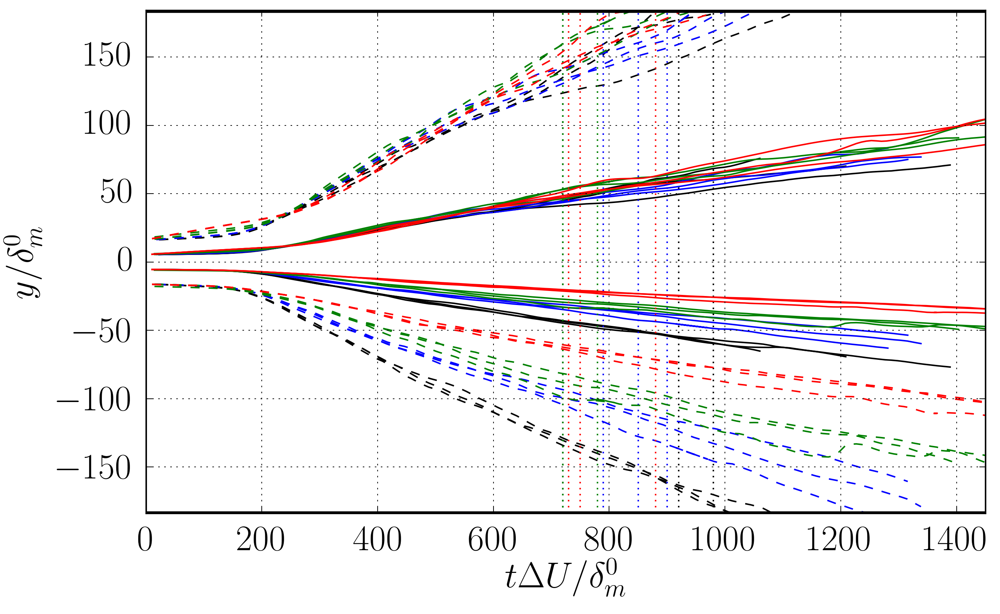

In [26]:
posumin = [[] for x in range(njobs)]
posumax = [[] for x in range(njobs)]
posu0 = [[] for x in range(njobs)]
posrho10 = [[] for x in range(njobs)]
posepmax =[[] for x in range(njobs)]
posurmsmax =[[] for x in range(njobs)]
tmax_phys=[[] for x in range(njobs)]
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
xi = np.linspace(-2,2,200) #vector x to interpolate (chi)
for path,ijob in zip(p_folders,range(len(p_folders))):
    with h5py.File(path,"r") as f:
        um = np.array(f['um'])
        w3m = np.array(f['w3m'])
        urms = np.array(f['urms'])
        rhom = np.array(f['rhom'])
        umax=np.max(um[:,0])
        umin=np.min(um[:,0])
        y = np.array(f['y'])
        time = np.array(f['time'])
        ddtmp =np.array(f['dw'])
        mag = np.max(um)
        getlim = False
        for i in range(len(time)):
            yxi = y/ddtmp[i]
            scaled = np.interp(xi,yxi,um[:,i])
            #scaled = np.interp(xi,yxi,urms[:,i])
            #scaledrho = np.interp(xi,yxi,rhom[:,i])
        #ep = stats[ijob][ista]['epR']
        #epmax = ep.max()
        #posep = (y[where(ep==epmax)]/dmtmp)
        #posurms= (y[where(urms==urms.max())]/dmtmp)
        #posdudy = (y[where(dudy==dudy.max())]/dmtmp)
            pos1 = np.interp(-0.99*mag,-scaled,xi)
            pos2 = np.interp(0.99*mag,-scaled,xi)
            if (getlim == False and 3.0*pos2*ddtmp[i]>=y[-1]):
                tmax_phys[ijob] = time[i]
                getlim=True
        #pos0 = np.interp(0.0,-scaled,xi)
        #pos10 = np.interp(-1.0,-scaledrho,xi)
        #posu0[ijob]  = r_[posu0[ijob]  , pos0]
            posumin[ijob]= r_[posumin[ijob], pos2]
            posumax[ijob]= r_[posumax[ijob], pos1]
    plt.plot(time,posumin[ijob]*ddtmp,l_job_style[ijob/3])
    plt.plot(time,posumax[ijob]*ddtmp,l_job_style[ijob/3])
    plt.plot(time,posumin[ijob]*ddtmp*3,l_job_style[ijob/3],ls='dashed')
    plt.plot(time,posumax[ijob]*ddtmp*3,l_job_style[ijob/3],ls='dashed')  
    plt.plot([SS1[ijob],SS1[ijob]],[y[0],y[-1]],l_job_style[ijob/3],ls='dotted')
    #plt.plot([SS2[ijob],SS2[ijob]],[y[0],y[-1]],l_job_style[ijob/3])
    
plt.plot([0.0,1450],[y[0],y[0]],'k-',lw=3.0)
plt.plot([0.0,1450],[y[-1],y[-1]],'k-',lw=3.0)
#plt.plot([0.0,1450],[0.33*y[-1],0.33*y[-1]],'k--')

#plt.plot([0.0,1450],[0.33*y[0],0.33*y[0]],'k--')
plt.xlabel(r'$t\Delta U/\delta_m^0$')
plt.ylabel(r'$y/\delta_m^0$')
plt.grid('on')
plt.xlim([0,1450])
plt.ylim([y[0],y[-1]])

In [27]:
print tmax_phys

[1004.2478637695312, 1132.3885498046875, 890.57037353515625, 1012.0164794921875, 1061.1949462890625, 948.04315185546875, 909.3031005859375, 846.13543701171875, 949.31243896484375, 929.931396484375, 990.8790283203125, 858.60467529296875]


STATS

In [28]:
p_root = '/share/drive/toni/VDML/'
cases = ['s10','s20','s40','s80']
p_stats = [p_root + cases[i]+'/Tstats.txt' for i in range(len(cases))]

# 1D plots (vs time)
l_time_var = ['dm','dw','dmpoint','EPS','rhoEPS','etamin','Relambda']

In [95]:
l_single = ['k','k--','k.-','b','b--','b.-','g','g--','g.-','r','r--','r.-']

# $\zeta$ vs time

In [96]:
variable = 'EPS'
lcases = [[0,1,2],[3,4,5],[6,7,8],[9,10,11]]
tmin=10; tmax=1200;
xlabel=r'$t \Delta U/\delta_m^0$'
ylabel=r'$\zeta/\Delta U^3$'
fformat = '.pdf'
figname = 'epsvstime_ave'
ncases = len(lcases)
tmaxcases=[1200,1200,1200,1200]
for icase in range(ncases):
    tmaxcases[icase] = np.floor(np.max([tmax_phys[3*icase:3*icase+3]]))
    print tmaxcases[icase]


1132.0
1061.0
949.0
990.0


last time=time1208.67041016
last time=time1388.95715332
last time=time546.93170166
last time=time1338.57946777
last time=time1315.76037598
last time=time1281.40795898
last time=time1545.47131348
last time=time1632.01721191
last time=time1403.484375
last time=time1480.66625977
last time=time1638.60644531
last time=time1457.35498047


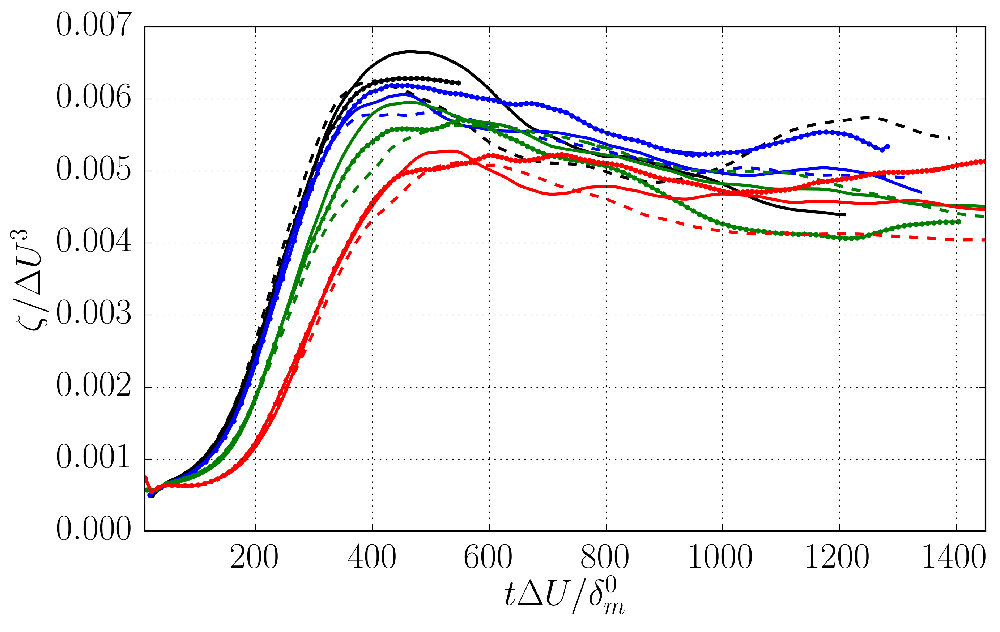

In [97]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]

for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        print "last time=time%s"%(time[-1])
        fun = np.array(f[variable] )
        #tmaxjob[ijob] = np.max(time)
        #ilim = where(time>tmaxcases[ijob/3])[0][0]
        #ilim=-1
        #print ilim
        #plt.plot(time[0:ilim] ,fun[0:ilim],l_job_style[ijob/3],lw=2.0)
        plt.plot(time ,fun,l_single[ijob],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([10,1450])
plt.grid('on')
#SAVING
#if PRINT == True:
#    print "figure saved!"
#    pathname = save_folder + 'epsvstime_ave' + fformat
#    fig.savefig(pathname,bbox_inches='tight')


In [98]:
variable = 'EPS'
xlabel=r'$t \Delta U/\delta_m^0$'
ylabel=r'$\zeta/\Delta U^3$'
fformat = '.pdf'
figname = 'dotdmvstime_ave'
ncases = len(lcases)

In [99]:
variable = 'dmpoint'
xlabel=r'$t \Delta U/\delta_m^0$'
ylabel=r'$\dot{\delta}_m/\Delta U$'
fformat = '.pdf'
figname = 'dotdmvstime_ave'
ncases = len(lcases)

last time=time1208.67041016
last time=time1388.95715332
last time=time546.93170166
last time=time1338.57946777
last time=time1315.76037598
last time=time1281.40795898
last time=time1545.47131348
last time=time1632.01721191
last time=time1403.484375
last time=time1480.66625977
last time=time1638.60644531
last time=time1457.35498047


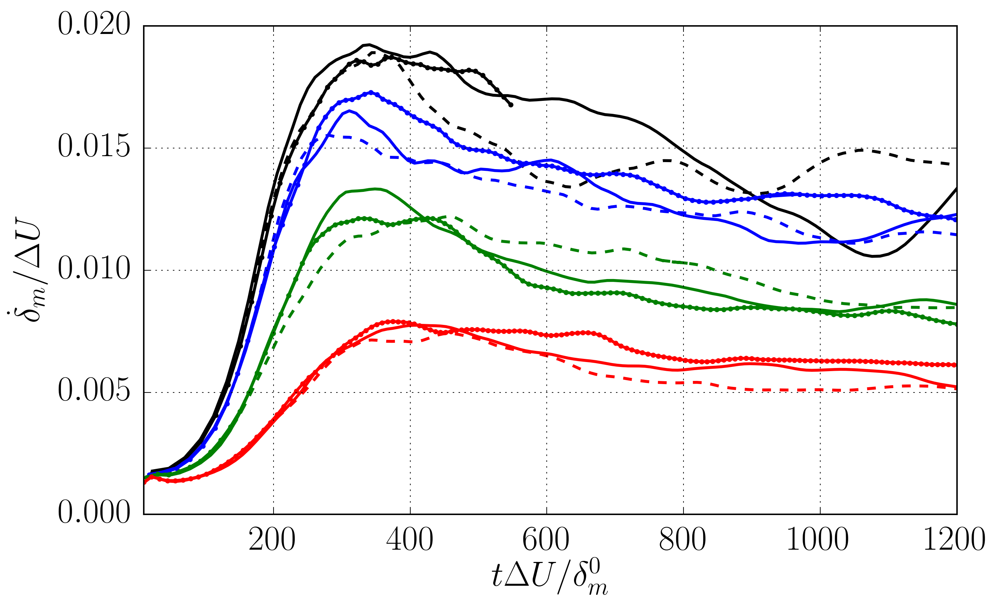

In [100]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]

for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        print "last time=time%s"%(time[-1])
        fun = np.array(f[variable] )
        #tmaxjob[ijob] = np.max(time)
        #ilim = where(time>tmaxcases[ijob/3])[0][0]
        #ilim=-1
        #print ilim
        #plt.plot(time[0:ilim] ,fun[0:ilim],l_job_style[ijob/3],lw=2.0)
        plt.plot(time ,fun,l_single[ijob],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([10,tmax])
plt.grid('on')
#SAVING
#if PRINT == True:
#    print "figure saved!"
#    pathname = save_folder + 'epsvstime_ave' + fformat
#    fig.savefig(pathname,bbox_inches='tight')


In [37]:
print SS1
print SS2


[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730]
[1004.0, array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64), array([], dtype=float64)]


In [101]:
#BASED on R22
SS1 = [ 920, 980, 720,       900, 850, 790 ,     720,  720, 780,    750,  880,  730]
SS2 = [ 720, 800, 750,       700, 750, 750,      800,  750, 750,    780,  780,  850]
SS1 = [ 920, 980, 450,       900, 850, 790 ,     720,  720, 780,    750,  880,  730]
SS2 = [ 720, 800, 540,       700, 750, 750,      800,  750, 750,    780,  780,  850]

In [39]:
for ijob in range(njobs):
    SS2[ijob] = np.floor(tmax_phys[ijob])

In [40]:
print SS1
print SS2
PRINT = True

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730]
[1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


In [102]:
variable = 'EPS'
xlabel=r'$t \Delta U/\delta_m^0$'
ylabel=r'$\zeta/\Delta U^3$'
fformat = '.pdf'
figname = 'dotdmvstime_ave'
ncases = len(lcases)

In [103]:
tmaxjobs = SS2

0
800
119 133
1
750
133 124
2
800
89 133
3
850
116 141


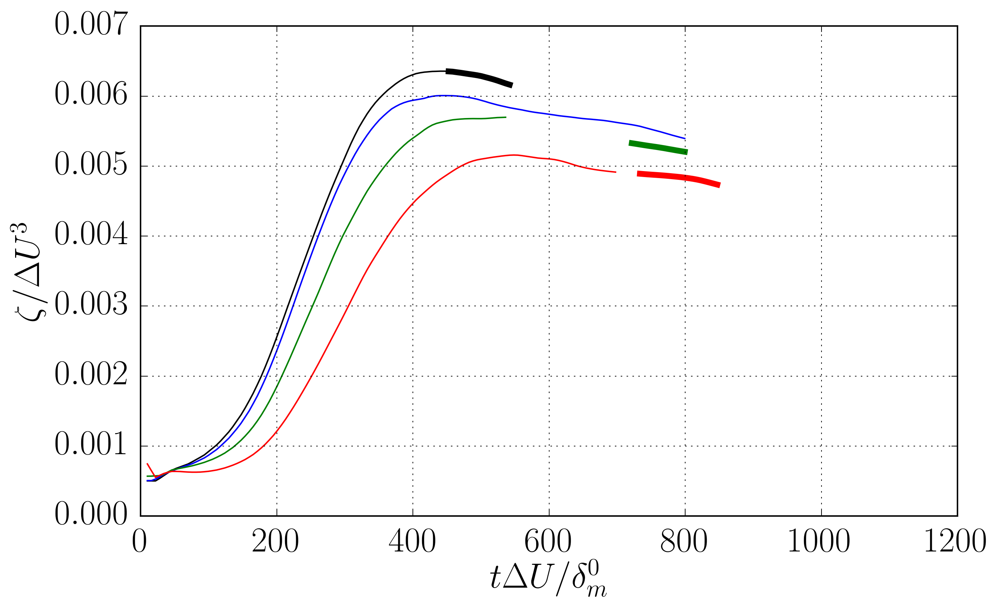

In [104]:
#Preparing plot
figname = 'epsvstime_ave'
variable2='dm'
variable='EPS'
#tmax = 1200
#tmin=30
#tmaxcases = [940,1150,1150,1100]
tmincases = [tmin,tmin,tmin]
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#ax2 = ax.twinx()
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
#vtcases_y1,vfcases_y1,stddcases_y1 = fcaseintime(p_folders_y1,lcases_y1,variable,tmin_ave,tmax_ave)
#vtcases2,vfcases2,stddcases2 = fcaseintime(p_folders,lcases,variable2,tmin,tmax)
for icase in range(ncases):
    print icase
    #print vtcases[icase]
    ilim = where(vtcases[icase]>tmaxjobs[icase])[0][0]
    minSS=np.min(SS1[3*icase:3*icase+3])
    maxSS=np.max(SS2[3*icase:3*icase+3])
    print maxSS
    ilim1 = where(vtcases[icase]>minSS)[0][0]
    ilim2 = where(vtcases[icase]>maxSS)[0][0]
    print ilim,ilim2
    #i1 = where(vtcases[icase]>tmincases[icase])[0][0]
    i1=0

    ax.plot(vtcases[icase][i1:ilim],vfcases[icase][i1:ilim],l_job_style[icase],lw=1.0)
    ax.plot(vtcases[icase][ilim1:ilim2],vfcases[icase][ilim1:ilim2],l_job_style[icase],lw=4.0) 
    #ax.plot([minSS,minSS],[0,vfcases[icase][ilim1]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.plot([maxSS,maxSS],[0,vfcases[icase][ilim2]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.fill_between(vtcases[icase][0:ilim2], 0, vfcases[icase][0:ilim2], where=vtcases[icase][0:ilim2]>minSS, facecolor=l_job_color[icase],alpha=0.6, interpolate=False)
#ax.set_xlabel(xlabel)
    #ax.plot([],[0.0,0.005])
    #ax2.plot(vtcases2[icase][0:ilim],vfcases2[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
ax.set_ylim([0,0.007])
ax.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure saved at %s"%pathname
    #Save with STD
    NS = 7
    imin = 20
    imin = 0
#   # for icase in range(ncases):
#        ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
#        plt.errorbar(vtcases[icase][imin:ilim:NS],vfcases[icase][imin:ilim:NS],yerr=stddcases[icase][imin:ilim:NS],color=l_case_color[icase])
#    pathname = save_folder + figname + 'std' + fformat
#    fig.savefig(pathname,bbox_inches='tight')

0
800
188 133
1
750
176 124
2
800
158 133
3
850
164 141


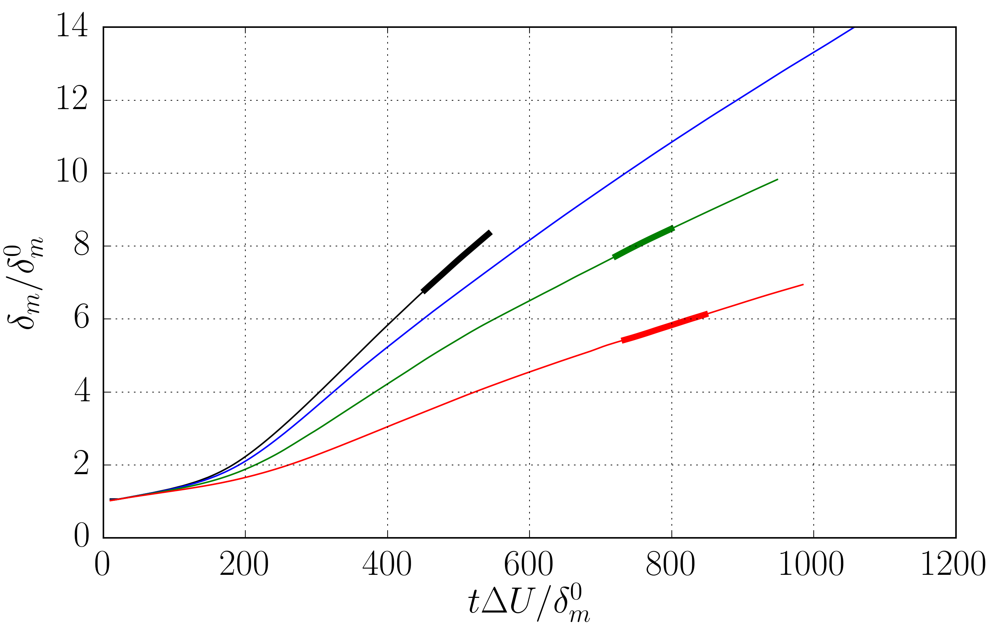

In [105]:
#Preparing plot
variable = 'dm'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\delta_m/\delta_m^0$'
figname = 'dmvstime_ave'
variable2='dm'
#tmax = 1250
#tmin=30

tmincases = [tmin,tmin,tmin]
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#ax2 = ax.twinx()
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
#vtcases_y1,vfcases_y1,stddcases_y1 = fcaseintime(p_folders_y1,lcases_y1,variable,tmin_ave,tmax_ave)
#vtcases2,vfcases2,stddcases2 = fcaseintime(p_folders,lcases,variable2,tmin,tmax)
for icase in range(ncases):
    print icase
    #print vtcases[icase]
    ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    minSS=np.min(SS1[3*icase:3*icase+3])
    maxSS=np.max(SS2[3*icase:3*icase+3])
    print maxSS
    ilim1 = where(vtcases[icase]>minSS)[0][0]
    ilim2 = where(vtcases[icase]>maxSS)[0][0]
    print ilim,ilim2
    #i1 = where(vtcases[icase]>tmincases[icase])[0][0]
    i1=0

    ax.plot(vtcases[icase][i1:ilim],vfcases[icase][i1:ilim],l_job_style[icase],lw=1.0)
    ax.plot(vtcases[icase][ilim1:ilim2],vfcases[icase][ilim1:ilim2],l_job_style[icase],lw=4.0) 
    #ax.plot([minSS,minSS],[0,vfcases[icase][ilim1]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.plot([maxSS,maxSS],[0,vfcases[icase][ilim2]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.fill_between(vtcases[icase][0:ilim2], 0, vfcases[icase][0:ilim2], where=vtcases[icase][0:ilim2]>minSS, facecolor=l_job_color[icase],alpha=0.6, interpolate=False)
#ax.set_xlabel(xlabel)
    #ax.plot([],[0.0,0.005])
    #ax2.plot(vtcases2[icase][0:ilim],vfcases2[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
#ax.set_ylim([0,0.008])
ax.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure saved at %s"%pathname
    #Save with STD
    NS = 7
    imin = 20
    #for icase in range(ncases):
    #    ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    #    plt.errorbar(vtcases[icase][imin:ilim:NS],vfcases[icase][imin:ilim:NS],yerr=stddcases[icase][imin:ilim:NS],color=l_case_color[icase])
    #pathname = save_folder + figname + 'std' + fformat
    #fig.savefig(pathname,bbox_inches='tight')

0
800
119 133
1
750
133 124
2
800
89 133
3
850
116 141


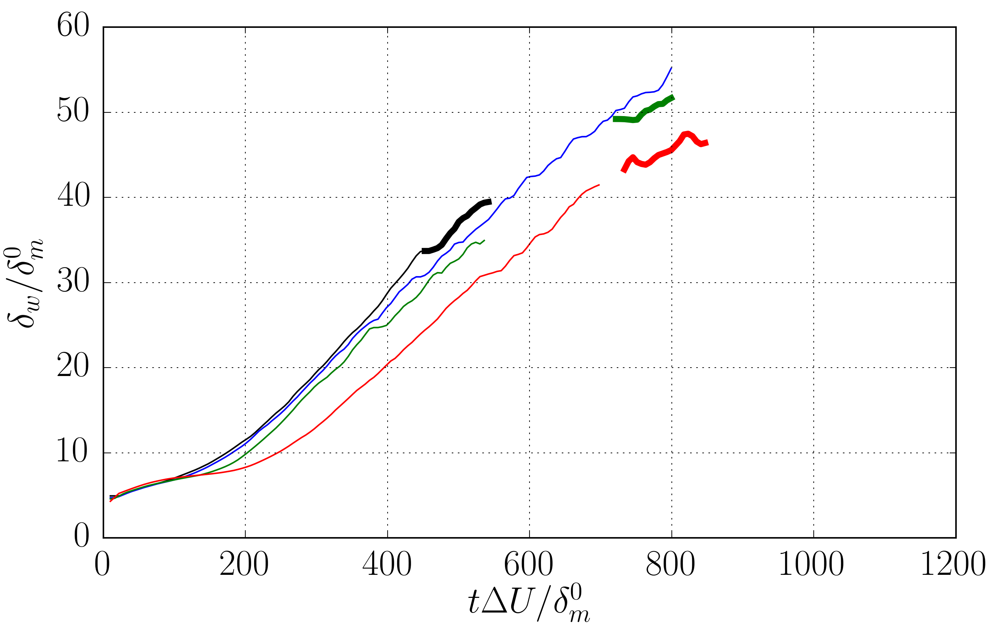

In [106]:
#Preparing plot
variable = 'dw'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\delta_w/\delta_m^0$'
figname = 'dwvstime_ave'
variable2='dw'
#tmax = 1250
#tmin=30
#tmaxcases = [tmax-20,tmax-20,tmax-20,tmax-20]
tmincases = [tmin,tmin,tmin]
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#ax2 = ax.twinx()
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
#vtcases_y1,vfcases_y1,stddcases_y1 = fcaseintime(p_folders_y1,lcases_y1,variable,tmin_ave,tmax_ave)
#vtcases2,vfcases2,stddcases2 = fcaseintime(p_folders,lcases,variable2,tmin,tmax)
for icase in range(ncases):
    print icase
    #print vtcases[icase]
    ilim = where(vtcases[icase]>tmaxjobs[icase])[0][0]
    minSS=np.min(SS1[3*icase:3*icase+3])
    maxSS=np.max(SS2[3*icase:3*icase+3])
    #minSS=SS1[icase]
    #maxSS=SS2[icase]
    print maxSS
    ilim1 = where(vtcases[icase]>minSS)[0][0]
    ilim2 = where(vtcases[icase]>maxSS)[0][0]
    print ilim,ilim2
    #i1 = where(vtcases[icase]>tmincases[icase])[0][0]
    i1=0

    ax.plot(vtcases[icase][i1:ilim],vfcases[icase][i1:ilim],l_job_style[icase],lw=1.0)
    ax.plot(vtcases[icase][ilim1:ilim2],vfcases[icase][ilim1:ilim2],l_job_style[icase],lw=4.0) 
    #ax.plot([minSS,minSS],[0,vfcases[icase][ilim1]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.plot([maxSS,maxSS],[0,vfcases[icase][ilim2]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.fill_between(vtcases[icase][0:ilim2], 0, vfcases[icase][0:ilim2], where=vtcases[icase][0:ilim2]>minSS, facecolor=l_job_color[icase],alpha=0.6, interpolate=False)
#ax.set_xlabel(xlabel)
    #ax.plot([],[0.0,0.005])
    #ax2.plot(vtcases2[icase][0:ilim],vfcases2[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
#ax.set_ylim([0,0.008])
ax.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure saved at %s"%pathname
    #Save with STD
    NS = 7
    imin = 20
    #for icase in range(ncases):
    #    ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    #    plt.errorbar(vtcases[icase][imin:ilim:NS],vfcases[icase][imin:ilim:NS],yerr=stddcases[icase][imin:ilim:NS],color=l_case_color[icase])
    #pathname = save_folder + figname + 'std' + fformat
    #fig.savefig(pathname,bbox_inches='tight')

In [90]:
s1004 = workspe('/share/drive/toni/VDML/s10/04/s10d_01_001.spe',-1)
s1003 = workspe('/share/drive/toni/VDML/s10/03/s10c_01_001.spe',-1)

ntotr=71424,nx=512,nz=192,nspec=31,nvar=12
ntotr=71424,nx=512,nz=192,nspec=31,nvar=12


In [82]:
s1004.keys()

['yjsp', 'jsp', 'time', 'y', 'kz', 'kx', 'SPEC']

In [85]:
np.shape(np.array(s1004['SPEC']))

(192, 12, 512)

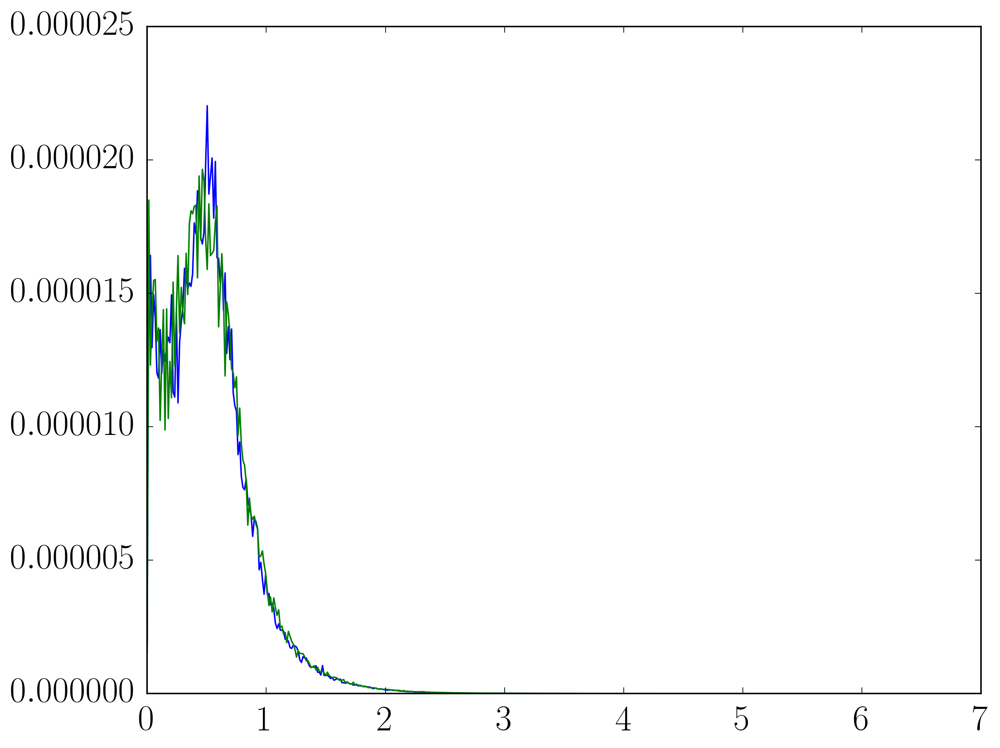

In [91]:
plt.plot(s1004['kx'],np.sum(s1004['SPEC'][1:,1,:],axis=0))
plt.plot(s1003['kx'],np.sum(s1003['SPEC'][1:,1,:],axis=0))

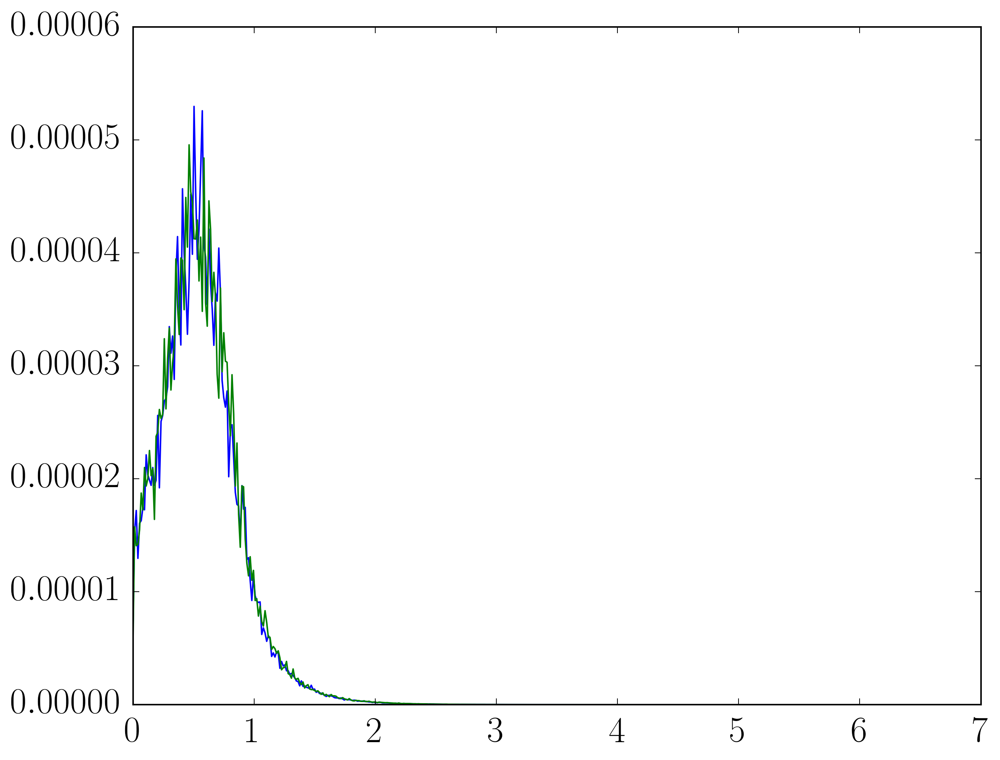

In [93]:
plt.plot(s1004['kx'],np.sum(s1004['SPEC'][1:,2,:],axis=0))
plt.plot(s1003['kx'],np.sum(s1003['SPEC'][1:,2,:],axis=0))

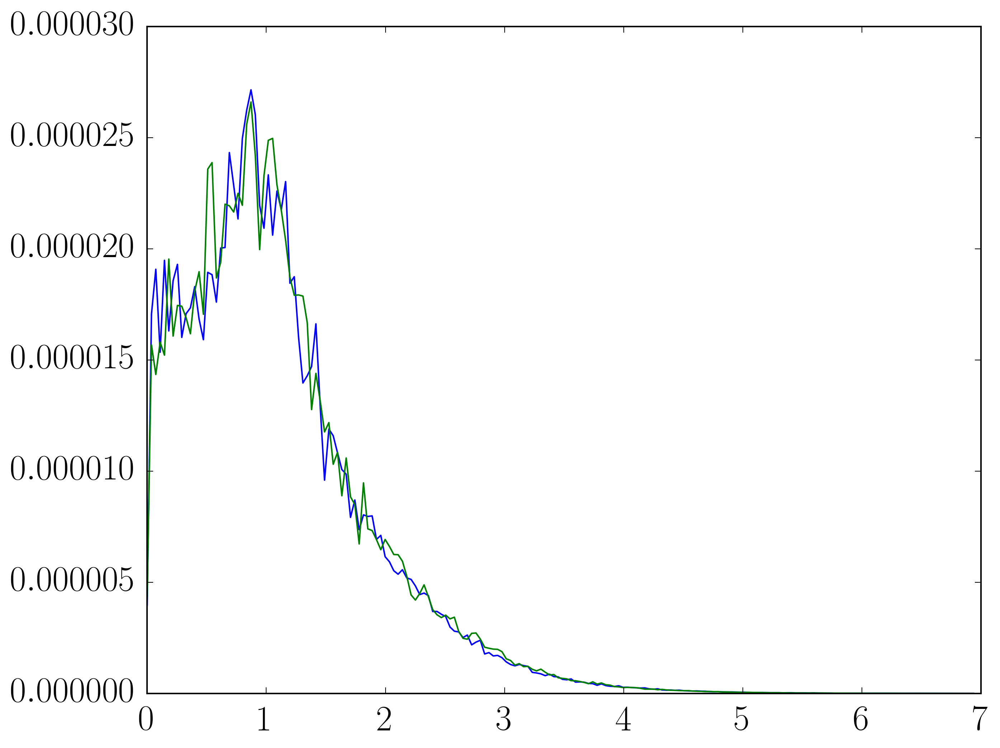

In [92]:
plt.plot(s1004['kz'],np.sum(s1004['SPEC'][:,1,1:],axis=1))
plt.plot(s1003['kz'],np.sum(s1003['SPEC'][:,1,1:],axis=1))

# $\dot{\delta_m}$ discussion

In [46]:
variable = 'dmpoint' #Pantano definition-Lacks drhodt!
xlabel =r'$ \tau$'
ylabel =r'$\frac{\dot{\delta_m}}{\Delta U}$ '
figname = 'dmpointvstime_ave'

# Additional term negelected within dmpoint:

$\frac{-1}{\rho_0 \Delta U^2}\int_{-\infty}^\infty 2 \mu \frac{\partial \overline{u}}{\partial y} \frac{\partial \tilde{u}}{\partial y} dy$

In [47]:
print njobs

12


0
1
2
3
4
5
6
7
8
9
10
11
figure saved!


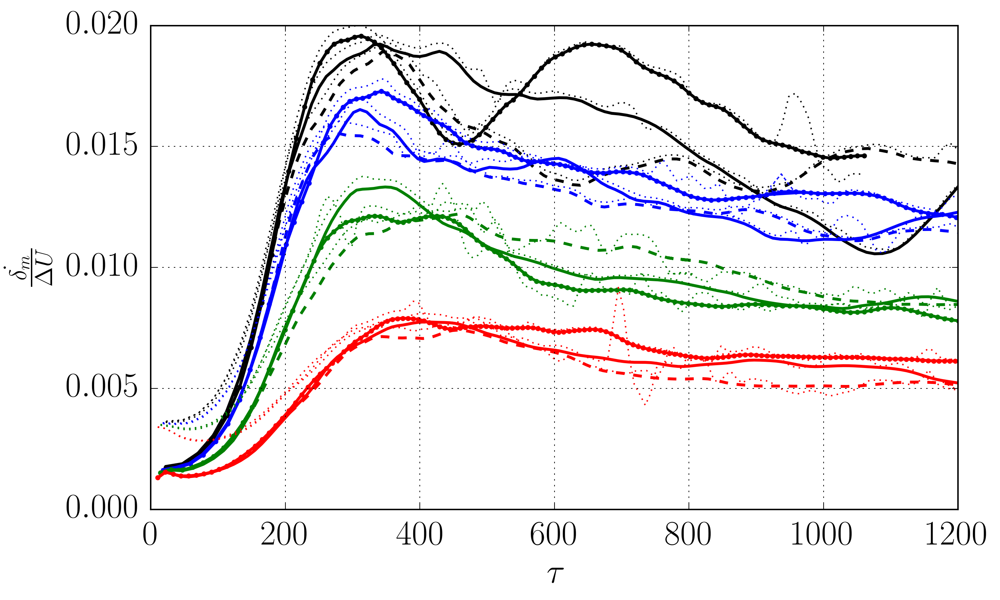

In [49]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
from scipy.stats import linregress
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
Cdelta = [0 for i in range(njobs)]
Cdelta2 = [0 for i in range(njobs)]
dwpoint = [0 for i in range(njobs)]
#errorCdelta = [0 for i in range(njobs)]
vtime = [0 for i in range(njobs)]
mu = 1.0/160
for ijob in range(njobs):
    path = p_folders[ijob]
    print ijob
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        y = np.array(f['y'])
        um = np.array(f['um'])
        uf = np.array(f['rum'])/np.array(f['rhom'])
        fun = np.array(f[variable] )
        dm = np.array(f['dm'])
        rho0=0.5*(np.array(f['rhom'][0,-1])+np.array(f['rhom'])[-1,-1])
        dumdy = 0.0*um
        dufdy = 0.0*uf
        ilim1 = where(time>SS1[ijob])[0][0]
        ilim2 = where(time>SS2[ijob])[0][0]
        slope = linregress(time[ilim1:ilim2],dm[ilim1:ilim2])
        m = slope.slope
        #fun2=der1(time,dm)
        fun3=-0.25*(f['rhom'][0,:]*f['vm'][0,:]+f['vm'][-1,:]*f['rhom'][-1,:])
        #dwpoint[ijob] = der1(time,np.array(f['dw']))
        Cdelta[ijob] = 2.0*fun*f['dw']/f['dm']
        #Cdelta2[ijob] = 2.0*fun*f['dw']/f['dm']
        vtime[ijob] = time
        #ilim = where(time>tmaxcases[ijob]-10)[0][0]
        visc = time[0:ilim]*0.0
        pepito = time[0:ilim]*0.0
        R12 = np.array(f['R12'])
        rhom = np.array(f['rhom'])
        for it in range(len(time[0:ilim])):
            dumdy[:,it] = der1(y,um[:,it])
            dufdy[:,it] = der1(y,uf[:,it])
            visc[it]=-2.0*mu*np.trapz(dumdy[:,it]*dufdy[:,it],y)
            pepito[it]=-2*np.trapz(rhom[:,it]*R12[:,it]*dufdy[:,it],y)
        plt.plot(time ,fun,l_single[ijob],lw=2.0)
        #plt.plot([time[ilim1],time[ilim2]] ,[m,m],l_job_style[ijob/3],lw=2.0,ls='dotted')
        plt.plot(time,der1(time,dm),l_job_style[ijob/3],ls='dotted')
        #plt.plot(time[0:ilim] ,fun2[0:ilim],l_job_style[ijob/3],lw=2.0,ls='dashed')
        #plt.plot(time[0:ilim] ,fun[0:ilim]-visc[0:ilim],l_job_style[ijob/3],lw=2.0,ls='dashed')
        #plt.plot(time[0:ilim] ,pepito[0:ilim],l_job_style[ijob/3],lw=2.0,ls='dashed')
        #plt.plot(time[0:ilim] ,fun[0:ilim]+fun3[0:ilim],l_job_style[ijob/3],lw=2.0,ls='dotted')
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_ylim([0,0.02])
ax.set_xlim([0,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + 'dmpoint_all' + fformat
    fig.savefig(pathname,bbox_inches='tight')


# Checks profiles collapse for different ranges

* Preselection of SS based on $\zeta$ and $\dot{\delta_m}$ constant:

$SS=(230-350,280-380,300-400,350-500)$

# SS for 5% of dispersion of R22

In [50]:
icase = 0
print lcases[icase]
print SS1[lcases[icase][0]:lcases[icase][-1]+1]
print SS2[lcases[icase][0]:lcases[icase][-1]+1]

[0, 1, 2]
[920, 980, 720]
[1004.0, 1132.0, 890.0]


In [51]:
print np.subtract(SS2,SS1)

[  84.  152.  170.  112.  211.  158.  189.  126.  169.  179.  110.  128.]


In [108]:
print SS1[2],SS2[2]

450 540


In [110]:
sumSpan=0
#jlist= [9,10,11] #s=8
#jlist= [6,7,8] #s=4
#jlist= [3,4,5] #s=2
jlist = [0,1,2] #s=1
scase = 1 ;#s=4,8
#dw0=40.0 #s=8
dw0=35.0 #s=4
jjob=2
for ijob in jlist:
    sumSpan += SS2[ijob]-SS1[ijob]
print r"SS timespan for case s=%s is %s $\delta_m^0/\Delta U$, correspondign to %s $\delta_w/\Delta U$" %(scase,sumSpan,sumSpan/dw0)

SS timespan for case s=1 is -290 $\delta_m^0/\Delta U$, correspondign to -8.28571428571 $\delta_w/\Delta U$


It has been observed that the variable $R_{12}$ is the most restrictive of the Reynolds stress tensor for SS.

In [ ]:
# fformat='.pdf'
PRINT=True
lvariable=['R11','R22','R33','R12']
xlabel=r"$y\delta_w$"
ylabel=r"$\overline{\omega_z}\delta_w\Delta U$"
ylabel=r"$\overline{R_{11}}/\Delta U^2$"
scaling = 'dm'
nranges=1
showOUT=False
tmax=1620
#jlist = [0,1,2] #s=1
#jlist= [3,4,5] #s=2
#jlist= [6,7,8] #s=4
#jlist= [3,4,5]
#jlist=[3,4,5]
jlist2=[jlist[jjob]]
smax = 5.0
Dtout=1.0
figname = 'SS%ss%srun%s'%(variable,scase,jlist2[0])
#fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
#ax=fig.add_subplot(1,1,1)
count = 0
ijob = jlist[jjob]
for variable in lvariable:
    dispflag = False
    t11 = SS1[ijob]; t12 = SS2[ijob]; 
    #print t12
    #print t11,t12
    Dt = (t12-t11)/(nranges)
    vt1=np.linspace(t11,t12,nranges)
    for i in range(nranges):
        tmin = vt1[i];tmax = vt1[i]+Dt
        yxi,fun,error = getSSprofile(p_folders[ijob],variable,tmin,tmax,scaling)
        #plt.plot(yxi,fun,lw=1.0)
        #fun[fun<1E-9]=np.nan
        #itpeak = np.where(fun>=np.max(fun))[0][0]
        #print itpeak
        rel_err= np.max(error)/np.max(fun)*100
        #print rel_err
        #rel_err= np.max(error)/np.max(fun)*100
        if rel_err > smax:
            print "%s: Sigma = %s > sigma_max = %s" %(variable,rel_err,smax)
            dispflag = True
        count+=1
    if dispflag == False:
        print "%s is below the threshold, congratulations!"%(variable)

1012.0
6.57958618439
Sigma = 6.57958618439 > sigma_max = 2.0
Total number of profiles = 1
/share/drive/toni/VDML/JFM/SSR11s4run3.pdf


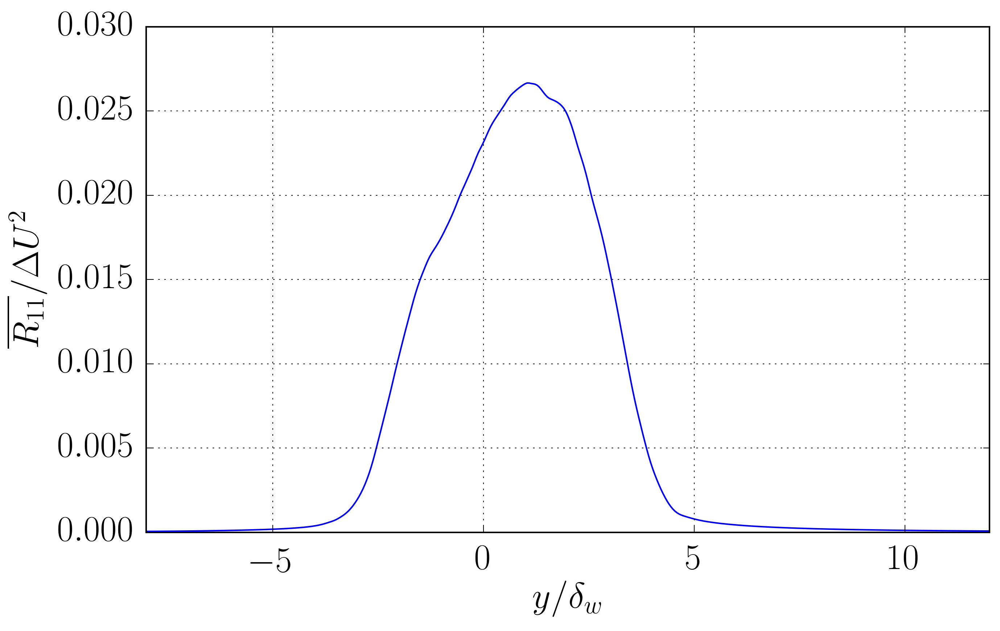

In [946]:
# fformat='.pdf'
PRINT=True
variable='R11'
xlabel=r"$y/\delta_w$"
ylabel=r"$\overline{\omega_z}\delta_w\Delta U$"
ylabel=r"$\overline{R_{11}}/\Delta U^2$"
scaling = 'dm'
nranges=1
showOUT=False
tmax=1620
#jlist = [0,1,2] #s=1
#jlist= [3,4,5] #s=2
#jlist= [6,7,8] #s=4
#jlist= [3,4,5]
#jlist=[3,4,5]
jlist2=[jlist[jjob]]
smax = 2.0
Dtout=1.0
figname = 'SS%ss%srun%s'%(variable,scase,jlist2[0])
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
count = 0
for ijob in jlist2:
    t11 = SS1[ijob]; t12 = SS2[ijob]; 
    print t12
    #print t11,t12
    Dt = (t12-t11)/(nranges)
    vt1=np.linspace(t11,t12,nranges)
    for i in range(nranges):
        tmin = vt1[i];tmax = vt1[i]+Dt
        yxi,fun,error = getSSprofile(p_folders[ijob],variable,tmin,tmax,scaling)
        plt.plot(yxi,fun,lw=1.0)
        #fun[fun<1E-9]=np.nan
        #itpeak = np.where(fun>=np.max(fun))[0][0]
        #print itpeak
        rel_err= np.max(error)/np.max(fun)*100
        print rel_err
        #rel_err= np.max(error)/np.max(fun)*100
        if rel_err > smax:
            print "Sigma = %s > sigma_max = %s" %(rel_err,smax)
        count+=1
    #one before SS
    if showOUT==True:
        tmin = SS1[ijob]-Dtout;tmax=tmin+8.0;
        yxi,fun,error = getSSprofile(p_folders[ijob],variable,tmin,tmax,scaling)
        plt.plot(yxi,np.sqrt(fun),'g--',label=r"\tau=%s"%(tmin))
    #one after SS
        tmin = SS2[ijob]+Dtout;tmax=tmin+10.0;
        yxi,fun,error = getSSprofile(p_folders[ijob],variable,tmin,tmax,scaling)
        plt.plot(yxi,fun,'r.-',label=r"\tau=%s"%(tmin))
if scaling =='dm':
    plt.xlim([-8,12])
else:
    plt.xlim([-2,2])
    #plt.ylim([0.0,0.2])
print "Total number of profiles = %s"%count
plt.xlabel(xlabel);
plt.ylabel(ylabel);
plt.grid('on')
plt.legend(loc=2,prop={'size':14})
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')

Total number of profiles = 50
/share/drive/toni/VDML/JFM/SSR12s8all.pdf


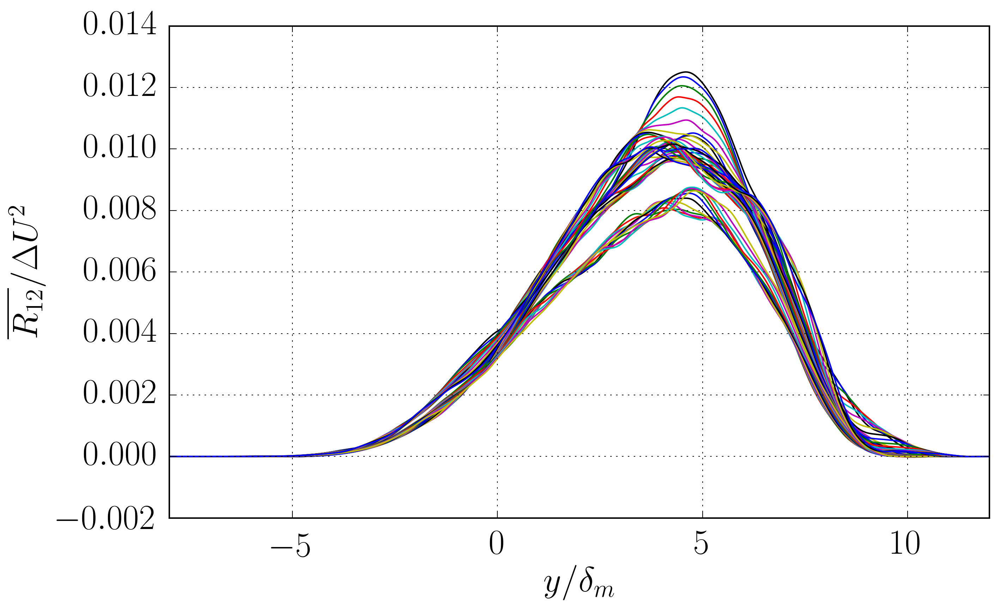

In [1266]:
# fformat='.pdf'
PRINT=True
variable='R12'
xlabel=r"$y/\delta_m$"
ylabel=r"$\overline{\omega_z}\delta_w/\Delta U$"
ylabel=r"$\overline{R_{12}}/\Delta U^2$"
scaling = 'dm'
#jlist = [0,1,2] #s=1
scase=8
icase=3
#jlist= [3,4,5] #s=2
#jlist= [6,7,8] #s=4
#jlist= [3,4,5]
#jlist=[3,4,5]
#jlist2=[jlist[jjob]]
figname = 'SS%ss%sall'%(variable,scase)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
count = 0
for ijob in lcases[icase]:
#for ijob in lcases[icase][2:3]:
#for ijob in [11]:
#for ijob in [0,1,2]:
    t11 = SS1[ijob]; t12 = SS2[ijob]; 
    #print t11,t12
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time=np.array(f['time'])
        y=np.array(f['y'])
        delta =np.array(f[scaling])
        fun =np.array(f[variable])
    it1=where(time>=t11)[0][0]
    it2=where(time>=t12)[0][0]
    for it in range(it1,it2):
        yxi = y/delta[it]
        f = fun[:,it]
        plt.plot(yxi,f,lw=1.0)
        count+=1
        #fun[fun<10E-9]=np.nan
print "Total number of profiles = %s"%count
if scaling =='dm':
    plt.xlim([-8,12])
else:
    plt.xlim([-1,2])
#plt.ylim([0.0,0.2])
plt.xlabel(xlabel);
plt.ylabel(ylabel)
plt.grid('on')
plt.legend(loc=2,prop={'size':14})
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')

## 

/share/drive/toni/VDML/s10/01/h5.stats
diff time=11.9418945312
/share/drive/toni/VDML/s10/02/h5.stats
diff time=11.6707763672
/share/drive/toni/VDML/s10/03/h5.stats
diff time=9.91052246094
/share/drive/toni/VDML/s20/01/h5.stats
diff time=11.9157714844
/share/drive/toni/VDML/s20/02/h5.stats
diff time=11.6130371094
/share/drive/toni/VDML/s20/03/h5.stats
diff time=8.29614257812
/share/drive/toni/VDML/s40/01/h5.stats
diff time=9.994140625
/share/drive/toni/VDML/s40/02/h5.stats
diff time=9.61596679688
/share/drive/toni/VDML/s40/03/h5.stats
diff time=10.6611328125
/share/drive/toni/VDML/s80/01/h5.stats
diff time=8.15966796875
/share/drive/toni/VDML/s80/02/h5.stats
diff time=8.32080078125
/share/drive/toni/VDML/s80/03/h5.stats
diff time=8.064453125
851 0.289709824147
0.289002711869


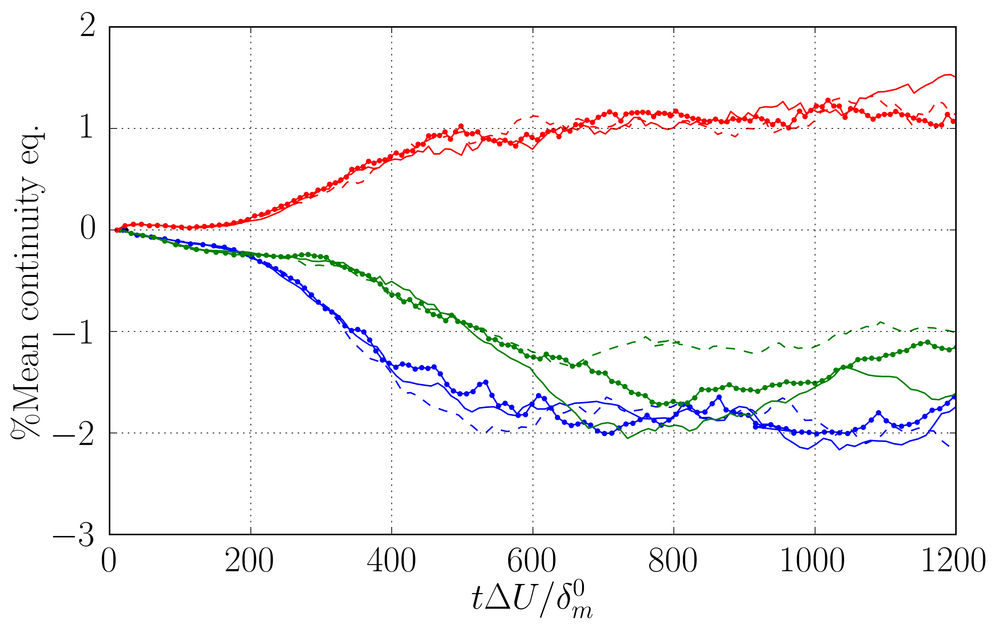

In [1267]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#xlabel = r'$y/\delta_m^0$'
#ylabel = r'$\Delta y$'
xlabel = r'$t \Delta U/\delta_m^0$'
var = 'urms'
iobs=-1
ylabel = var
#ylabel="fun"
l_style=['k','b-','g*']
#'/share/drive/toni/VDML/s80/test/06/h5.stats',
jj=0
for path in p_folders:
    print path
    with h5py.File(path,"r") as f:
        time=np.array(f['time'])
        bet = np.array(f['bet'])
        yf  =np.array(f['y'])
        dm  =np.array(f['dm'])
        rvm = np.array(f['rvm']);
        rhom = np.array(f['rhom']);
        dmpoint = np.array(f['dmpoint'])
        fun = np.array(f[var]);
        vcont = np.zeros(len(time))
        vcont2 = np.zeros(len(time))
        drhodt = np.zeros(len(time))
        #itmax = np.where(time<234.0)[0][-1]
        itmax=len(time)
        for ii in range(1,itmax-1):
            vcont[ii] = (np.trapz(rhom[:,ii+1]-rhom[:,ii-1],yf)/(time[ii+1]-time[ii-1])+rvm[-1,ii]-rvm[0,ii])/np.max(rvm[:,ii])*100
            drhodt[ii] = ((np.trapz(rhom[:,ii],yf)-np.trapz(rhom[:,ii-1],yf))/(time[ii]-time[ii-1]))
            vcont2[ii] = rvm[-1,ii]-rvm[0,ii]
        print "diff time=%s"%(np.diff(time)[-1])
    #plt.plot(yf,fun[:,iobs-2:iobs])#,l_style[jj]
    plt.plot(time[:-1],(vcont[:-1]),l_single[jj])
    #plt.plot(time[:-1],(drhodt[:-1]),l_single[jj])
    #plt.plot(time[:-1],(vcont2[:-1]),l_single[jj])
    #plt.plot(time,dmpoint*100)
    #plt.plot(time[:-1],-(drhodt[:-1]),'--')
    jj = jj +1
#plt.yscale('log')
#plt.plot(time,der1(time,dm)*20)
ylabel=r'$\% \textnormal{Mean continuity eq.}$'

plt.xlabel(xlabel);plt.ylabel(ylabel)
plt.grid('on')
#plt.ylim([0,5])
plt.xlim([0,tmax])
#plt.plot(yf[1:],np.diff(yf)
#plt.yscale('log')
#plt.ylim([-5,5])
print len(yf),np.diff(yf)[1]
print np.diff(yf)[-1]
plt.grid('on')

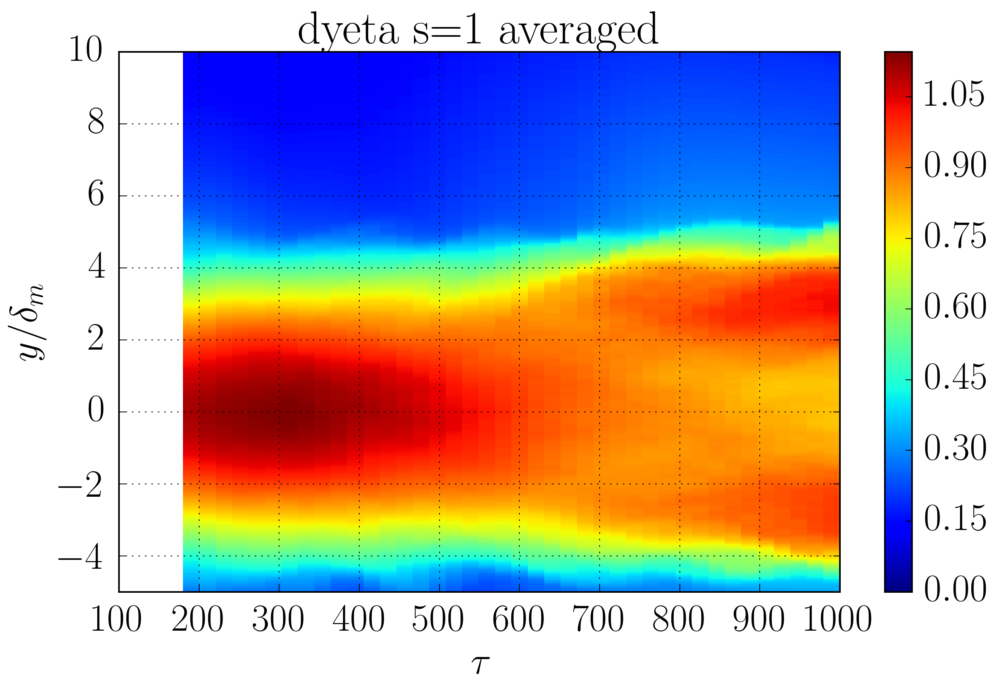

In [62]:
fformat='.pdf'
scase =1
icase=0
#jlist2=[0,1,2]
#jlist2= [9,10,11] #s=8
jlist2= [0] #s=8
#jlist= [6,7,8] #s=4
variable='dyeta'
PRINT=True

figname = variable+'contours%srun'%(scase)
scaling = 'dm'
#jlist = [0,1,2] #s=1
#jlist= [3,4,5] #s=2
#jlist= [2] #s=8
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
t1 = 180; t2 =1000; 
scaling = 'dm'
derivative= False
Ntimes=41; ny = 500;
pcmatrix = np.zeros([ny,Ntimes])
tvec = np.linspace(t1,t2,Ntimes)
for ijob in jlist2:
    path = p_folders[ijob]
    for i in range(Ntimes-1):
        yxi, f, ef = getSSprofile(path,variable,tvec[i],tvec[i+1],scaling, ny)
        pcmatrix[:,i] = pcmatrix[:,i] + f

        
NC=20
plt.pcolor(tvec,yxi,pcmatrix,vmin=0)
#plt.contourf(tvec,yxi,pcmatrix,np.linspace(np.min(pcmatrix),np.max(pcmatrix),NC))
plt.ylim([-5,10])
plt.ylabel(r'$y/\delta_m$')
plt.xlabel(r'$\tau$')
plt.grid('on')
plt.colorbar()
stitle="%s s=%s averaged" % (variable,scase)
plt.title(stitle)
PRINT = False
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')

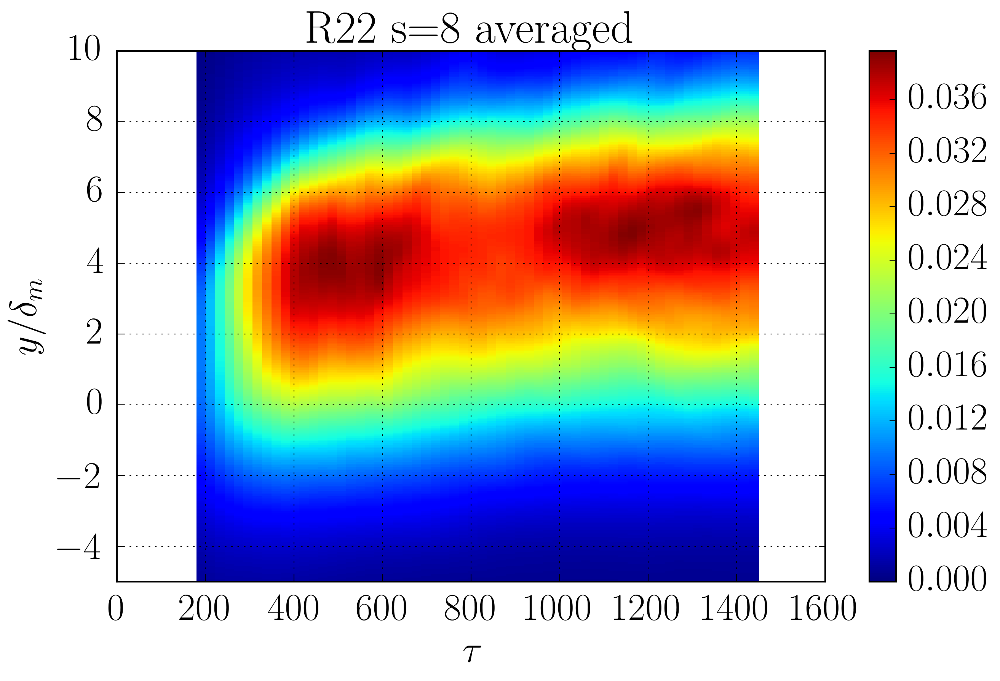

In [63]:
fformat='.pdf'
scase = 8
icase=3
#jlist2=[0,1,2]
jlist2= [9,10,11] #s=8
#jlist= [6,7,8] #s=4
variable='R22'
PRINT=True

figname = variable+'contours%srun'%(scase)
scaling = 'dm'
#jlist = [0,1,2] #s=1
#jlist= [3,4,5] #s=2
jlist= [6,7,8] #s=8
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
t1 = 180; t2 =1450; 
scaling = 'dm'
derivative= False
Ntimes=61; ny = 500;
pcmatrix = np.zeros([ny,Ntimes])
tvec = np.linspace(t1,t2,Ntimes)
for ijob in jlist2:
    path = p_folders[ijob]
    for i in range(Ntimes-1):
        yxi, f, ef = getSSprofile(path,variable,tvec[i],tvec[i+1],scaling, ny)
        pcmatrix[:,i] = pcmatrix[:,i] + f

        
NC=20
plt.pcolor(tvec,yxi,pcmatrix,vmin=0)
#plt.contourf(tvec,yxi,pcmatrix,np.linspace(np.min(pcmatrix),np.max(pcmatrix),NC))
plt.ylim([-5,10])
plt.ylabel(r'$y/\delta_m$')
plt.xlabel(r'$\tau$')
plt.grid('on')
plt.colorbar()
stitle="%s s=%s averaged" % (variable,scase)
plt.title(stitle)
PRINT = False
if PRINT == True:
    pathname = save_folder + figname+ fformat
    print pathname
    fig.savefig(pathname,bbox_inches='tight')

# $Re_\lambda$ vs time

In [64]:
variable = 'Relambda'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$Re_\lambda$'
figname = 'dmvstime'

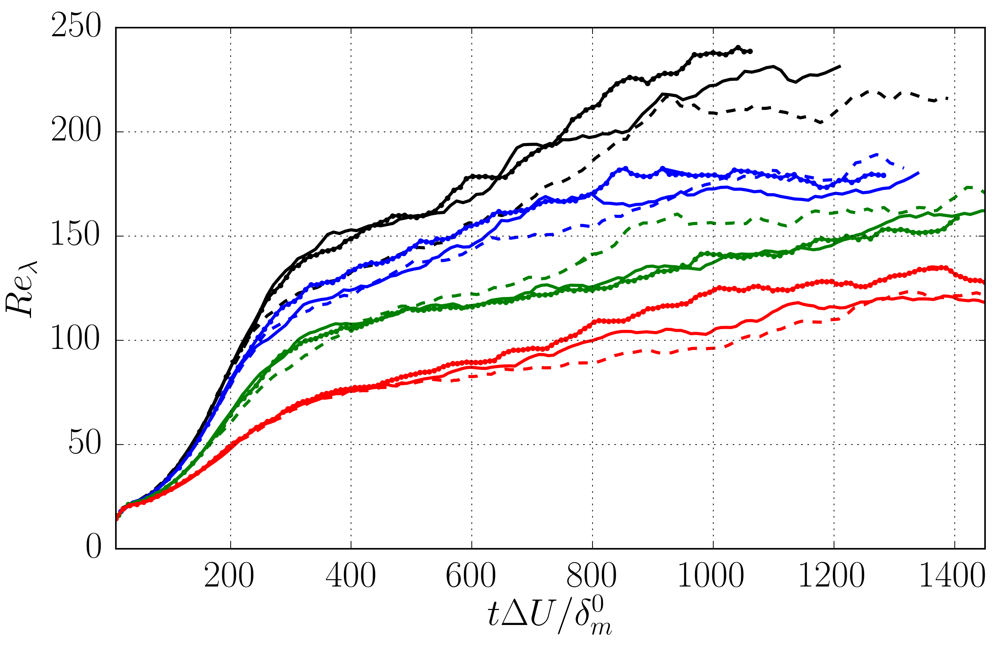

In [65]:
#Preparing plot
#tmax=700
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        fun = np.array(f[variable] )
             #tmaxjob[ijob] = np.max(time)
        #ilim = where(time>tmaxcases[ijob])[0][0]
        #print (fun[-1]-fun[0])/(time[-1]-time[0])
        #print ilim
        plt.plot(time,fun,l_single[ijob],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([10,1450])
plt.grid('on')
#SAVING
#if PRINT == True:
#    print "figure saved!"
#    pathname = save_folder + 'epsvstime_ave' + fformat
#    fig.savefig(pathname,bbox_inches='tight')


In [72]:
variable = 'dyeta'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$dyeta_max$'
figname = 'dmvstime'

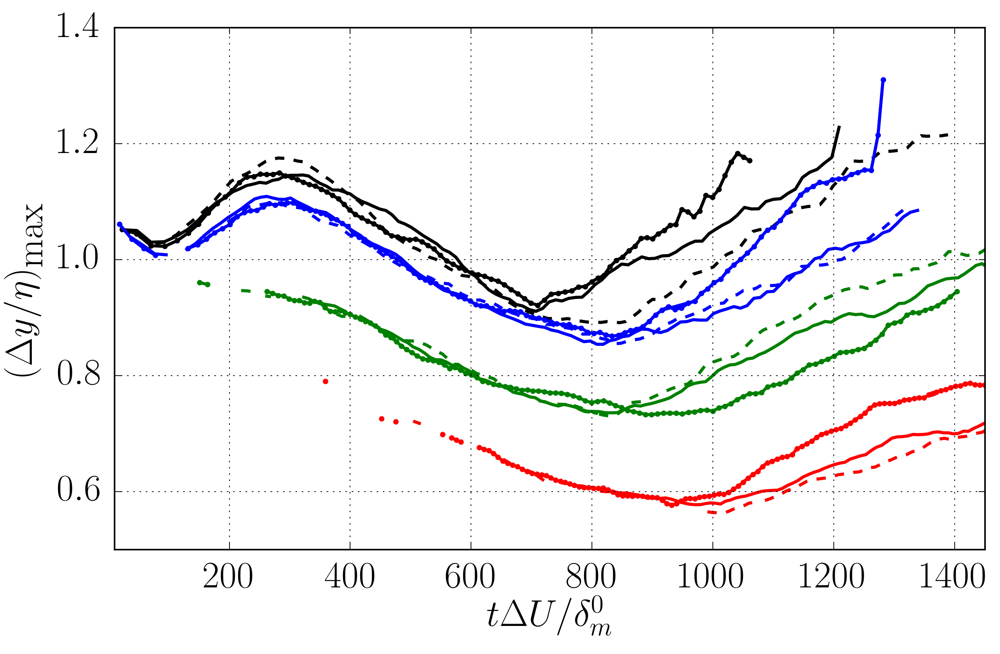

In [77]:
#Preparing plot
#tmax=700
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        fun = np.array(f[variable] )
             #tmaxjob[ijob] = np.max(time)
        #ilim = where(time>tmaxcases[ijob])[0][0]
        #print (fun[-1]-fun[0])/(time[-1]-time[0])
        #print ilim
        plt.plot(time,np.max(fun,axis=0),l_single[ijob],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_ylabel(r'$\left( \Delta y/\eta \right)_{\textnormal{max}}$')
ax.set_xlabel(xlabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([10,1450])
plt.grid('on')
#SAVING
#if PRINT == True:
#    print "figure saved!"
#    pathname = save_folder + 'epsvstime_ave' + fformat
#    fig.savefig(pathname,bbox_inches='tight')


In [66]:
print l_job_style
l_case_color=['k','b','g','r']
print save_folder
fformat='.pdf'

['k-', 'b-', 'g-', 'r-']
/share/drive/toni/VDML/JFM/


150 150
141 141
126 126
131 131


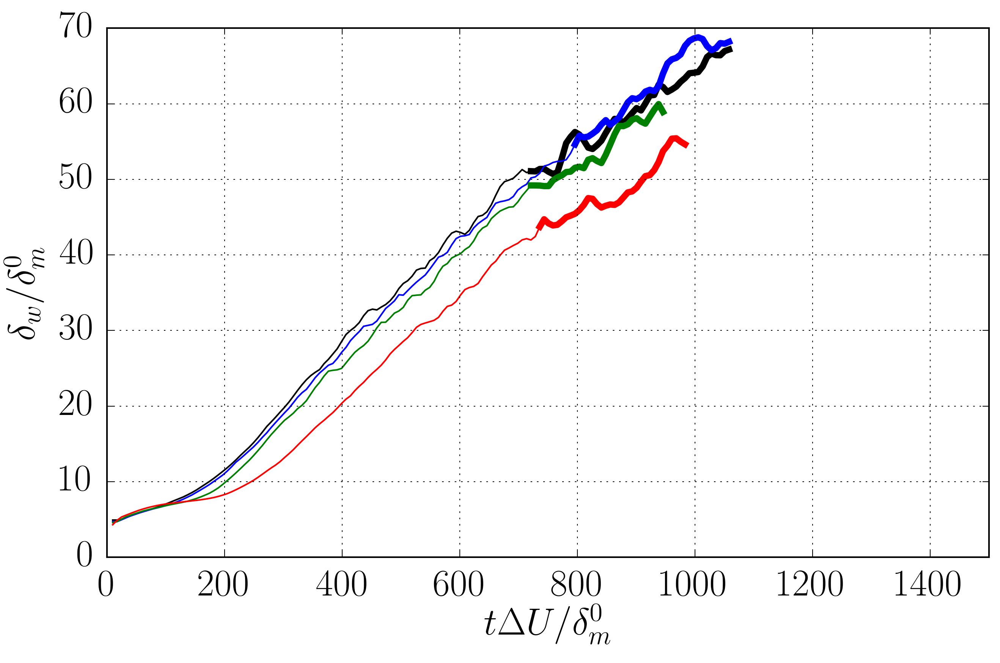

In [67]:
#Preparing plot
variable = 'dw'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\delta_w/\delta_m^0$'
figname = 'dwvstime'
tmin=10
tmax=1500
var
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#ax2 = ax.twinx()
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
#vtcases2,vfcases2,stddcases2 = fcaseintime(p_folders,lcases,variable2,tmin,tmax)
for icase in range(ncases):
    ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    minSS=np.min(SS1[3*icase:3*icase+3])
    maxSS=np.max(SS2[3*icase:3*icase+3])
    ilim1 = where(vtcases[icase]>minSS)[0][0]
    ilim2 = where(vtcases[icase]>maxSS)[0][0]
    print ilim,ilim2
    ax.plot(vtcases[icase][0:ilim],vfcases[icase][0:ilim],l_job_style[icase],lw=1.0)
    ax.plot(vtcases[icase][ilim1:ilim2],vfcases[icase][ilim1:ilim2],l_job_style[icase],lw=4.0)
    #ax.plot([minSS,minSS],[0,vfcases[icase][ilim1]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.plot([maxSS,maxSS],[0,vfcases[icase][ilim2]],color=l_job_color[icase],ls='dotted',lw=2.0)
    #ax.fill_between(vtcases[icase][0:ilim2], 0, vfcases[icase][0:ilim2], where=vtcases[icase][0:ilim2]>minSS, facecolor=l_job_color[icase],alpha=0.6, interpolate=False)
#ax.set_xlabel(xlabel)
    #ax.plot([],[0.0,0.005])
    #ax2.plot(vtcases2[icase][0:ilim],vfcases2[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
#ax.set_ylim([0,0.005])
ax.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    NS = 7
    imin = 20
    for icase in range(ncases):
        ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
        plt.errorbar(vtcases[icase][imin:ilim:NS],vfcases[icase][imin:ilim:NS],yerr=stddcases[icase][imin:ilim:NS],color=l_case_color[icase])
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')


In [480]:
print SS1
print SS2

[920, 980, 720, 920, 850, 800, 750, 780, 820, 800, 800, 800]
[1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 990.0, 990.0, 858.0]


In [481]:
print [160*29,160*42],[160*28,160*38]

[4640, 6720] [4480, 6080]


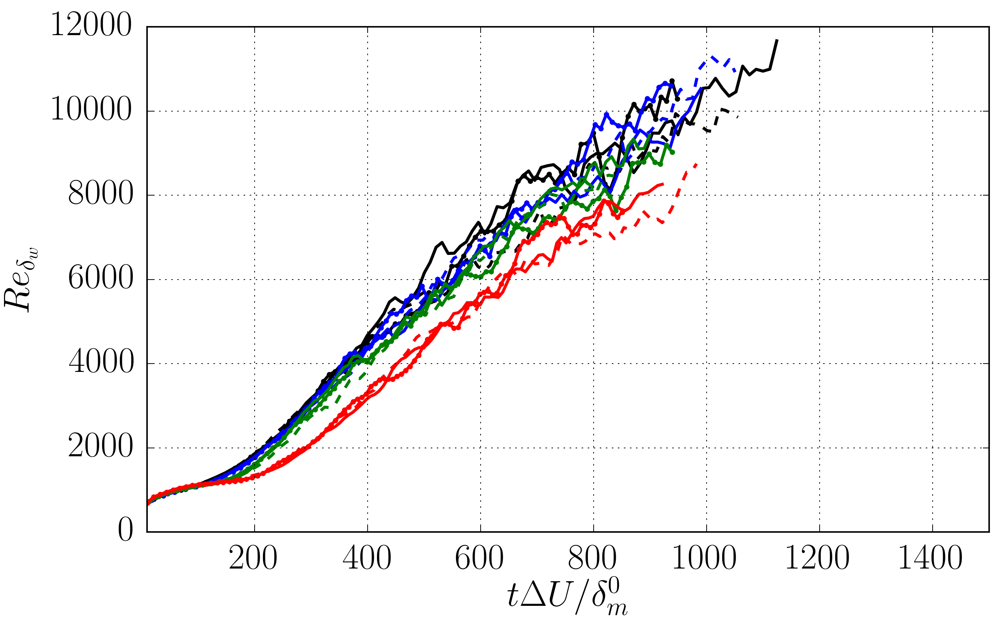

In [1284]:
#Preparing plot
variable='dw'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
Rew0 = 600
tmaxjob = [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        fun = np.array(f[variable] )
        #tmaxjob[ijob] = np.max(time)
        ilim = where(time>tmaxcases[ijob])[0][0]
        #print ilim
        plt.plot(time[0:ilim] ,160*fun[0:ilim],l_single[ijob],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(r'$Re_{\delta_w}$')
#ax.set_ylim([0,7.0])
ax.set_xlim([10,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + 'Redwvstime' + fformat
    fig.savefig(pathname,bbox_inches='tight')


## dmpoint

In [1285]:
print SS1,SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


In [1286]:
variable = 'dmpoint'
xlabel =r'$\tau$'
ylabel =r'$\dot{\delta}_m/\Delta U$'
figname = 'dmpointvstime_ave'

In [1287]:
dwdotmean=[0.0,0.13/2.0,0.12/2.0,0.1/2.0]

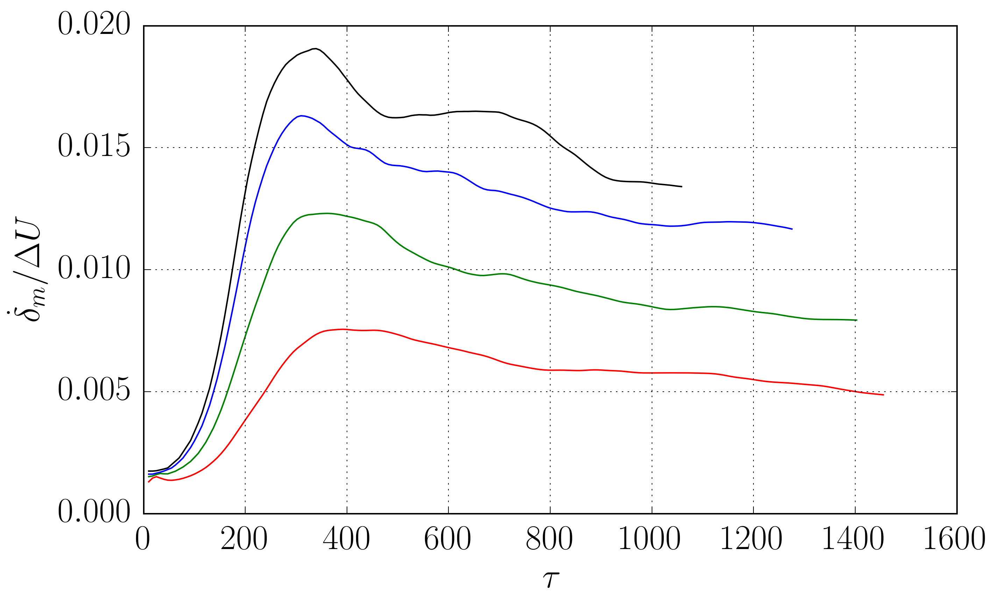

In [1288]:
from scipy.stats import linregress 
#Preparing plot
xlabel =r'$t \Delta U/\delta_m^0$'
xlabel =r'$\tau$'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]
dmpdens = [[] for i in range(njobs)]
dmptotal = [[] for i in range(njobs)]
dmpturb=[[] for i in range(njobs)]
vtime = [[] for i in range(njobs)]
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = np.array(f['time'])
        vtime[ijob]=time
        dw  = np.array(f['dw'])
        fun = np.array(f[variable] )
        fun2= der1(time,np.array(f['dm']))
        fun3=0.25*(np.array(f['rvm'])[0,:]-np.array(f['rvm'])[-1,:])
        dmpdens[ijob] = fun3
        dmpturb[ijob]=fun
        dmptotal[ijob]=fun
        Cdelta[ijob] = 2.0*der1(time,f['dw'])
        #print np.max(fun3)
        #ilim = where(time>tmaxcases[ijob/3])[0][0]
        ilim = where(time>SS2[ijob])[0][0]
        iSS1 = where(time>SS1[ijob])[0][0]
        slope = linregress(time[iSS1:ilim],dw[iSS1:ilim])
        Cdelta[ijob] = 2.0*slope.slope
        #plt.plot(time[0:ilim] ,fun[0:ilim],l_job_style[ijob/3],ls='dashed',lw=2.0)
        #plt.plot(time[0:ilim] ,fun2[0:ilim],l_job_style[ijob/3],lw=2.0)
        #plt.plot(time[0:ilim] ,fun[0:ilim],l_job_style[ijob/3],ls='dotted',lw=2.0)
for icase in range(ncases):
    plt.plot(vtcases[icase],vfcases[icase],l_job_style[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
#ax.set_xlim([0,np.max(tmaxjob)])
plt.grid('on')
#SAVING
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')


In [1289]:
print Cdelta

[0.12726308737847025, 0.18258120692886926, 0.10293944282991095, 0.19191550992538706, 0.1633146924888271, 0.10225837122340993, 0.091105909669801241, 0.062756335839791691, 0.12602616609195397, 0.08190113455493471, 0.18248621741943313, 0.041979835418030034]


In [1290]:
print SS1,SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


In [1291]:
print 0,0.0001607/0.0125*100, 0.000597/0.0098*100, 0.00072/0.0064*100
print 0.01304/0.0135*100, 0.011876/0.0125*100, 0.008788/0.0098*100, 0.00524/0.0064*100

0 1.2856 6.09183673469 11.25
96.5925925926 95.008 89.6734693878 81.875


# Obtaining $\dot{\delta_m}/\dot{\delta_m(1)}$

In [1312]:
import uncertainties as unc  
import uncertainties.unumpy as unumpy  

In [1313]:
dmp = [[] for ijob in range(njobs)]
errordmp = [[] for ijob in range(njobs)]
#variable='dmpoint'
variable='dmpoint';derivative=False
for ijob,path in zip(range(njobs),p_folders):
    print ijob,path
    #dmp[ijob],errordmp[ijob] = getvarmeanintime(path,variable,SS1[ijob],SS2[ijob])
    dmp[ijob],errordmp[ijob] = getvarmeanintime(path,variable,SS1[ijob],SS2[ijob],derivative)

0 /share/drive/toni/VDML/s10/01/h5.stats
1 /share/drive/toni/VDML/s10/02/h5.stats
2 /share/drive/toni/VDML/s10/03/h5.stats
3 /share/drive/toni/VDML/s20/01/h5.stats
4 /share/drive/toni/VDML/s20/02/h5.stats
5 /share/drive/toni/VDML/s20/03/h5.stats
6 /share/drive/toni/VDML/s40/01/h5.stats
7 /share/drive/toni/VDML/s40/02/h5.stats
8 /share/drive/toni/VDML/s40/03/h5.stats
9 /share/drive/toni/VDML/s80/01/h5.stats
10 /share/drive/toni/VDML/s80/02/h5.stats
11 /share/drive/toni/VDML/s80/03/h5.stats


In [1314]:
ncases = len(lcases)
dmpcase= [[]for i in range(ncases)]
dmpcaseB= [[]for i in range(ncases)]
z= [[]for i in range(ncases)]
dmperrorcase = [[]for i in range(ncases)]

for icase in range(ncases):
    dmptmp= [[]for i in range(len(lcases[icase]))]
    for ijob,i in zip(lcases[icase],range(len(lcases[icase]))):
        dmptmp[i] = dmp[ijob]
    dmpcase[icase]=np.mean(dmptmp,axis=0)
    dmperrorcase[icase]=np.std(dmptmp,axis=0)
    dmpcaseB[icase] = unumpy.uarray(dmpcase[icase], dmperrorcase[icase])
    z[icase] = dmpcaseB[icase]/dmpcaseB[0]
    print "dmpoint = %s, std= %s" %(dmpcase[icase],dmperrorcase[icase])
#Now we want to compute it scaled with s=1
for icase in range(1,ncases):
    dmperrorcase[icase]=np.sqrt((dmperrorcase[icase]/dmpcase[0])**2+(dmpcase[icase]/dmpcase[0]**2*dmperrorcase[0])**2)
    dmpcase[icase] = dmpcase[icase]/dmpcase[0]
    print dmpcase[icase],dmperrorcase[icase]
    print z[icase]
dmperrorcase[0]=np.sqrt((dmperrorcase[0]/dmpcase[0])**2.0+(dmpcase[0]/dmpcase[0]**2*dmperrorcase[0])**2)
dmpcase[0] = 1.0
#errz=unumpy.std_devs(z)  


dmpoint = 0.0147233922407, std= 0.00201335033396
dmpoint = 0.0119640249467, std= 0.000712730164499
dmpoint = 0.0093420364589, std= 0.000801780082252
dmpoint = 0.00584631191831, std= 0.00054767756853
0.812586172476 0.121203735714
0.81+/-0.12
0.634502994025 0.102438584
0.63+/-0.10
0.397076422522 0.06581771443
0.40+/-0.07


In [1315]:
l_job_color=['k','b','g','r']
l_case_color=l_job_color
PRINT=True

True
/share/drive/toni/VDML/JFM/dotdm_comparition2.pdf


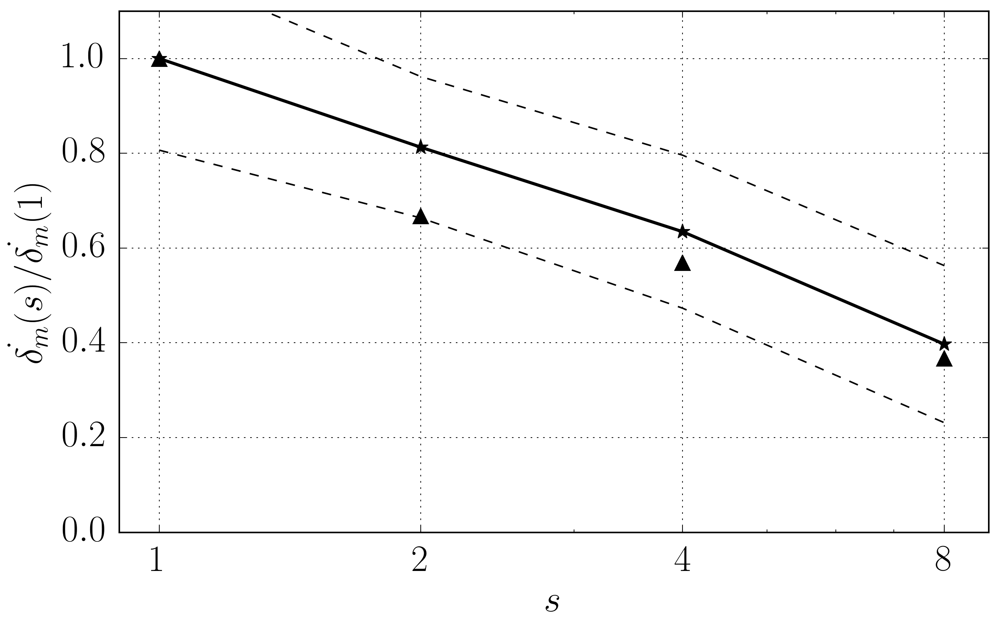

In [1320]:
pantanodotdm=[[1.0,2,4,8.0],[1.0,0.668,0.569,0.367]]
vectors=np.array([1,2,4,8])
ramshaw = 2*np.sqrt(vectors)/(vectors+1.0)
xlabel =r'$s$'
ylabel =r'$\dot{\delta_m}(s)/\dot{\delta_m}(1)$ '
#ylabel=r'$\dot{\delta}_m(s)/\dot{\delta}_m(1)}$'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
error =np.array(dmperrorcase[:])
f= np.array(dmpcase[:])
#plt.fill_between(vectors[1:], f[1:]-error[1:], f[1:]+error[1:],alpha=0.1)
#plt.plot(vectors,ramshaw,'k--',lw=2.5)
plt.plot(pantanodotdm[0],pantanodotdm[1],'k^',ms=10)
#plt.plot([1.0,2.0,4.0,8.0],oneal,'r*',ms=8.0)
#plt.plot([1.0,2.0,4.0,8.0],onealP,'ks',ms=6.0)
#plt.plot(1,1,'ko',ms=10.0)
#plt.plot([2.0,4.0,8.0],[dmp[1]/dmp[0], dmp[2]/dmp[0],dmp[3]/dmp[0]],'rv',ms=12.0)
#plt.plot([1.0, 2.0,4.0,8.0],[1.0,dmp[1]/dmp[0], dmp[2]/dmp[0],dmp[3]/dmp[0]],'r-')
plt.plot(vectors,f,'k*-',lw=2.0,ms=10)
fpsigma = f+error/f
fmsigma = f-error/f
plt.plot(vectors,fpsigma,'k--')
plt.plot(vectors,fmsigma,'k--')
#for icase in range(1,ncases):
#     ax.errorbar(vectors[icase],f[icase],yerr=error[icase],marker='.',mfc=l_case_color[icase], \
#                ms=10.0,fmt='o',color=l_case_color[icase],lw=2.0)

plt.xlabel(xlabel)
plt.ylim([0.0,1.1])
plt.xlim([0.9,9])
plt.ylabel(ylabel)
#ax.set_xscale('log')
ax.set_xscale('log')
ax.set_xticks([1,2, 4, 8])
ax.get_xaxis().set_major_formatter(plt.matplotlib.ticker.ScalarFormatter())
plt.grid('on')
if PRINT == True:
    print PRINT
    pathname = save_folder + 'dotdm_comparition2' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    pathname = save_folder + 'dotdm_comparition2' + '.pdf'
    fig.savefig(pathname,bbox_inches='tight')
    print pathname

In [1321]:
dmratios=f

In [1322]:
print SS1, SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


# Obtaining $C_{\delta}$

In [1323]:
#Pantano:
CdeltaPant=[0.117,0.084,0.093,0.071]
dmratiosPant=[1.00,0.67,0.57,0.37]
fpant = np.divide(CdeltaPant,CdeltaPant[0])

In [1324]:
dmtodwPant = fpant/dmratiosPant

# $D_W$

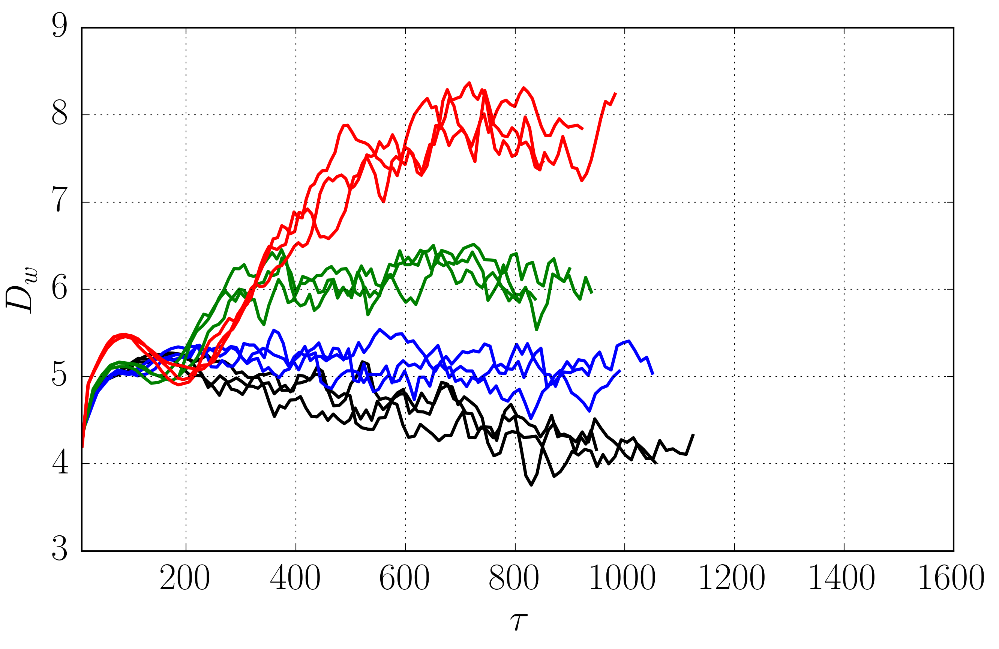

In [1325]:
#Preparing plot
xlabel =r'$\tau$'
figname='Dw'
ylabel = r'$D_w$'
tmax=1600
PRINT=False
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
ijob=0
variable1='dm'
variable2='dw'
Dw= [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        fun1 = np.array(f[variable1])
        fun2 = np.array(f[variable2])
        time = np.array(f['time'])
        ilim = where(time>tmaxcases[ijob])[0][0]
        Dw[ijob] = fun2/fun1
        plt.plot(time[0:ilim] ,Dw[ijob][0:ilim],l_job_style[ijob/3],lw=2.0)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_xlim([tmin,tmax])
plt.grid('on')
#SAVING
#PRINT = False
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure saved at %s!"%pathname

In [1326]:
DwSS = [[] for i in range(njobs)]
errorDwSS = [[] for i in range(njobs)]
for ijob in range(njobs):
    DwSS[ijob],errorDwSS[ijob] = getvarmeanintimeV(Dw[ijob],vtime[ijob],SS1[ijob],SS2[ijob])
ncases = len(lcases)
Dwcase= [[]for i in range(ncases)]
Dwerrorcase = [[]for i in range(ncases)]

for icase in range(ncases):
    fcum = 0.0
    errorcum = 0.0
    nacum = 0
    for ijob in lcases[icase]:
        fcum = fcum + DwSS[ijob]
        errorcum = errorcum + errorDwSS[ijob]
    Dwcase[icase]=fcum/len(lcases[icase])
    Dwerrorcase[icase]=errorcum/len(lcases[icase])

In [1327]:
print Dwcase,Dwerrorcase

[4.1978760999656197, 5.0451784309710623, 6.0940030939959513, 7.814743856733199] [0.16110185759949577, 0.13608080095037464, 0.15605938936664107, 0.25508155580191322]


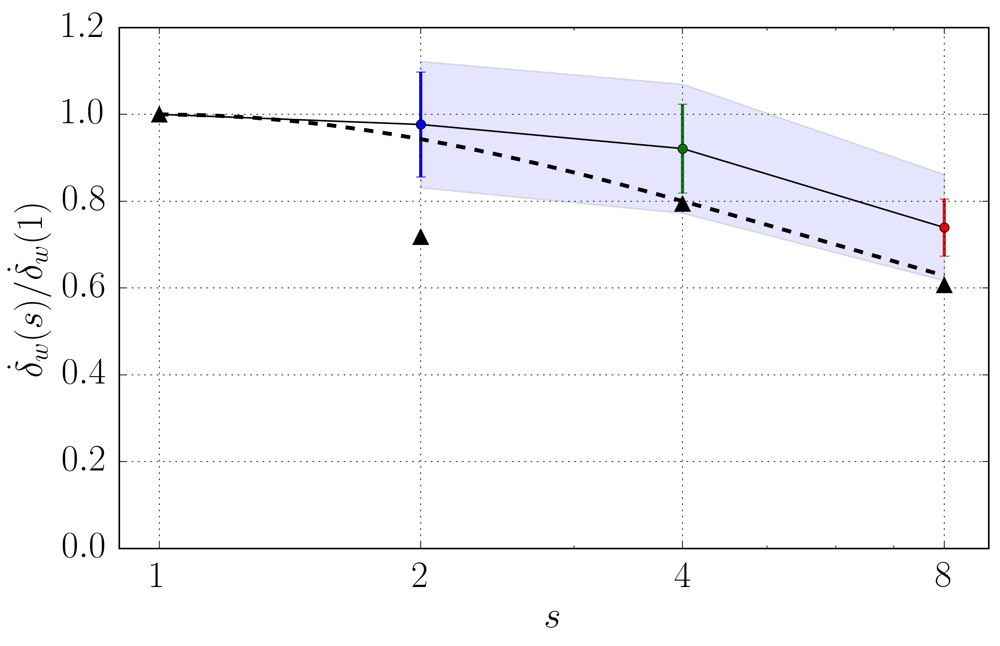

In [1328]:
#pantanodotdm=[[1.0,2,4,8.0],[1.0,0.668,0.569,0.367]]
vectors=np.array([1,2,4,8])
vectors2=np.linspace(1.0,8,50)
vratioDw=Dwcase/Dwcase[0]
ramshaw = 2*np.sqrt(vectors)/(vectors+1.0)
ramshaw2 = 2*np.sqrt(vectors2)/(vectors2+1.0)
#BandR = 0.5*(1+np.sqrt(1.0/vectors))
xlabel =r'$s$'
#ylabel =r'$\dot{\delta_m}(s)/\dot{\delta_m}(1)$ '
#ylabel =r'$C_\delta(s)/C_\delta(1)$ '
ylabel=r'$\dot{\delta}_w(s)/\dot{\delta}_w(1)$'
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
error =np.array(dmperrorcase[:])
f= np.array(dmpcase[:])
plt.plot(vectors,f*vratioDw,'k-')
#plt.scatter(7,0.72,marker='s',s=45,c='k')
plt.plot(vectors,fpant,'k^',ms=10)
#plt.fill_between(vectors, f-error, f+error,alpha=0.1)
plt.plot(vectors2,ramshaw2,'k--',lw=2.5)
#plt.plot(vectors,BandR,'k',lw=2.5,ls='dashed')
#plt.plot(pantanodotdm[0],pantanodotdm[1],'k--',lw=2.0)
#plt.plot([1.0,2.0,4.0,8.0],oneal,'r*',ms=8.0)
#plt.plot([1.0,2.0,4.0,8.0],onealP,'ks',ms=6.0)
#plt.plot(1,1,'ko',ms=10.0)
#plt.plot([2.0,4.0,8.0],[dmp[1]/dmp[0], dmp[2]/dmp[0],dmp[3]/dmp[0]],'rv',ms=12.0)
#plt.plot([1.0, 2.0,4.0,8.0],[1.0,dmp[1]/dmp[0], dmp[2]/dmp[0],dmp[3]/dmp[0]],'r-')
#f= np.array(dmpcase[:])
plt.fill_between(vectors[1:], f[1:]*vratioDw[1:]-error[1:]*vratioDw[1:],f[1:]*vratioDw[1:]+error[1:]*vratioDw[1:],alpha=0.1)
PRINT=False
for icase in range(1,ncases):
    ax.errorbar(vectors[icase],f[icase]*vratioDw[icase],yerr=error[icase],marker='.',mfc=l_case_color[icase], \
                ms=10.0,fmt='o',color=l_case_color[icase],lw=2.0)
    ax.plot(vectors[icase],f[icase]*vratioDw[icase],'o')
plt.xlabel(xlabel)
plt.ylim([0.0,1.2])
plt.xlim([0.9,9])
plt.ylabel(ylabel)
#ax.set_xscale('log')
ax.set_xscale('log')
ax.set_xticks([1,2, 4, 8])
ax.get_xaxis().set_major_formatter(plt.matplotlib.ticker.ScalarFormatter())
plt.grid('on')
if PRINT == True:
    print PRINT
    print pathname
    pathname = save_folder + 'Ramshaw_comparition' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    pathname = save_folder + 'Ramshaw_comparition' + '.pdf'
    fig.savefig(pathname,bbox_inches='tight')

# $\eta$

In [1329]:
variable = 'etamin'
variable2 = 'dyeta'
variable2 = 'eta'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\Delta x_i / \eta$'
figname = 'etavstime_ave'
PRINT = True
tmax=1000

Dx = 0.300325732899
figure saved!


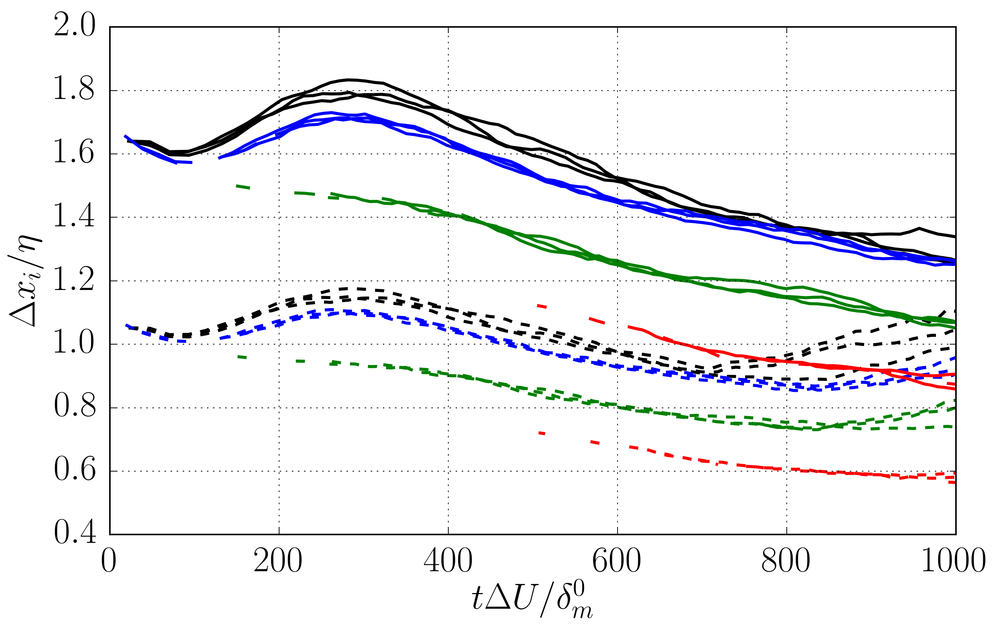

In [1330]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
Dx = 461.0/(1535)
print "Dx = %s"%Dx
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = f['time'];
        fun = np.array(f[variable])
        f1 = Dx/fun
        fun2 = np.array(f[variable2])
        y=np.array(f['y'])
        f2=np.zeros(len(time))
        for itime in range(len(time)):
            f2[itime] = np.max(np.diff(y)/fun2[1:,itime])
        #f2 = np.max(fun2,axis=0)
        tmaxjob[ijob] = np.max(time)
        plt.plot(time ,f1,l_job_style[ijob/3],lw=2.0)
        plt.plot(time ,f2,l_job_style[ijob/3],ls='dashed',lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([0,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + 'Relambdavstime_ave' + fformat
    fig.savefig(pathname,bbox_inches='tight')


In [605]:
variable = 'etamin'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\eta$'
figname = 'etavstime_ave'
PRINT = True

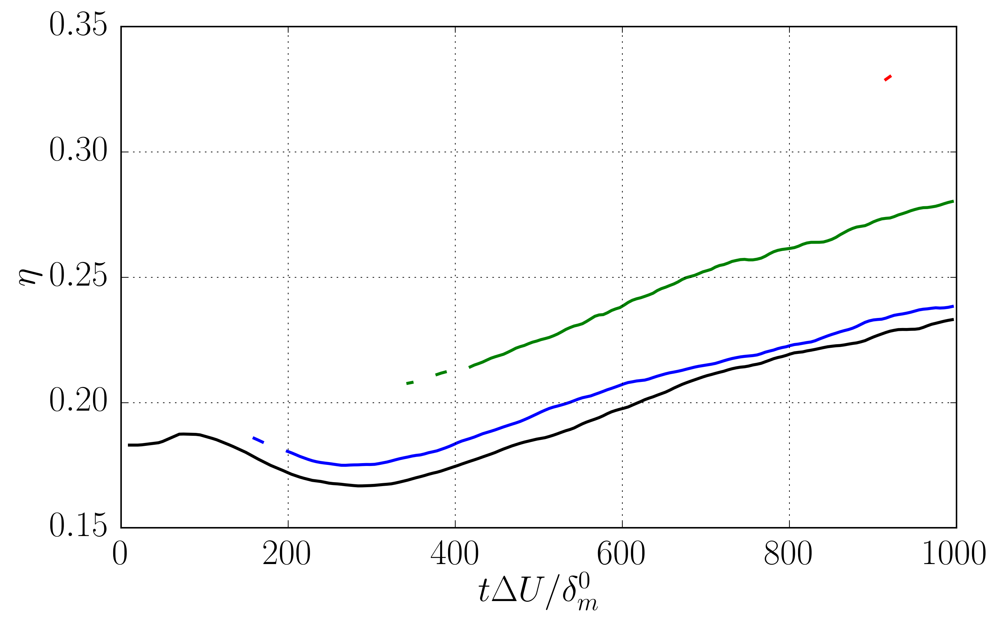

In [606]:
#Preparing plot
tmin=10
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
for icase in range(ncases):
    #ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    ilim=-1
    plt.plot(vtcases[icase][0:ilim],vfcases[icase][0:ilim],l_job_style[icase],lw=2.0)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')


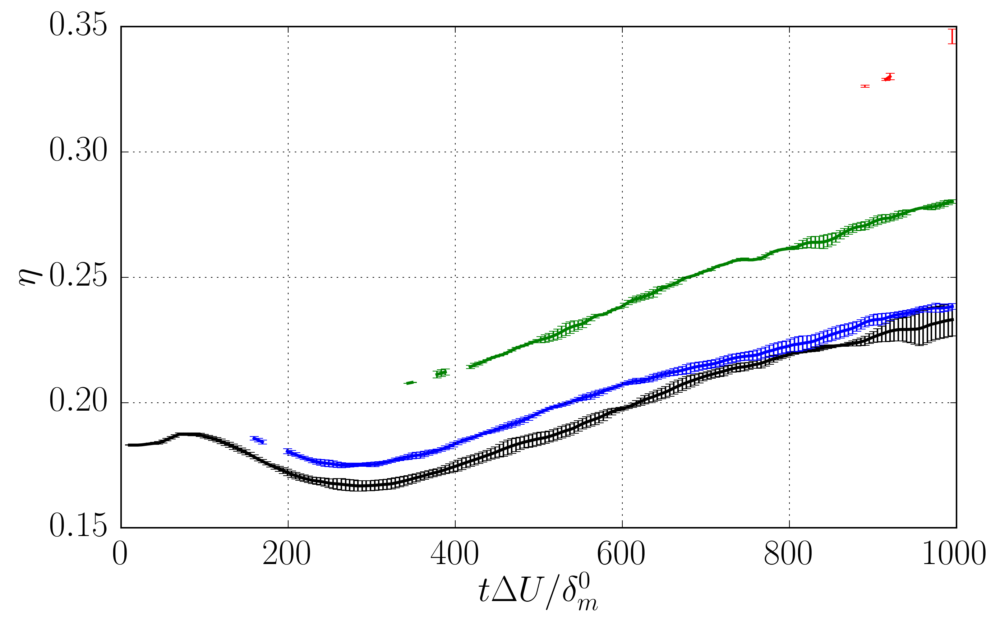

In [607]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
for icase in range(ncases):
    #ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    ilim = -1
    plt.plot(vtcases[icase][0:ilim],vfcases[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([0,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(ncases):
        #ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
        ilim=-1
        plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')


## $Re_\lambda$

In [509]:
variable = 'Relambda'
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$Re_{\lambda}$'
figname = 'Relvstime_ave'
PRINT = True

In [510]:
print tmaxcases

[1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 990.0, 990.0, 858.0]


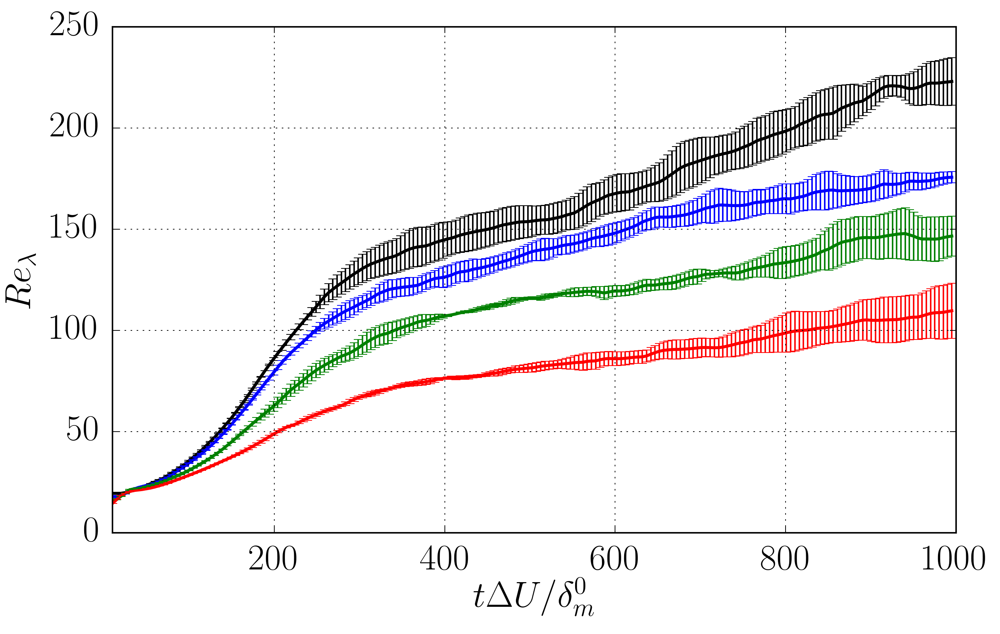

In [514]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#time_int = np.linspace(tmin,tmax,Npoints)
vtcases,vfcases,stddcases = fcaseintime(p_folders,lcases,variable,tmin,tmax)
for icase in range(ncases):
    #ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
    ilim=-1
    plt.plot(vtcases[icase][0:ilim],vfcases[icase][0:ilim],l_job_style[icase],lw=2.0)
    #plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,0.01])
ax.set_xlim([tmin,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(ncases):
        #ilim = where(vtcases[icase]>tmaxcases[icase])[0][0]
        plt.errorbar(vtcases[icase][0:ilim],vfcases[icase][0:ilim],yerr=stddcases[icase][0:ilim],color=l_job_color[icase])
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')


In [515]:
print SS1,SS2

[920, 980, 720, 920, 850, 800, 750, 780, 820, 800, 800, 800] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 990.0, 990.0, 858.0]


figure saved!


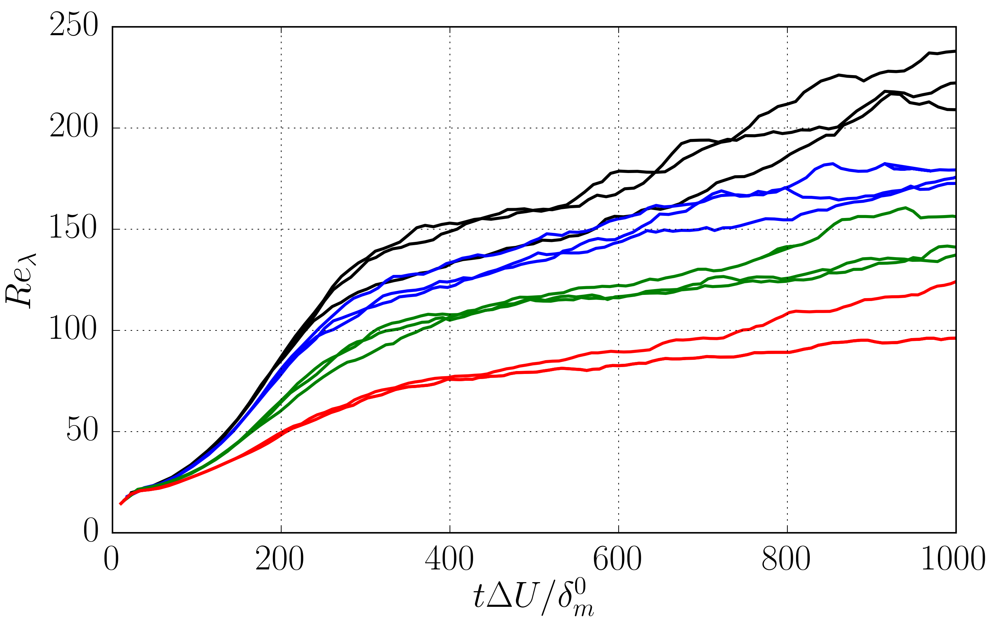

In [516]:
#Preparing plot
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
#Plot all jobs in the same graph
#time_int = np.linspace(tmin,tmax,Npoints)
tmaxjob = [0 for i in range(njobs)]
for ijob in range(njobs):
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time = f['time'];
        fun = f[variable] 
        tmaxjob[ijob] = np.max(time)
        plt.plot(time ,fun,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time_int,fun_ave2[case],l_job_style[case],lw=2.0,ls='dashed')
    #ax.fill_between(time_int, fun_ave[case], fun_ave2[case], where=fun_ave[case]>=fun_ave2[case], facecolor=l_job_color[case],alpha=0.2, interpolate=False)
    #ax.fill_between(time_int, 0, fun_ave2[case], where=fun_ave2[case]>0, facecolor=l_job_color[case],alpha=0.5, interpolate=False)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
#ax.set_ylim([0,7.0])
ax.set_xlim([0,tmax])
plt.grid('on')
#SAVING
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + 'Relambdavstime_ave' + fformat
    fig.savefig(pathname,bbox_inches='tight')


In [517]:
print Dwcase

[4.1978760999656197, 5.0482432475006975, 6.1171739579440061, 7.6381147884767318]


# AVAREGED PROFILES

In [1331]:
import scipy.io as sio

In [1332]:
UselfRM =np.loadtxt('/data2/toni/work/db/uselfRogersMoser.dat');
ums20pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s20.dat');
ums40pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s40.dat');
ums80pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_umean_s80.dat');
rhos20pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s20.dat');
rhos40pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s40.dat');
rhos80pantano = np.loadtxt('/data2/toni/work/db/Pantano2002_rhomean_s80.dat');
R12s1pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos1.dat');
R12s2pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos2.dat');
R12s4pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos4.dat');
R12s8pantano=np.loadtxt('/share/drive/toni/python/R12Pantanos8.dat');
urmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u1.dat')
vrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u2.dat')
wrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u3.dat')
uvrmsRM = np.loadtxt('/data2/toni/work/db/rogermoser1994u12.dat')
                    

In [1333]:
yshiftPANTu=[0.0,0.12,0.24,0.423]

In [1334]:
s80=sio.loadmat('/home/toni/fields/VDML_JFM/SSphys2_s8.mat')
s40=sio.loadmat('/home/toni/fields/VDML_JFM/SSphys2_s4.mat')
s20=sio.loadmat('/home/toni/fields/VDML_JFM/SSphys2_s2.mat')
s10=sio.loadmat('/home/toni/fields/VDML_JFM/SSphys2_s1.mat')

### Calculating first and last file to average for each job

In [1335]:
print SS1,SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


$\delta_m(t) = \frac{1}{\rho_0 \Delta U^2} \int_{-\infty}^\infty {\overline{ \rho } \left( 
\frac{1}{2}  \Delta U - \tilde{u} \right) \left( \frac{1}{2}  \Delta U + \tilde{u} \right) dy}$

# TESTING

In [1336]:
import compact


## Gradients 

In [1337]:
variable = 'rum' #any vector variable available
scaling  = 'dm' #can be dw or dm
ylabel =r'$-\frac{\partial{\tilde{u}}}{\partial{y}} \frac{\delta_m}{\Delta U} $'
#figname = 'rhom_ave.eps'
figname = 'dufdy_ave_dm'
derivative = True
Print=True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
icase = 0
-1.00001454183
icase = 1
-1.00001186771
icase = 2
-1.00001456913
icase = 3
-1.00001434701
figure /share/drive/toni/VDML/JFM/dufdy_ave_dm.pdf saved!
figure /share/drive/toni/VDML/JFM/dufdy_ave_dmstd.pdf saved!


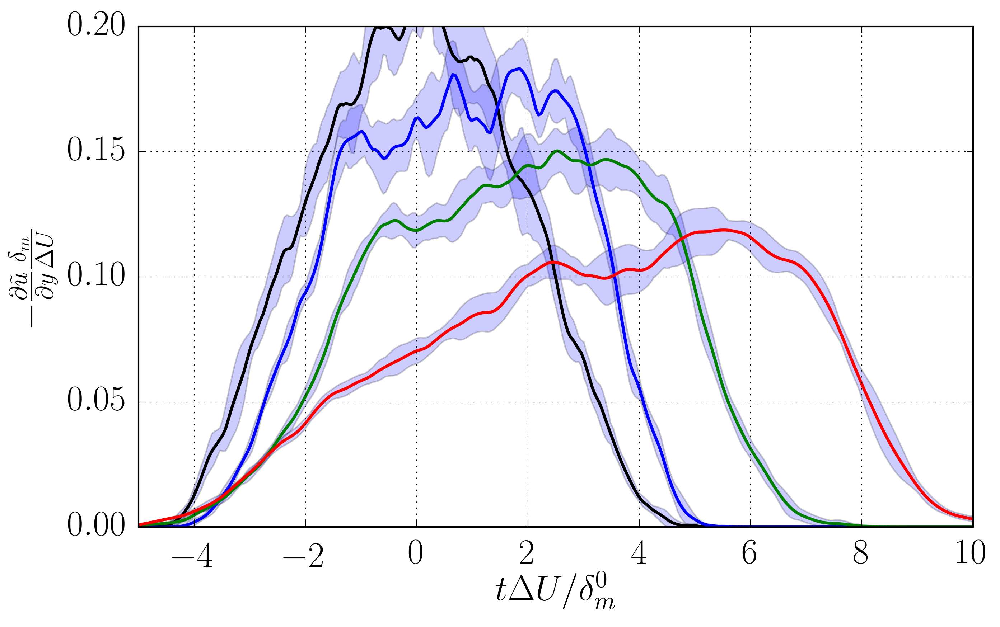

In [1338]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-5,10])
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.ylim([0.0,0.2])
plt.grid('on')
for icase in range(len(lcases)):
    print "icase = %s" %icase
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],-fSS[icase],l_job_style[icase],lw=2)
    print np.trapz(fSS[icase],ycases[icase][0])
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
#SAVING
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!"%pathname
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!"%pathname


In [1339]:
variable = 'rum' #any vector variable available
scaling  = 'dw' #can be dw or dm
ylabel =r'$-\frac{\partial{\tilde{u}}}{\partial{y}} \frac{\delta_w}{\Delta U} $'
#figname = 'rhom_ave.eps'
figname = 'DUmdy_ave_dw'
derivative = True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
icase = 0
-1.00001522746
icase = 1
-1.00001647385
icase = 2
-1.00001279666
icase = 3
-1.00001174787
figure /share/drive/toni/VDML/JFM/DUmdy_ave_dw.pdf saved!


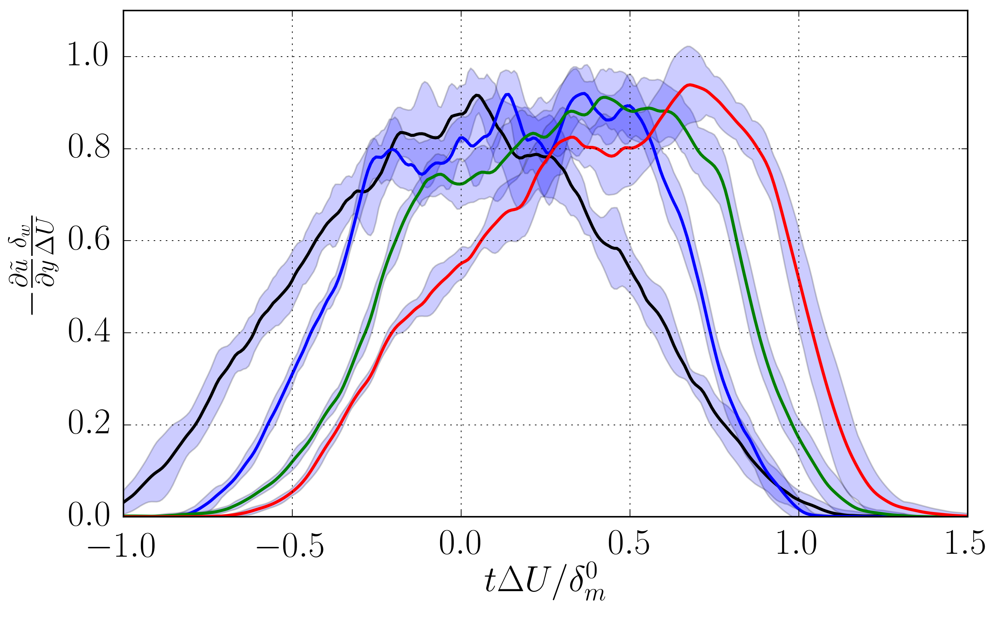

In [1340]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-5,10])
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.ylim([0.0,1.1])
plt.grid('on')
for icase in range(len(lcases)):
    print "icase = %s" %icase
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],-fSS[icase],l_job_style[icase],lw=2)
    print np.trapz(fSS[icase],ycases[icase][0])
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
#SAVING
if PRINT == True:

    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!"%pathname
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')


# $Re_\lambda$

In [1341]:
variable = 'Relambday' #any vector variable available
scaling  = 'dm' #can be dw or dm
xlabel =r'$y/\delta_m$'
ylabel =r'$Re_{\lambda} $'
#figname = 'rhom_ave.eps'
figname = 'Relambday_ave'

figure saved!


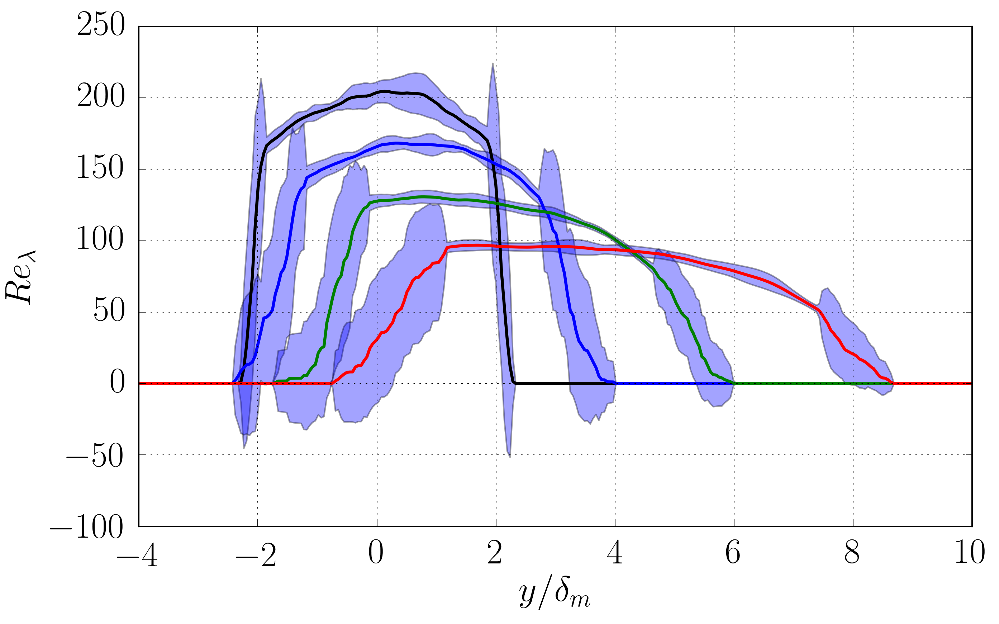

In [1342]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-4,10])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $\overline{\rho}$

In [1343]:
variable = 'rhom' #any vector variable available
variable2 = 'vm' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\overline{\rho}$,$500\overline{v}$'
#ylabel = r"y"
#figname = 'rhom_ave.eps'
figname = 'rhomvmave_dw'
derivative = False
PRINT = False

For icase=0, vmint=0.0
0.0
For icase=1, vmint=0.000159198398624
-2.27700638844e-05
For icase=2, vmint=0.000780143373606
0.000218021343264
For icase=3, vmint=0.00181910497138
0.000987781850668


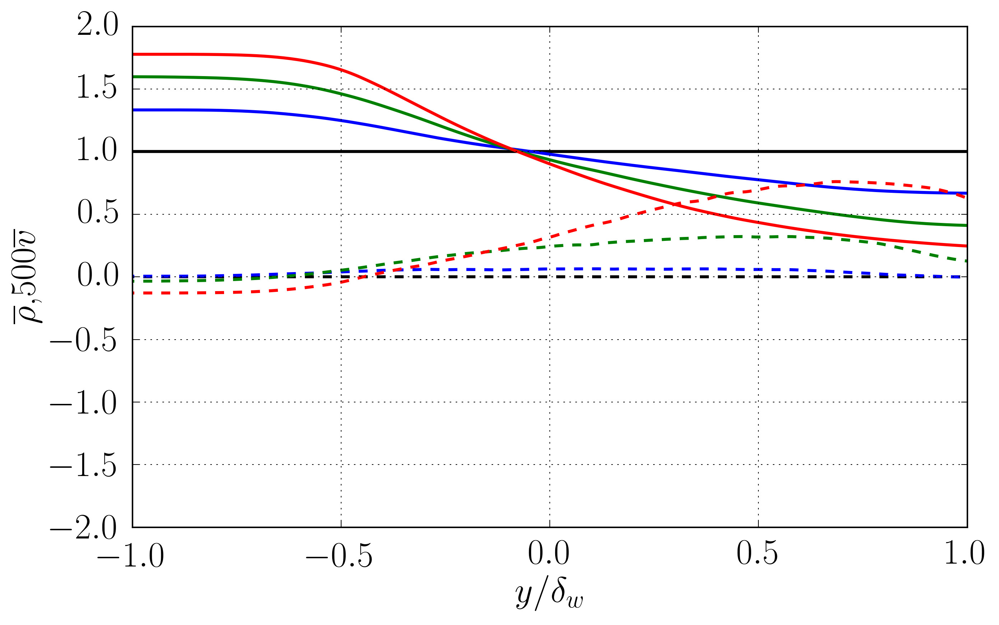

In [1344]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2)
ycases2,fSS2,errorSS2 = getSScase2(p_folders,lcases,variable2,scaling,SS1,SS2)

fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1])
plt.ylim([-2,2])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    plt.plot(ycases2[icase][0],500*fSS2[icase],l_job_style[icase],lw=2.0,ls='dashed')
    vmint = np.trapz(fSS2[icase],ycases2[icase][0])
    print "For icase=%s, vmint=%s"%(icase,vmint)
    print fSS2[icase][-1]-fSS2[icase][0]
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

In [1345]:
variable = 'rhom' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$(\overline{\rho}-\rho_{min})/{\Delta \rho}$'
#ylabel = r"y"
#figname = 'rhom_ave.eps'
figname = 'rhomave_dw'
derivative = False

integral of rhomean is 4.0 
nan
integral of rhomean is 3.99870899728 
1.99806344882
integral of rhomean is 3.99622873442 
1.99685725387
integral of rhomean is 3.99492855694 
1.99673976706


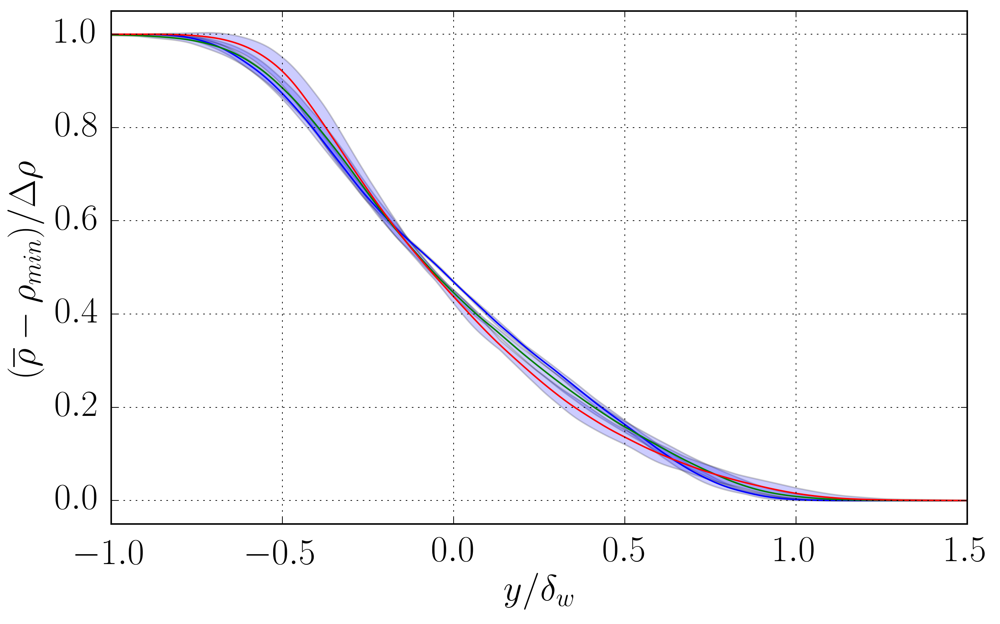

In [1346]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel,rotation='vertical');
if scaling=='dm':
    plt.xlim([-5,8])
else:
    plt.xlim([-1,1.5])
plt.ylim([-0.05,1.05])
plt.grid('on')
sigma = 1.5
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    print "integral of rhomean is %s " %np.trapz(fSS[icase],ycases[icase][0])
    Drho = np.max(fSS[icase])-np.min(fSS[icase])
    fSS[icase]=fSS[icase]/Drho-np.min(fSS[icase])/Drho
    print np.trapz(fSS[icase],ycases[icase][0])
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=1.0)
    plt.fill_between(ycases[icase][0], fSS[icase]-sigma*errorSS[icase], fSS[icase]+sigma*errorSS[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

In [1347]:
yshiftPANTrho=[0.0,-0.15,-0.1,-0.12]

## Gradients 

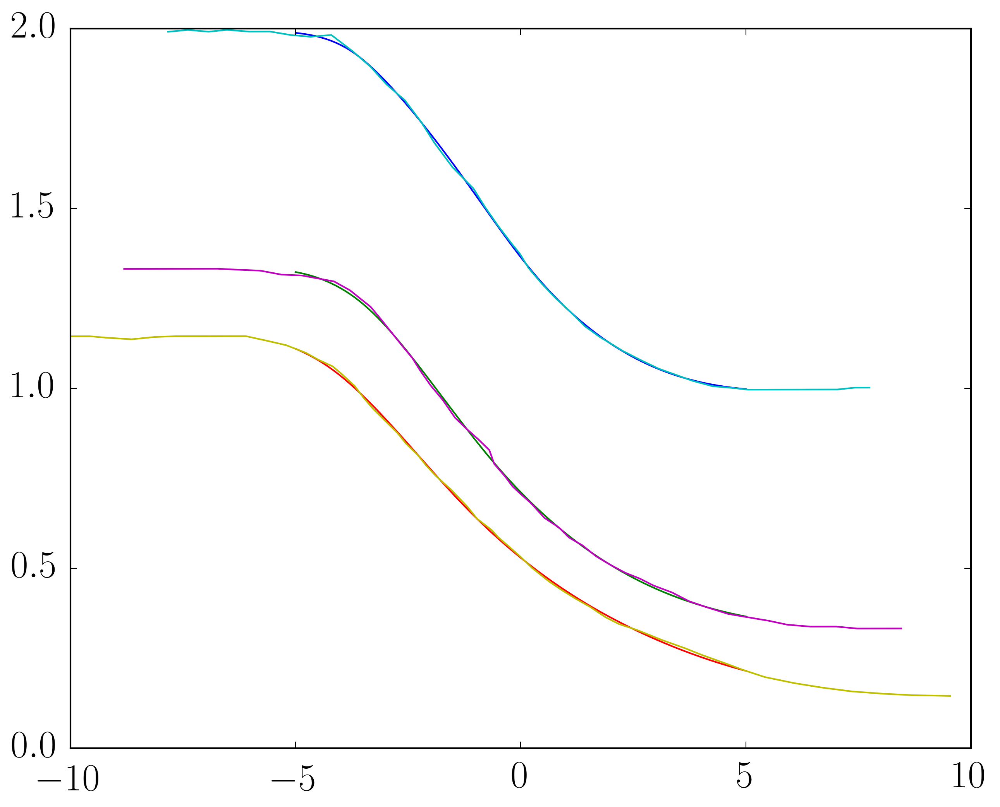

In [1348]:
from scipy import interpolate
yxi2 = np.linspace(-5,5,100)
tck = interpolate.splrep(rhos20pantano[:,0],rhos20pantano[:,1]/(rhos20pantano[:,1].max()-rhos20pantano[:,1].min()),s=0.001)
rhos20 = interpolate.splev(yxi2,tck,der=0)
derrhos20 = interpolate.splev(yxi2,tck,der=1)
tck = interpolate.splrep(rhos40pantano[:,0],rhos40pantano[:,1]/(rhos40pantano[:,1].max()-rhos40pantano[:,1].min()),s=0.002)
rhos40 = interpolate.splev(yxi2,tck,der=0)
derrhos40 = interpolate.splev(yxi2,tck,der=1)
tck = interpolate.splrep(rhos80pantano[:,0],rhos80pantano[:,1]/(rhos80pantano[:,1].max()-rhos80pantano[:,1].min()),s=0.001)
rhos80 = interpolate.splev(yxi2,tck,der=0)
derrhos80 = interpolate.splev(yxi2,tck,der=1)
plt.plot(yxi2,rhos20,yxi2,rhos40,yxi2,rhos80)
plt.plot(rhos20pantano[:,0],rhos20pantano[:,1]/(rhos20pantano[:,1].max()-rhos20pantano[:,1].min()), \
         rhos40pantano[:,0],rhos40pantano[:,1]/(rhos40pantano[:,1].max()-rhos40pantano[:,1].min()), \
         rhos80pantano[:,0],rhos80pantano[:,1]/(rhos80pantano[:,1].max()-rhos80pantano[:,1].min()))

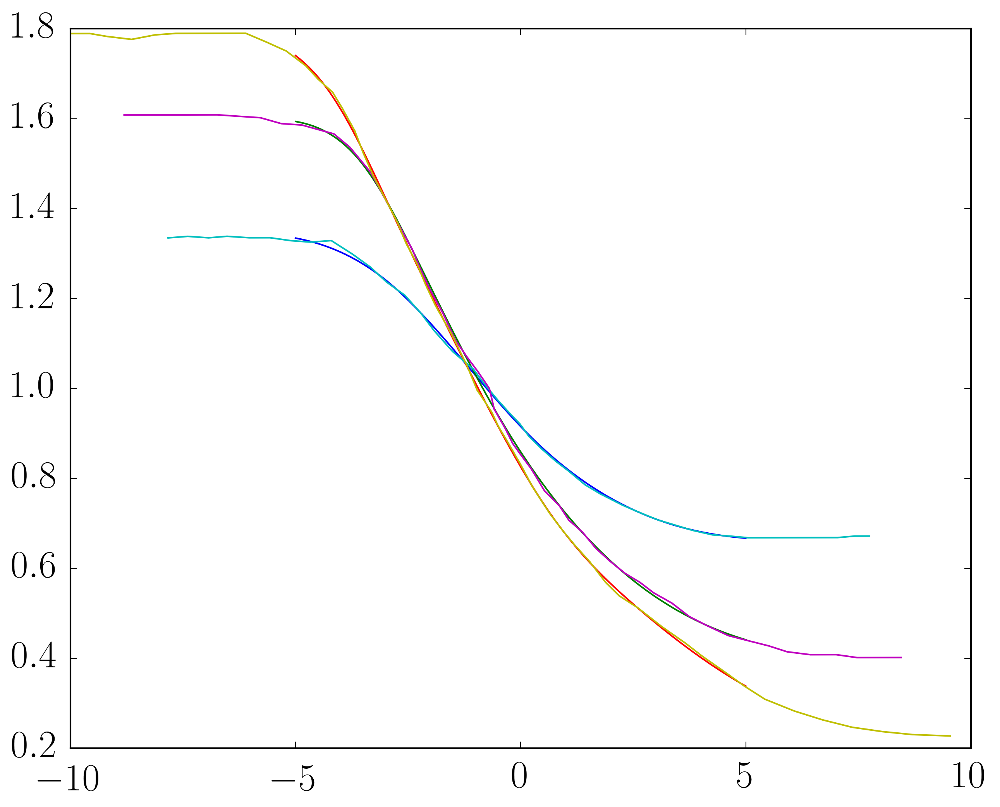

In [1349]:
from scipy import interpolate
yxi2 = np.linspace(-5,5,100)
tck = interpolate.splrep(rhos20pantano[:,0],rhos20pantano[:,1],s=0.001)
rhos20 = interpolate.splev(yxi2,tck,der=0)
derrhos20 = interpolate.splev(yxi2,tck,der=1)
tck = interpolate.splrep(rhos40pantano[:,0],rhos40pantano[:,1],s=0.002)
rhos40 = interpolate.splev(yxi2,tck,der=0)
derrhos40 = interpolate.splev(yxi2,tck,der=1)
tck = interpolate.splrep(rhos80pantano[:,0],rhos80pantano[:,1],s=0.001)
rhos80 = interpolate.splev(yxi2,tck,der=0)
derrhos80 = interpolate.splev(yxi2,tck,der=1)
plt.plot(yxi2,rhos20,yxi2,rhos40,yxi2,rhos80)
plt.plot(rhos20pantano[:,0],rhos20pantano[:,1], \
         rhos40pantano[:,0],rhos40pantano[:,1], \
         rhos80pantano[:,0],rhos80pantano[:,1])

In [1350]:
variable = 'rhom' #any vector variable available
scaling  = 'dm' #can be dw or dm
ylabel =r'$-\frac{\partial{\overline{\rho}}}{\partial{y}} \frac{\delta_m}{\Delta \rho} $'
#figname = 'rhom_ave.eps'
xlabel=r'$y/\delta_m$'
figname = 'drhomdy_ave'
derivative = True
print l_job_color

['k', 'b', 'g', 'r']


Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling


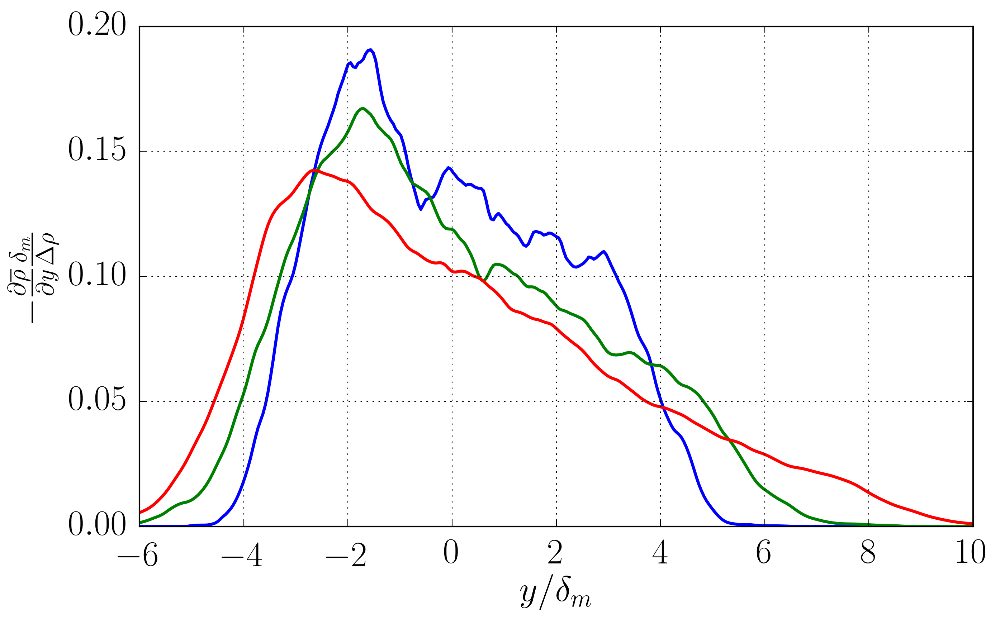

In [1351]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
ycases2,rhoSS,errorrhoSS = getSScase2(p_folders,lcases,'rhom',scaling,SS1,SS2,500,False)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.grid('on')
plt.ylim([0.0,0.2])
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    Drho = np.max(rhoSS[icase])-np.min(rhoSS[icase])
    fSS[icase]=fSS[icase]/Drho
    errorSS[icase] = errorSS[icase]/Drho
    plt.plot(ycases[icase][0],-fSS[icase],l_job_style[icase],lw=2.0)
    #plt.plot(yxi2,-derrhos20,'b.',markevery=3)
    #plt.plot(yxi2,-derrhos40,'g.',markevery=3)
    #plt.plot(yxi2,-derrhos80,'r.',markevery=3)
    #plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname

In [1352]:
variable = 'rhom' #any vector variable available
scaling  = 'dw' #can be dw or dm
ylabel =r'$-\frac{\partial{\overline{\rho}}}{\partial{y}} \frac{\delta_w}{\Delta \rho} $'
xlabel=r'$y/\delta_w$'
#figname = 'rhom_ave.eps'
figname = 'drhomdy_ave_dw'
derivative = True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling


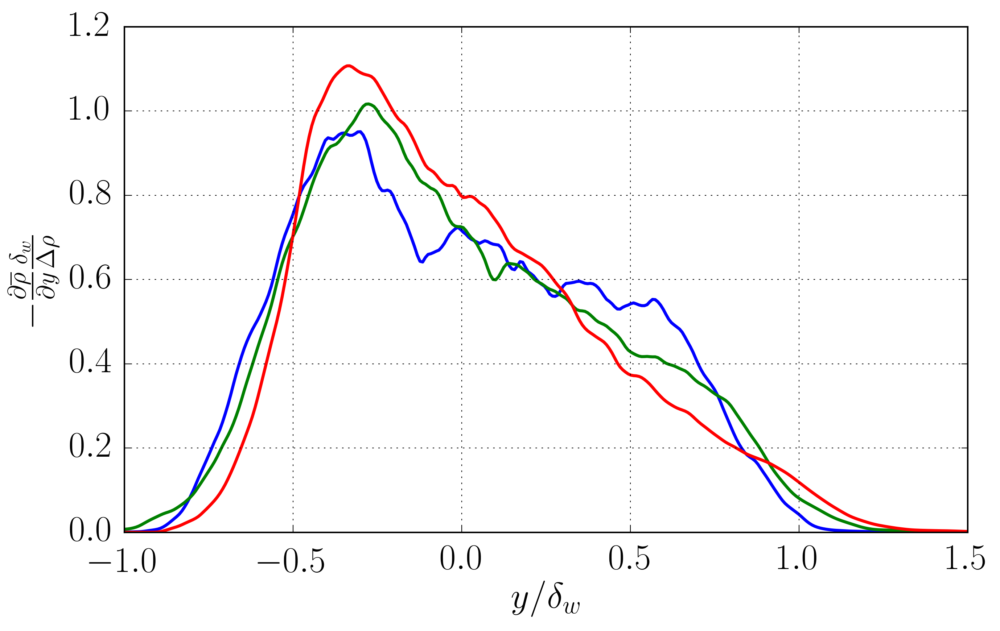

In [1353]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative)
ycases2,rhoSS,errorrhoSS = getSScase2(p_folders,lcases,'rhom',scaling,SS1,SS2,500,False)
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.ylim([0.0,1.2])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    Drho = np.max(rhoSS[icase])-np.min(rhoSS[icase])
    fSS[icase]=fSS[icase]/Drho
    errorSS[icase] = errorSS[icase]/Drho
    plt.plot(ycases[icase][0],-fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #Save with STD
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

### $\partial U(y)/ \partial y$

In [1354]:
variable = 'w3m' #any vector variable available
scaling  = 'dm' #can be dw or dm
xlabel =r'$y/\delta_m$'
#ylabel =r'$\overline{\omega_z} \delta_m/\Delta U$'
ylabel =r'$-\frac{\partial \overline{U}}{\partial y} \frac{\delta_m}{\Delta U}$'
#figname ='w3m_ave.eps'
figname ='w3m_ave'
#PRINT = True
derivative=False

Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling


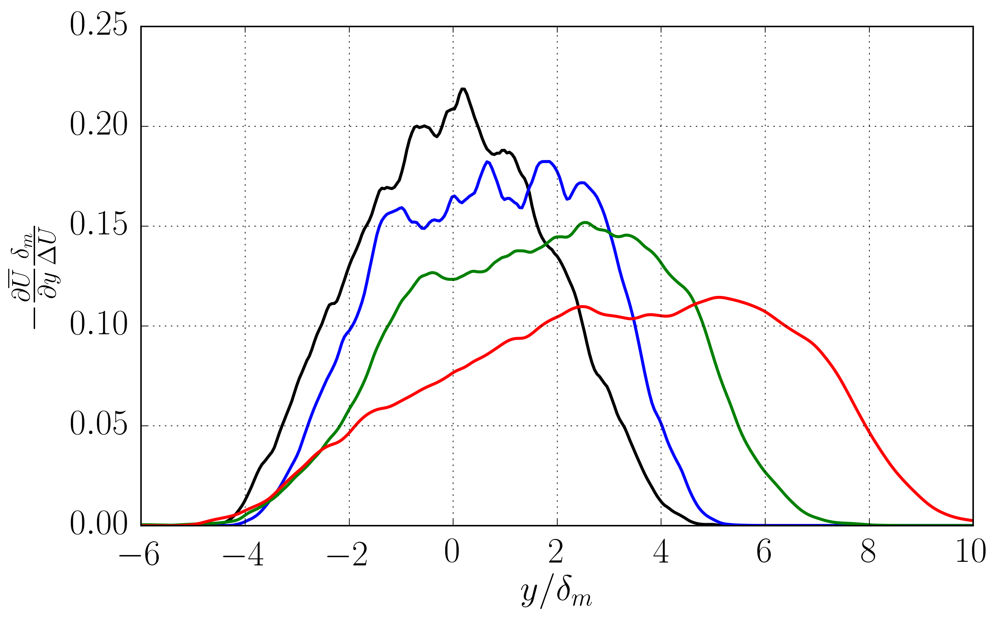

In [1355]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
plt.ylim([0.0,0.25])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    

In [1356]:
variable = 'w3m' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\overline{\omega_z} \delta_w/\Delta U$'
#figname ='w3m_ave.eps'
figname ='w3m_ave_dw'
#PRINT = True
derivative=False

Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling


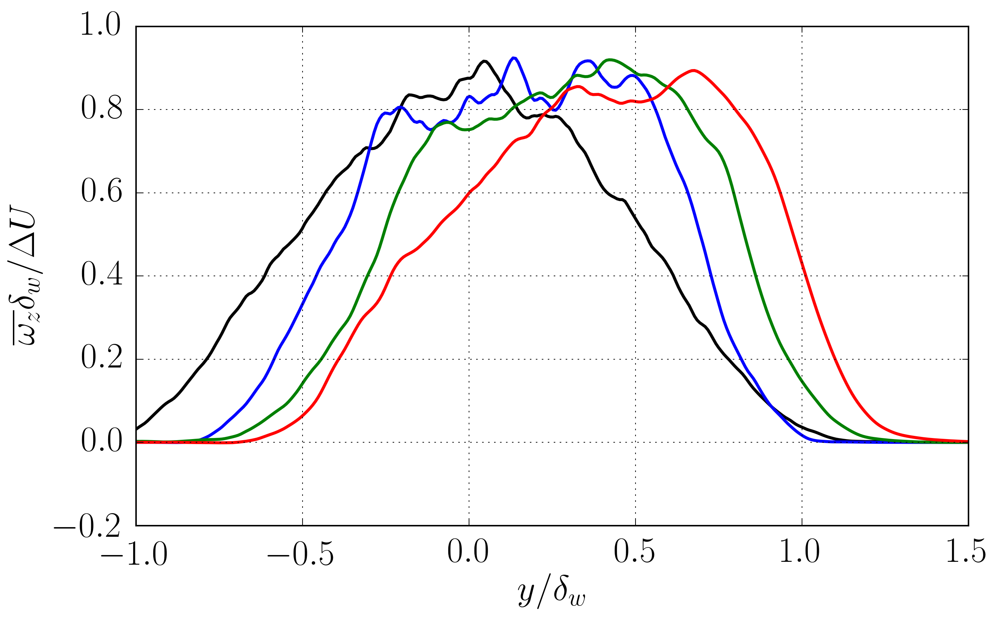

In [1357]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1.5])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $\varepsilon(y)$

In [1358]:
variable = 'epR' #any vector variable available
scaling  = 'dm' #can be dw or dm
xlabel =r'$y/\delta_m$'
ylabel =r'$\overline{\varepsilon}\delta_m/\Delta U^3$'
figname='epsy_ave.eps'
derivative = False
#figname='epsy_ave.eps'

Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling


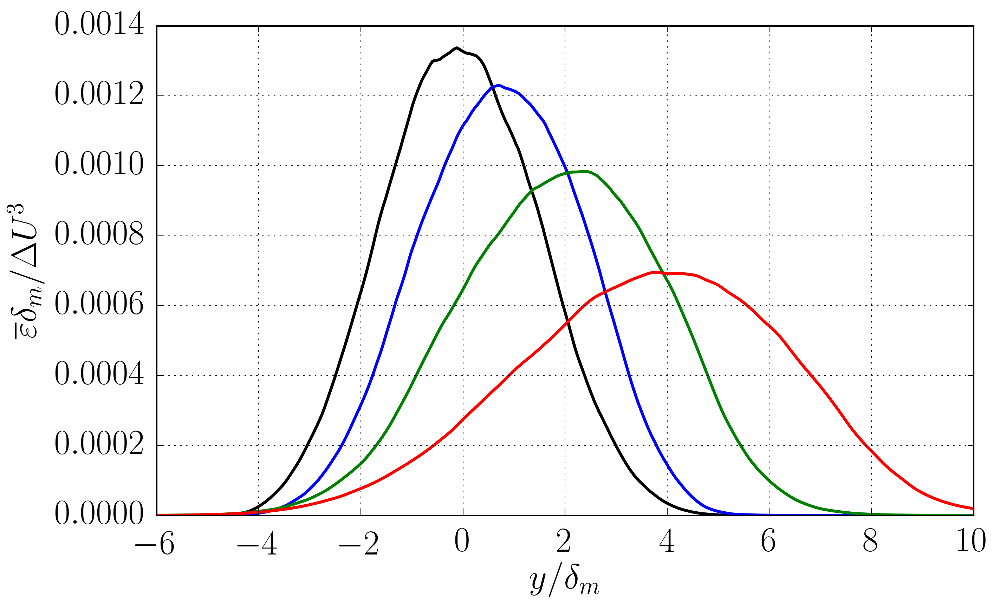

In [1359]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

In [1360]:
print SS1,SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


In [1361]:
variable = 'epR' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\overline{\varepsilon}\delta_w/\Delta U^3$'
figname='epsy_ave_dw.eps'
derivative = False
#figname='epsy_ave.eps'

Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling
Multiplying by scaling


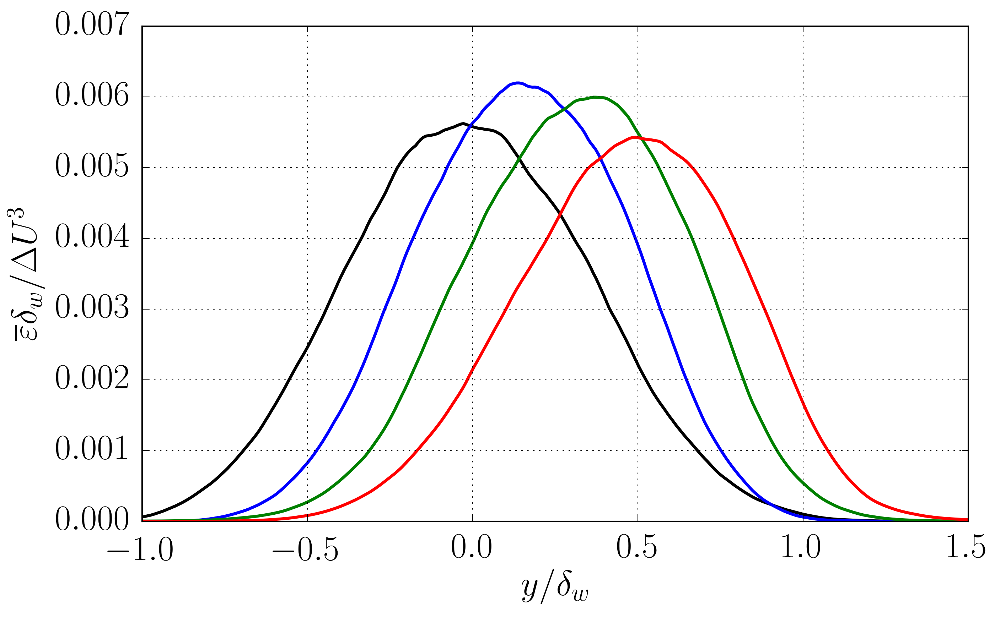

In [1362]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1.50])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $R_{ij} = \overline{\rho u_i'' u_j''}/\overline{\rho}$ (Reynolds Stresses)

In [1363]:
R11_1990=np.loadtxt('/data2/toni/work/db/R11_1990.dat');
R11_1994=np.loadtxt('/data2/toni/work/db/R11_1994.dat');
R11_1971=np.loadtxt('/data2/toni/work/db/R11_1971.dat');
R22_1990=np.loadtxt('/data2/toni/work/db/R22_1990.dat');
R22_1994=np.loadtxt('/data2/toni/work/db/R22_1994.dat');
R22_1971=np.loadtxt('/data2/toni/work/db/R22_1971.dat');
R33_1990=np.loadtxt('/data2/toni/work/db/R22_1990.dat');
R33_1994=np.loadtxt('/data2/toni/work/db/R22_1994.dat');
R33_1971=np.loadtxt('/data2/toni/work/db/R22_1971.dat');
R12_1990=np.loadtxt('/data2/toni/work/db/R12_1990.dat');
R12_1994=np.loadtxt('/data2/toni/work/db/R12_1994.dat');
R12_1971=np.loadtxt('/data2/toni/work/db/R12_1971.dat');
u1u1_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u1.dat');
u2u2_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u2.dat');
u3u3_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u3.dat');
u1u2_1994=np.loadtxt('/data2/toni/work/db/rogermoser1994u12.dat');

# k

In [1364]:
variable = 'k' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$k$'
figname ='k_ave_dw'
derivative = False
#figname ='urms_ave.eps'

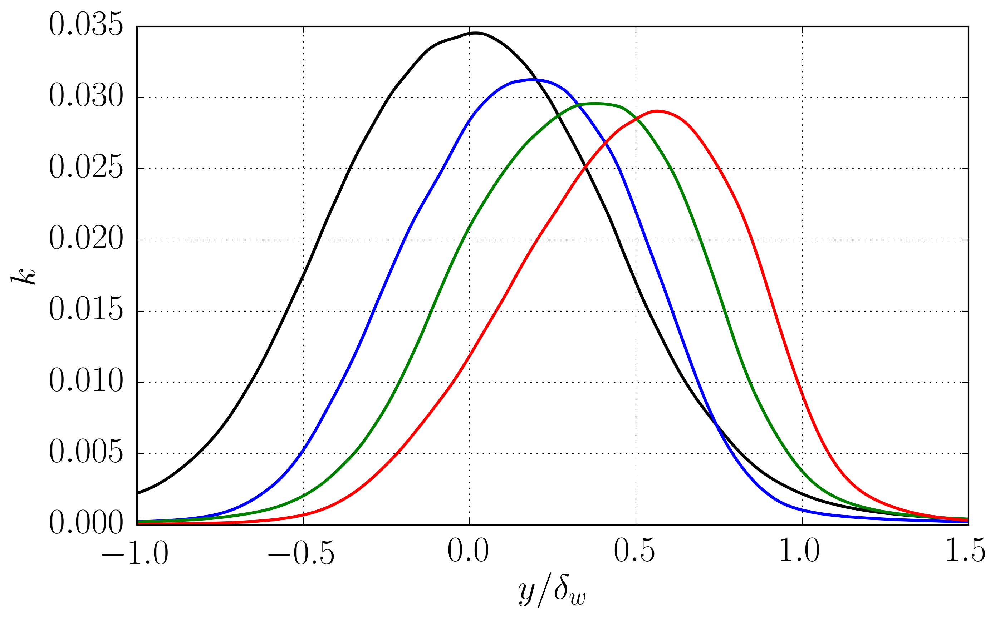

In [1365]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,8])
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $R_{11}$

In [1366]:
variable = 'R11' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$R_{11}/\Delta U^2$'
figname = 'R11_ave_dw'
#x.plot(R11_1994[:,0],R11_1994[:,1],'o',mec='blue',mfc='blue',ms = 9,label="Rogers \& Moser (1994)",alpha=0.5)
PRINT=True
derivative=False

figure saved!
figure /share/drive/toni/VDML/JFM/R11_ave_dw.pdf saved!
figure /share/drive/toni/VDML/JFM/R11_ave_dwstd.pdf saved!


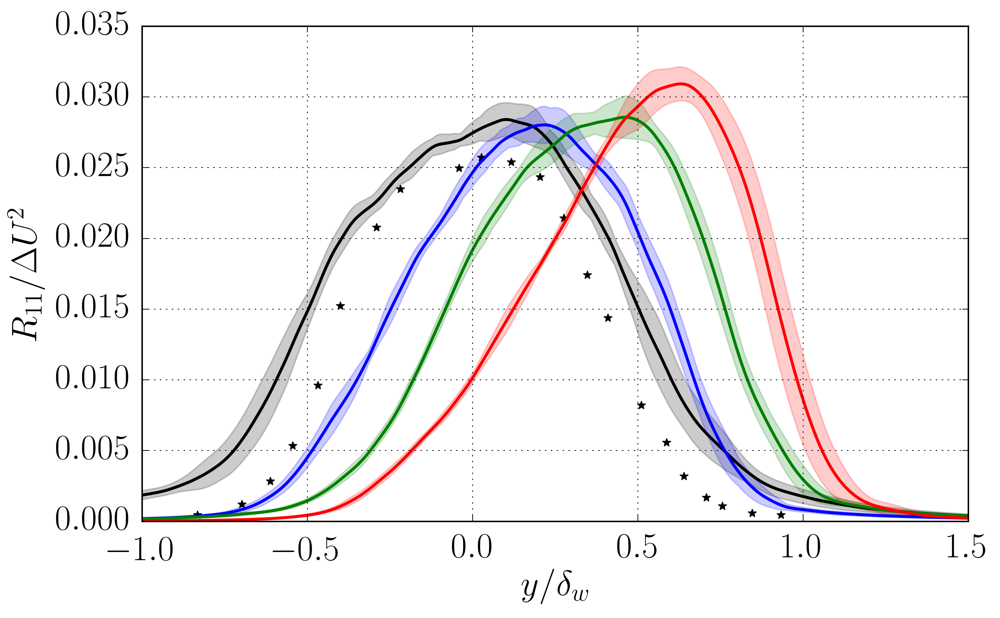

In [1367]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.plot(R11_1994[:,0],R11_1994[:,1]**2,'k*')
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.ylim([0.0,0.035])
plt.grid('on')
#plt.plot(R11_1994[:,0],(R11_1994[:,1])**2,'k*')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #for icase in range(len(lcases)):
        #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2

In [1368]:
variable = 'R11' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\sqrt{R_{11}}/\Delta U$'
figname = 'R11sqrt_ave_dw'
#x.plot(R11_1994[:,0],R11_1994[:,1],'o',mec='blue',mfc='blue',ms = 9,label="Rogers \& Moser (1994)",alpha=0.5)
PRINT=True
derivative=False

figure saved!
figure /share/drive/toni/VDML/JFM/R11sqrt_ave_dw.pdf saved!
figure /share/drive/toni/VDML/JFM/R11sqrt_ave_dwstd.pdf saved!


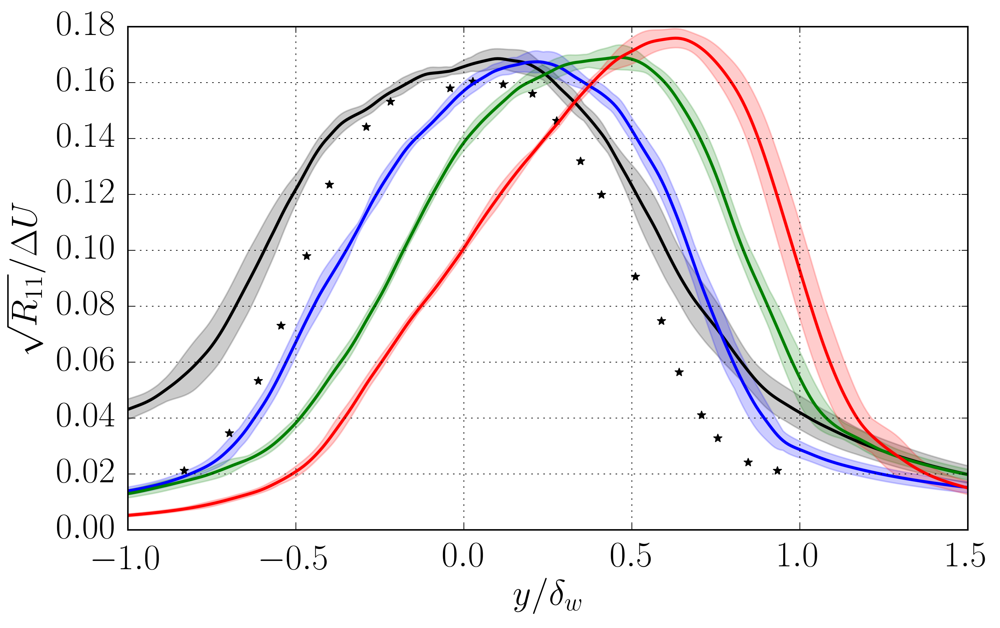

In [1369]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.grid('on')
plt.plot(R11_1994[:,0],R11_1994[:,1],'k*')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],np.sqrt(fSS[icase]),l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase])-0.5*errorSS[icase]*fSS[icase]**(-0.5), \
        np.sqrt(fSS[icase])+0.5*errorSS[icase]*fSS[icase]**(-0.5),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #for icase in range(len(lcases)):
        #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2

In [1370]:
variable = 'R22' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\sqrt{R_{22}}/\Delta U$'
figname = 'R22sqrt_ave_dw'
#x.plot(R11_1994[:,0],R11_1994[:,1],'o',mec='blue',mfc='blue',ms = 9,label="Rogers \& Moser (1994)",alpha=0.5)
PRINT=True
derivative=False

figure saved!
figure /share/drive/toni/VDML/JFM/R22_ave_dw.pdf saved!
figure /share/drive/toni/VDML/JFM/R22_ave_dwstd.pdf saved!


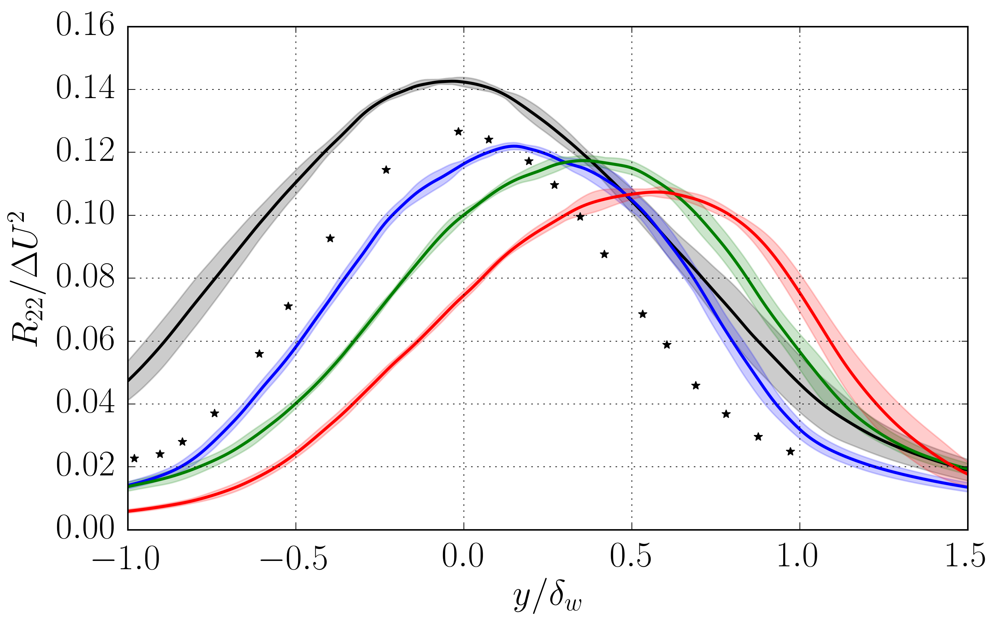

In [1375]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.plot(R22_1994[:,0],R22_1994[:,1],'k*')
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],np.sqrt(fSS[icase]),l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase])-0.5*errorSS[icase]*fSS[icase]**(-0.5), \
        np.sqrt(fSS[icase])+0.5*errorSS[icase]*fSS[icase]**(-0.5),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #for icase in range(len(lcases)):
        #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2

In [1376]:
print SS2

[1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


## $R_{22}$

In [1377]:
variable = 'R22' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$R_{22}/\Delta U^2$'
figname='R22_ave_dw'
derivative=False
#pathname = save_folder + 'R22_ave' + fformat

figure saved!
figure /share/drive/toni/VDML/JFM/R22_ave_dw.pdf saved!
figure /share/drive/toni/VDML/JFM/R22_ave_dwstd.pdf saved!


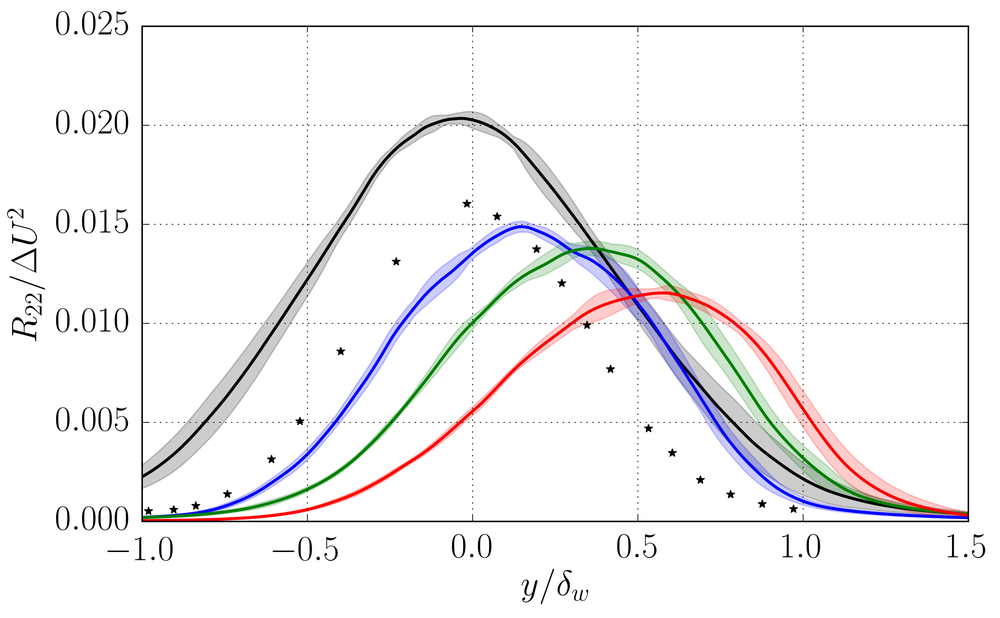

In [1378]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.plot(R22_1994[:,0],R22_1994[:,1]**2,'k*')
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #for icase in range(len(lcases)):
        #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2

In [1379]:
variable = 'R33' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$\sqrt{R_{33}}/\Delta U$'
figname='R33_ave_dw'
#pathname = save_folder + 'R22_ave' + fformat

figure saved!


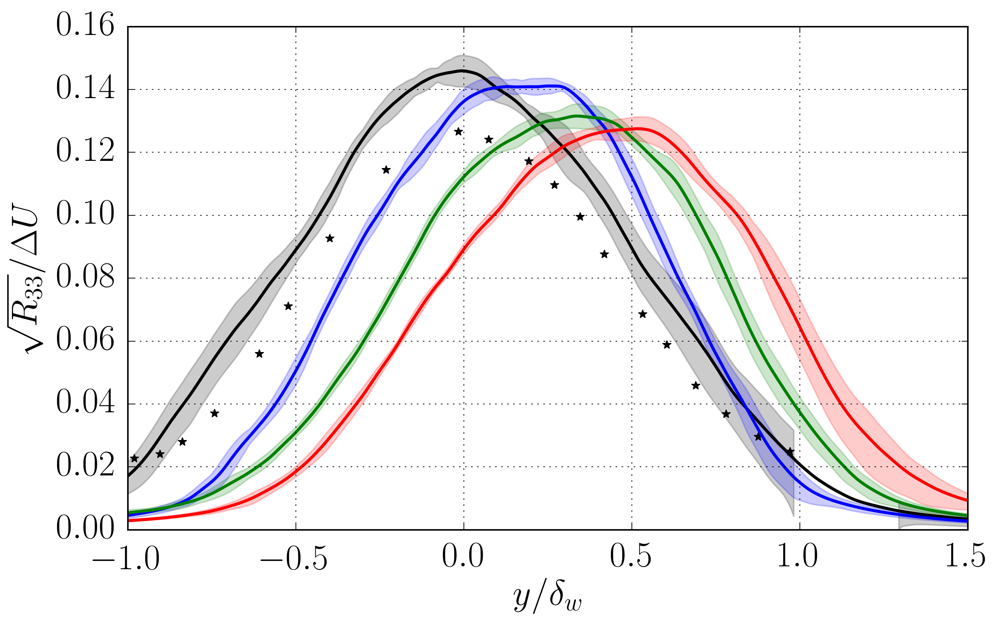

In [1380]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.grid('on')
plt.plot(R33_1994[:,0],R33_1994[:,1],'k*')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],np.sqrt(fSS[icase]),l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $R_{33}$

In [1381]:
variable = 'R33' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$R_{33}/\Delta U^2$'
figname = 'R33_ave_dw'
variable2='R22'

figure saved!


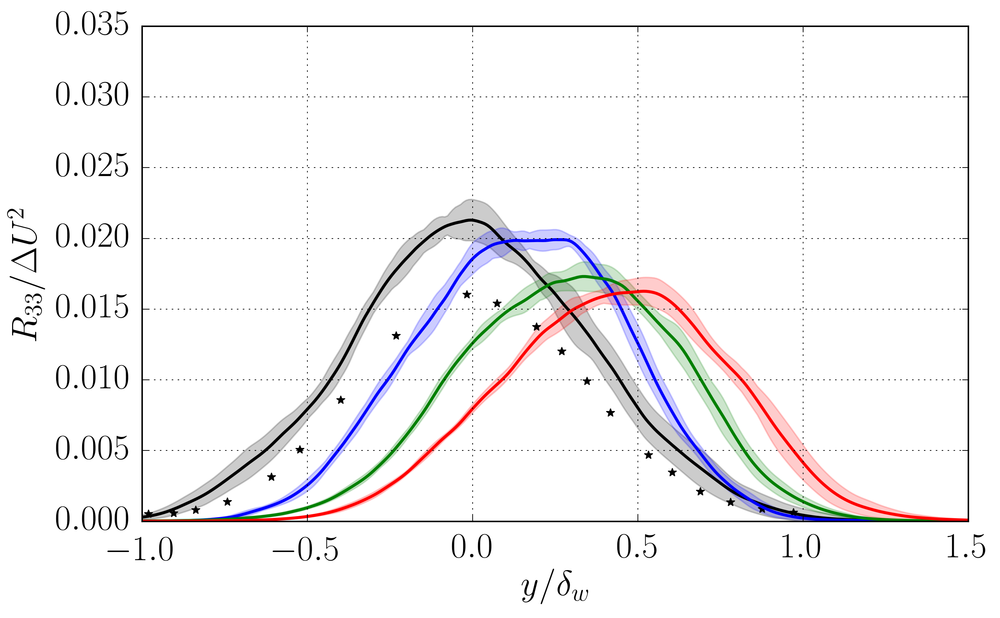

In [1382]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
#ycases2,fSS2,errorSS2 = getSScase2(p_folders,lcases,variable2,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.plot(R33_1994[:,0],R33_1994[:,1]**2,'k*')
plt.ylim([0.0,0.035])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.plot(ycases2[icase][0],fSS2[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

## $R_{12}$

In [1383]:
conv=dmtodwPant*5.0

In [1384]:
variable = 'R12' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r'$R_{12}/\Delta U^2$'
figname = 'R12_ave_dw'
PRINT=True

figure saved!
figure /share/drive/toni/VDML/JFM/R12_ave_dw.pdf saved!
figure /share/drive/toni/VDML/JFM/R12_ave_dwstd.pdf saved!


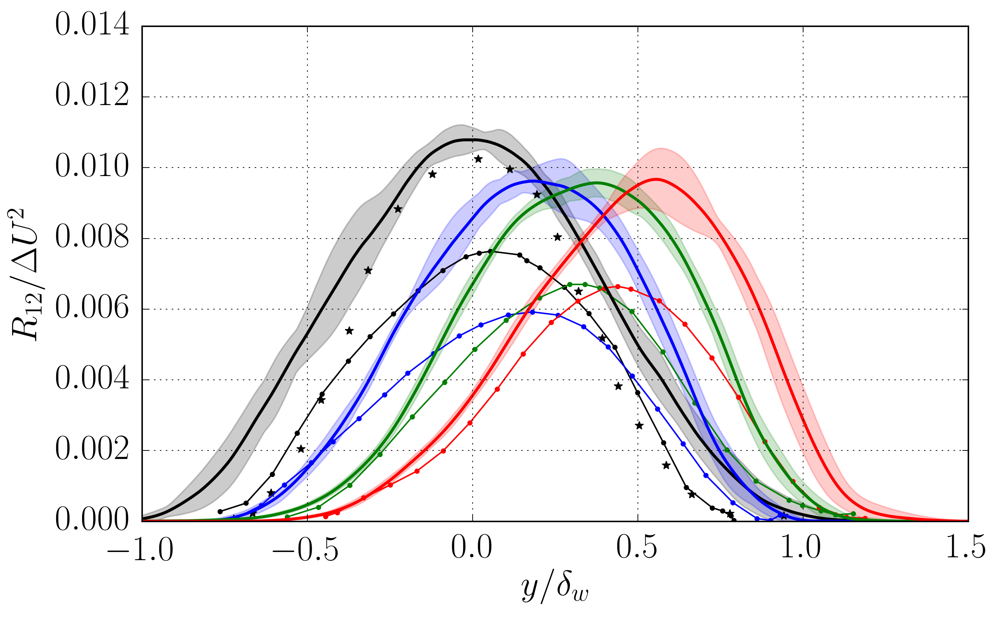

In [1385]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.ylim([0.0,0.014])
plt.plot(R12_1994[:,0],R12_1994[:,1]**2,'k*')
if scaling=='dw':
    plt.xlim([-1,1.5])
plt.grid('on')

plt.plot(R12s1pantano[:,0]/conv[0],R12s1pantano[:,1],'k.-')
plt.plot(R12s2pantano[:,0]/conv[1],R12s2pantano[:,1],'b.-')
plt.plot(R12s4pantano[:,0]/conv[2],R12s4pantano[:,1],'g.-')
plt.plot(R12s8pantano[:,0]/conv[3],R12s8pantano[:,1],'r.-')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    #for icase in range(len(lcases)):
        #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2

In [1386]:
variable = 'Tm' #any vector variable available
scaling  = 'dm' #can be dw or dm
xlabel =r'$y/\delta_m$'
ylabel =r"$\frac{\overline{T}-T_{min}}{\Delta T}$"
ylabel =r"$\overline{\theta}$"
#figname = 'Tm_ave2dw'
figname = 'Tm_ave2'
derivative=False
#figname = 'Trms_ave.png'

figure saved!
figure /share/drive/toni/VDML/JFM/Tm_ave2.pdf saved!
figure /share/drive/toni/VDML/JFM/Tm_ave2std.pdf saved!


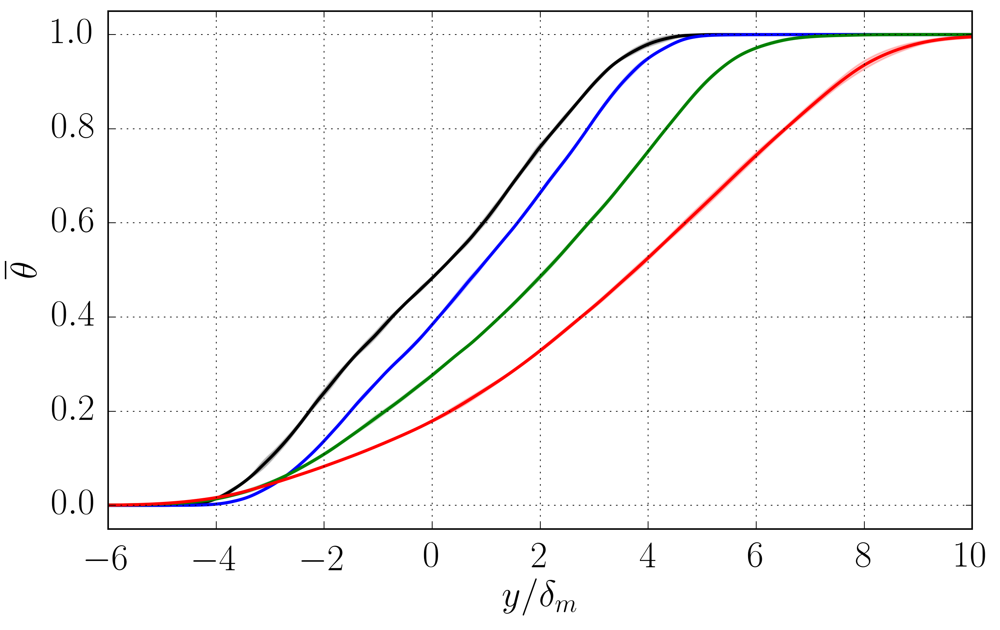

In [1387]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-6,10])
plt.grid('on')
plt.ylim([-0.05,1.05])
DT =[[]for i in range(len(lcases))]
Tmin =[[]for i in range(len(lcases))]
for icase in range(len(lcases)):
    DT[icase] = np.abs(fSS[icase][-1]-fSS[icase][0])
    Tmin[icase] = np.min(fSS[icase])
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],(fSS[icase]-Tmin[icase])/DT[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname

In [1388]:
variable = 'Tm' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r"$(\overline{T}-T_{min})/\Delta T$"
ylabel=r"$\overline{\theta}$"
figname = 'Tm_ave2dw'
#figname = 'Tm_ave2'
derivative=False
#figname = 'Trms_ave.png'

figure saved!


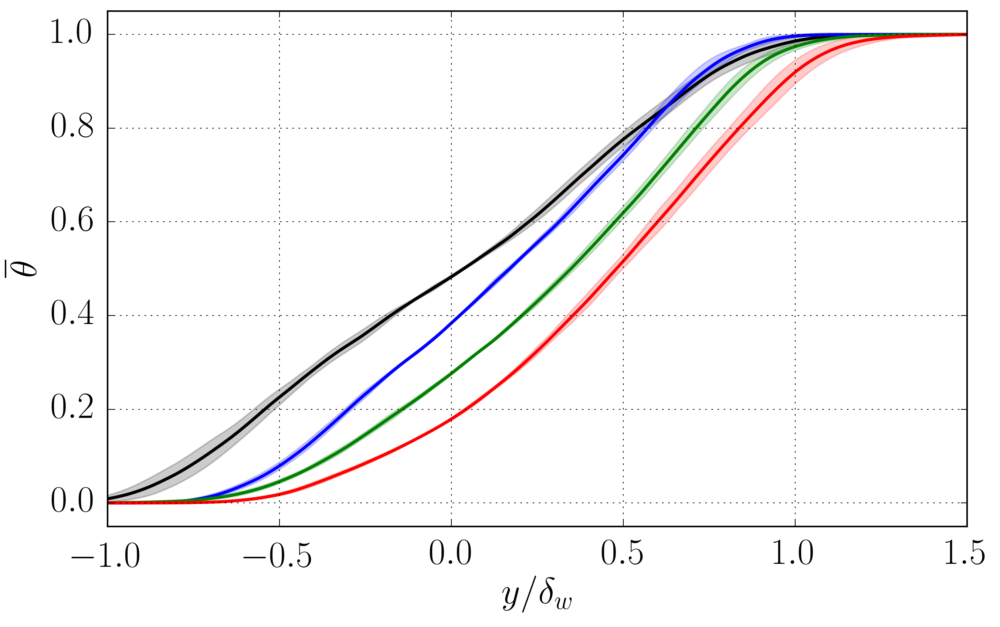

In [1389]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1.5])
plt.ylim([-0.05,1.05])
plt.grid('on')
DT =[[]for i in range(len(lcases))]
Tmin =[[]for i in range(len(lcases))]
for icase in range(len(lcases)):
    DT[icase] = np.abs(fSS[icase][-1]-fSS[icase][0])
    Tmin[icase] = np.min(fSS[icase])
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],(fSS[icase]-Tmin[icase])/DT[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

figure saved!


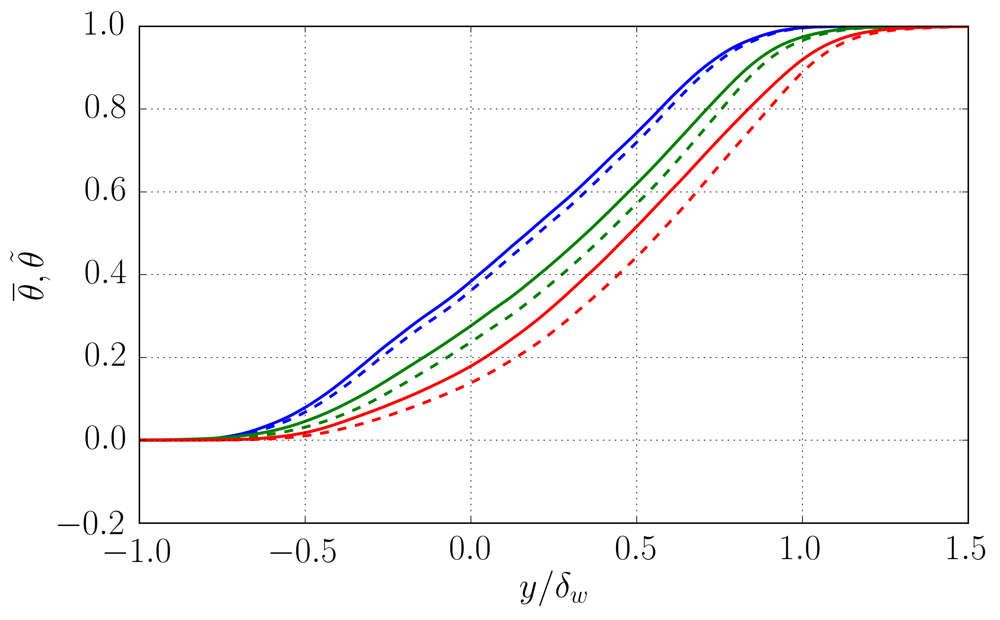

In [1390]:
variable = 'Tm' #any vector variable available
variable2 = 'rhom' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r"$\overline{\theta},\tilde{\theta}$"
#ylabel=r"$\overline{\theta}$"
figname = 'Thetacomp_dw'
#figname = 'Tm_ave2'
derivative=False
#figname = 'Trms_ave.png'

ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
ycases2,fSS2,errorSS2 = getSScase2(p_folders,lcases,variable2,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1.5])
#plt.ylim([-0.05,1.05])
plt.grid('on')
DT =[[]for i in range(len(lcases))]
Tmin =[[]for i in range(len(lcases))]
for icase in range(1,len(lcases)):
    DT[icase] = np.abs(fSS[icase][-1]-fSS[icase][0])
    Tmin[icase] = np.min(fSS[icase])
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],(fSS[icase]-Tmin[icase])/DT[icase],l_job_style[icase],lw=2.0)
    plt.plot(ycases2[icase][0],(1.0/fSS2[icase]-Tmin[icase])/DT[icase],l_job_style[icase],lw=2.0,ls='dashed')
    #plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #for icase in range(len(lcases)):
    #    plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #pathname = save_folder + figname + 'std' + fformat
    #fig.savefig(pathname,bbox_inches='tight')

figure saved!


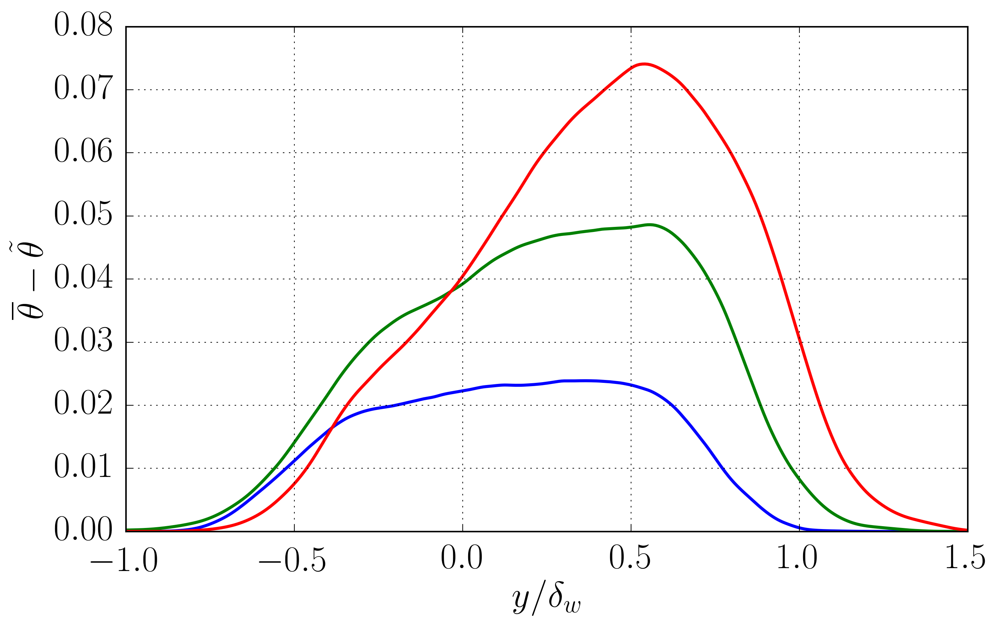

In [1391]:
variable = 'Tm' #any vector variable available
variable2 = 'rhom' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r"$\overline{\theta}-\tilde{\theta}$"
#ylabel=r"$\overline{\theta}$"
figname = 'Thetadiff_dw'
#figname = 'Tm_ave2'
derivative=False
#figname = 'Trms_ave.png'

ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
ycases2,fSS2,errorSS2 = getSScase2(p_folders,lcases,variable2,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
plt.xlim([-1,1.5])
#plt.ylim([-0.05,1.05])
plt.grid('on')
DT =[[]for i in range(len(lcases))]
Tmin =[[]for i in range(len(lcases))]
for icase in range(1,len(lcases)):
    DT[icase] = np.abs(fSS[icase][-1]-fSS[icase][0])
    Tmin[icase] = np.min(fSS[icase])
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],(fSS[icase]-1.0/fSS2[icase])/DT[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    #for icase in range(len(lcases)):
    #    plt.fill_between(ycases[icase][0], (fSS[icase]-Tmin[icase]-errorSS[icase])/DT[icase], (fSS[icase]-Tmin[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #pathname = save_folder + figname + 'std' + fformat
    #fig.savefig(pathname,bbox_inches='tight')

In [1392]:
DT[0]=1
print DT

[1, 0.75, 1.875, 3.9375]


## $\overline{T_{rms}}/{\Delta T}$

In [1393]:
variable = 'Trms' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r"$T_{rms}^2/\Delta T^2$"
figname = 'Trms2_ave_dw'
derivative=False
#figname = 'Trms_ave.png'

figure saved!
/share/drive/toni/VDML/JFM/Trms2_ave_dwstd.pdf


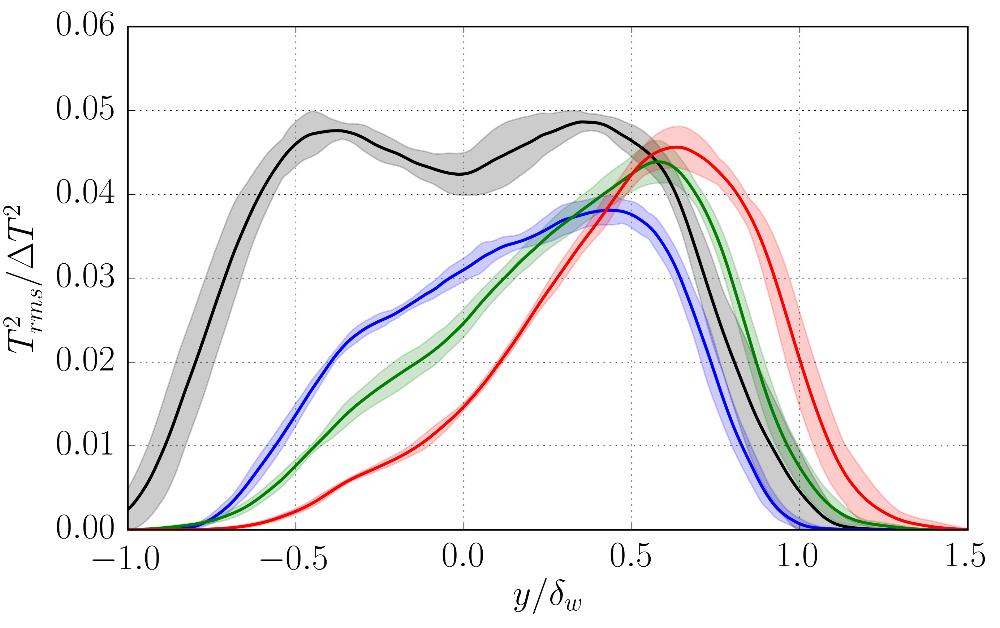

In [1394]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.grid('on')
plt.ylim([0.0,0.06])
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase]**2/DT[icase]**2,l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]**2-2.0*fSS[icase]*errorSS[icase])/DT[icase]**2, (fSS[icase]**2+2.0*fSS[icase]*errorSS[icase])/DT[icase]**2,color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print pathname

## $\partial{\overline{T}} / \partial{y}$

In [1395]:
variable = 'Tm' #any vector variable available
scaling  = 'dm' #can be dw or dm
xlabel =r'$y/\delta_m$'
#ylabel =r"$\frac{\partial \overline{T}}{\partial y}\frac{\delta_m}{\Delta T}$"
ylabel =r"$\frac{\partial \overline{T}}{\partial y}\frac{\delta_m}{\Delta T}$"
#ylabel =r"$\frac{\partial{\overline{\theta}}}{\partial{y}} \delta_m$"
#pathname = save_folder + 'DTmdy_ave' + fformat
#figname = 'DTmdy_ave.png'
figname = 'DTmdy_ave'
derivative = True
PRINT=True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
figure saved!
figure /share/drive/toni/VDML/JFM/DTmdy_ave.pdf saved!
figure /share/drive/toni/VDML/JFM/DTmdy_avestd.pdf saved!


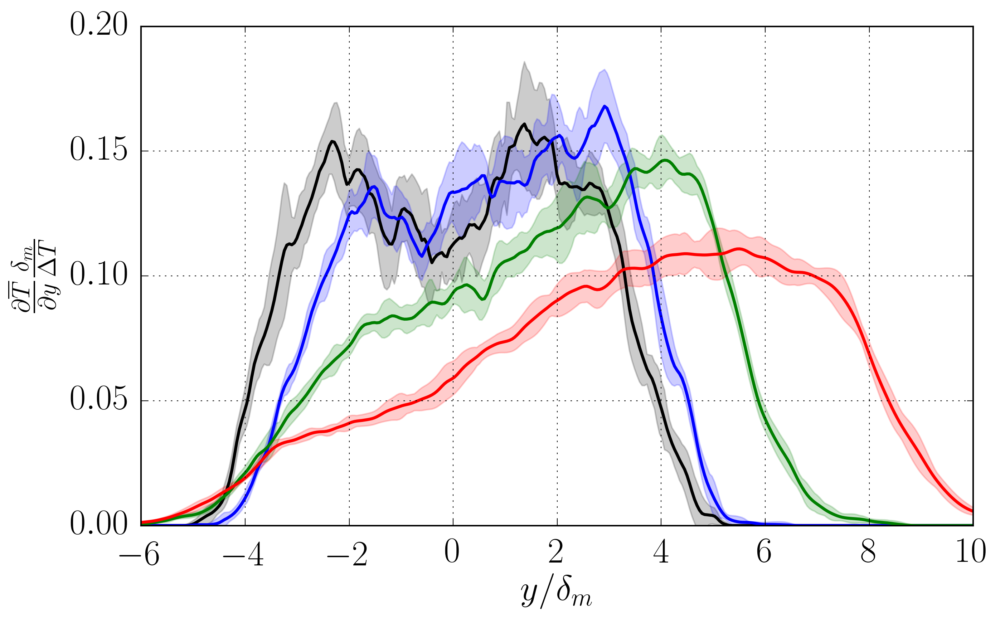

In [1396]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.grid('on')
plt.ylim([0.0,0.2])
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],fSS[icase]/DT[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "figure %s saved!" %pathname

In [1397]:
variable = 'Tm' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
ylabel =r"$\frac{\partial \overline{T}}{\partial y}\frac{\delta_w}{\Delta T}$"
#ylabel =r"$\frac{\partial{\overline{\theta}}}{\partial{y}} \delta_m$"
#pathname = save_folder + 'DTmdy_ave' + fformat
#figname = 'DTmdy_ave.png'
figname = 'DTmdy_ave_dw'
derivative = True
PRINT=True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
1
1.00001730321
0.75
1.00001432607
1.875
1.00001649689
3.9375
1.00001137344
figure saved!


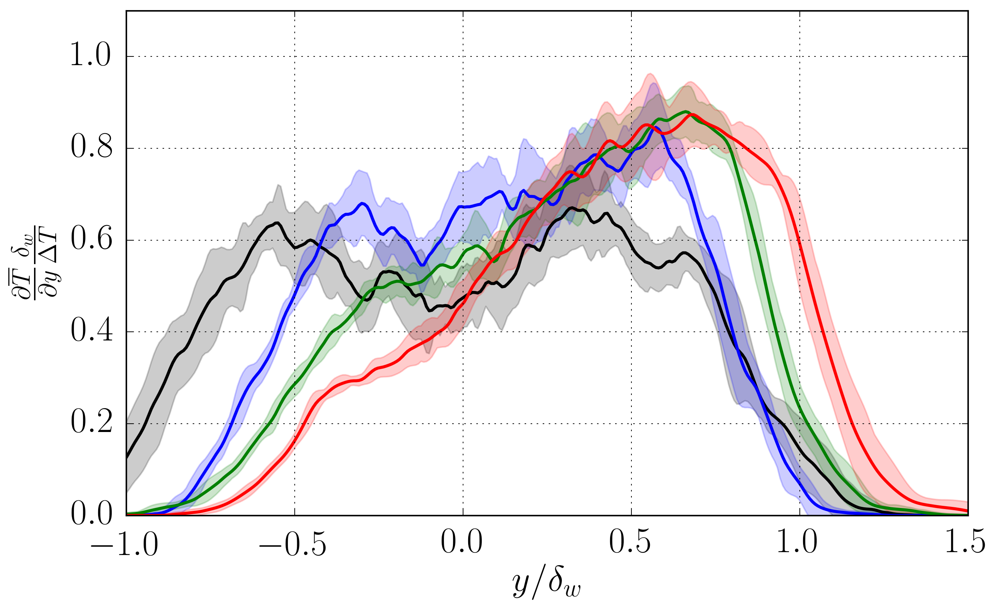

In [1398]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.ylim([0.0,1.1])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    fSS[icase]=fSS[icase]/(DT[icase])
    print DT[icase]
    errorSS[icase]=errorSS[icase]/(DT[icase])
    plt.plot(ycases[icase][0],fSS[icase],l_job_style[icase],lw=2.0)
    print np.trapz(fSS[icase],ycases[icase][0])
    #plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase])/DT[icase], (fSS[icase]+errorSS[icase])/DT[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], (fSS[icase]-errorSS[icase]), (fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

In [1399]:
variable = 'rum' #any vector variable available
scaling  = 'dw' #can be dw or dm
xlabel =r'$y/\delta_w$'
#ylabel =r"$\overline{\partial{T}/\partial{y}}{\delta_m}/\Delta T$"
ylabel =r"$-\frac{\partial{\tilde{u}}}{\partial{y}} \frac{\delta_w}{\Delta U}$"
#pathname = save_folder + 'DTmdy_ave' + fformat
#figname = 'DUmdy_ave.png'
figname = 'DUmdy_ave_dw'
derivative = True
PRINT=True

Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
Taking derivative and multiplying by scaling
figure saved!


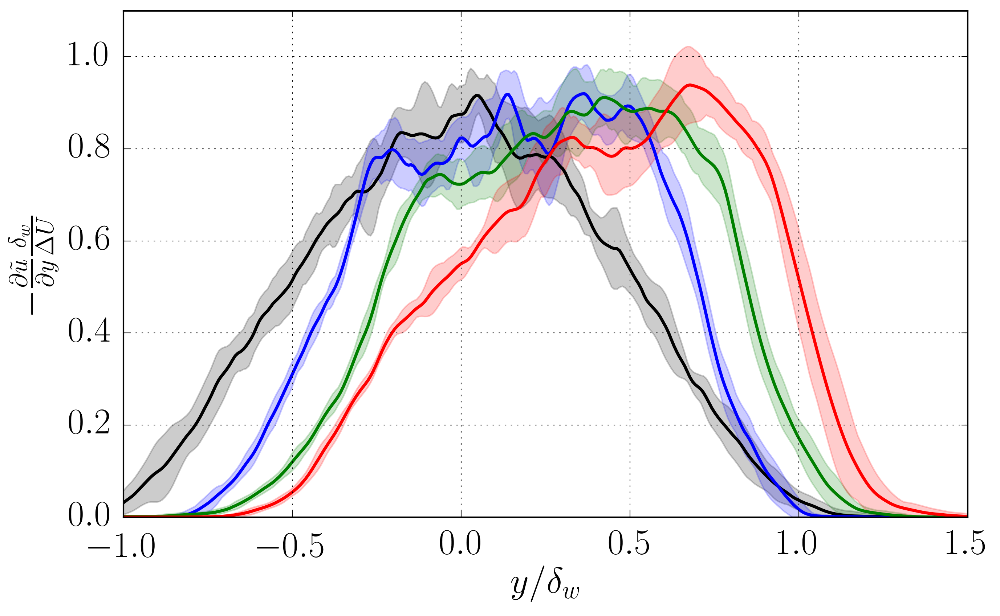

In [1400]:
ycases,fSS,errorSS = getSScase2(p_folders,lcases,variable,scaling,SS1,SS2,500,derivative);
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
plt.xlabel(xlabel);plt.ylabel(ylabel);
if scaling=='dm':
    plt.xlim([-6,10])
else:
    plt.xlim([-1,1.5])
plt.ylim([0.0,1.1])
plt.grid('on')
for icase in range(len(lcases)):
    #print ycases[icase], fSS[icase]
    plt.plot(ycases[icase][0],-fSS[icase],l_job_style[icase],lw=2.0)
    #plt.fill_between(ycases[icase][0], fSS[icase]-errorSS[icase], fSS[icase]+errorSS[icase],color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    fig.savefig(pathname,bbox_inches='tight')
    for icase in range(len(lcases)):
        plt.fill_between(ycases[icase][0], -(fSS[icase]-errorSS[icase]), -(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    pathname = save_folder + figname + 'std' + fformat
    fig.savefig(pathname,bbox_inches='tight')

In [1401]:
print SS1, SS2

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730] [1004.0, 1132.0, 890.0, 1012.0, 1061.0, 948.0, 909.0, 846.0, 949.0, 929.0, 990.0, 858.0]


# STATISTICS FROM FIELD

In [151]:
Kuref=np.loadtxt('/share/drive/toni/python/Ku.dat')
Suref=np.loadtxt('/share/drive/toni/python/Su.dat')
Kvref=np.loadtxt('/share/drive/toni/python/Kv.dat')
Svref=np.loadtxt('/share/drive/toni/python/Sv.dat')
Ktref=np.loadtxt('/share/drive/toni/python/Kt.dat')
Stref=np.loadtxt('/share/drive/toni/python/St.dat')

In [152]:
#print Kuref

## Temperature

In [184]:
#print Dwcase
Dwcase=[1.0,1.0,1.0,1.0] #Using dw!

In [194]:
p_root = '/share/drive/toni/'
cases = ['Re160s10','Re160s20','Re160s40','Re160s80']
p_folder_stats = [p_root + cases[i]+'/Tstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

In [195]:
l_width=2.0
l_job_color=['k','b','g','r']

1.0 0.0
0.75 0.75
0.625 1.875
0.5625 3.9375


(-1.0, 1.5)

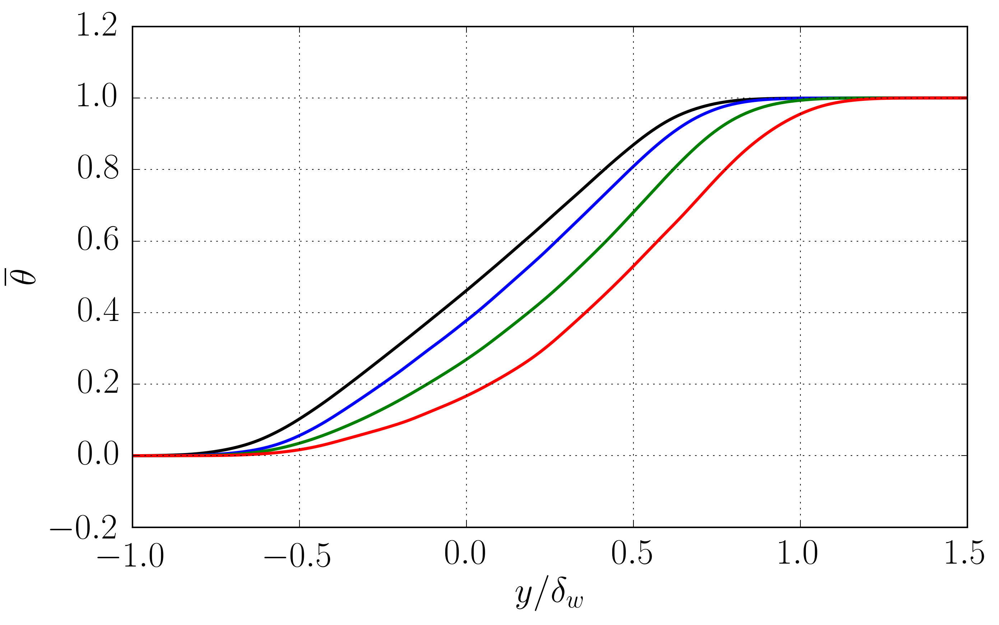

In [196]:
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
lamb = [0 for i in range(len(cases))]
Tmin = [0 for i in range(len(cases))]
Tmax = [0 for i in range(len(cases))]
DT = [0 for i in range(len(cases))]
s = [1,2,4,8]
for i in range(len(cases)):
    lamb[i] = (s[i]-1.0)/(s[i]+1.0)
    Tmax[i]=1.0/(1-lamb[i])
    Tmin[i] = 1.0/(1.0+lamb[i])
    DT[i]=Tmax[i]- Tmin[i]
    print Tmin[i],DT[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][1,:]-Tmin[i])/DT[i],lw=l_width,color=l_job_color[i]);plt.grid('on')
plt.xlabel(r'$y/\delta_w$')
#ylabel=r'$\frac{T-T_{min}}{\Delta T}$'
ylabel=r'$\overline{\theta}}$'
plt.ylabel(ylabel)
plt.xlim([-1.0,1.5])

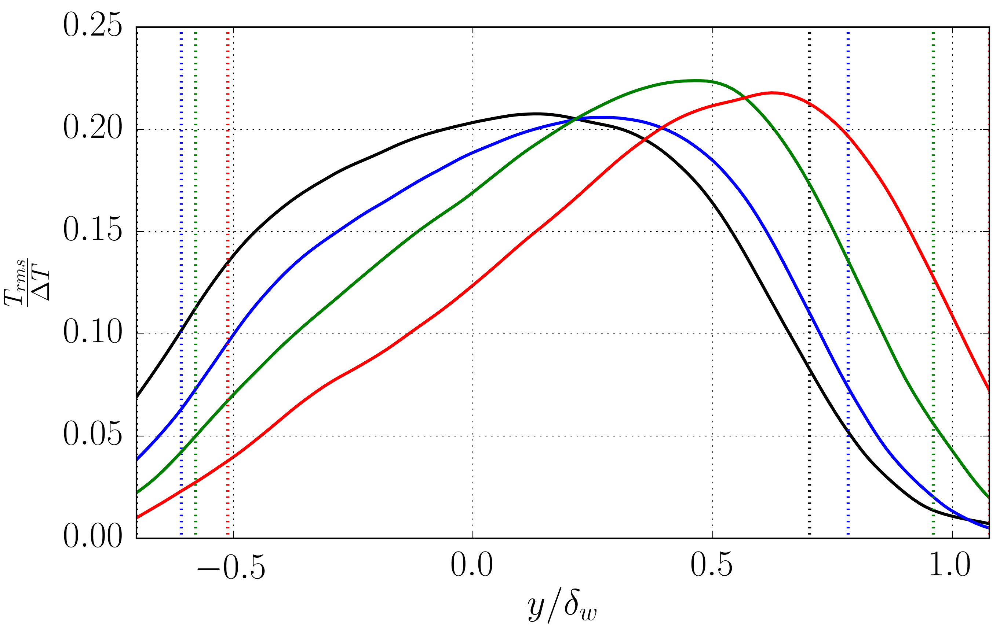

In [197]:
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
column=2
for i in range(len(cases)):
    Tmax[i]=1.0/(1-lamb[i])
    Tmin[i] = 1.0/(1.0+lamb[i])
    DT[i]=Tmax[i]- Tmin[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(np.sqrt(stat[i][column,:]))/DT[i],lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.ylim([0.0,0.25])
plt.xlim([np.min(ymin),np.max(ymax)])
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$\frac{T_{rms}}{\Delta T}$')

In [198]:
print SS1,SS2

[230, 230, 210, 270.0, 270, 270, 340, 320, 340, 500, 500, 510] [350, 370, 400, 420.0, 420, 420, 500, 500, 500, 660, 600, 680]


202
208
230.0
239.0
figure saved!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:14: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


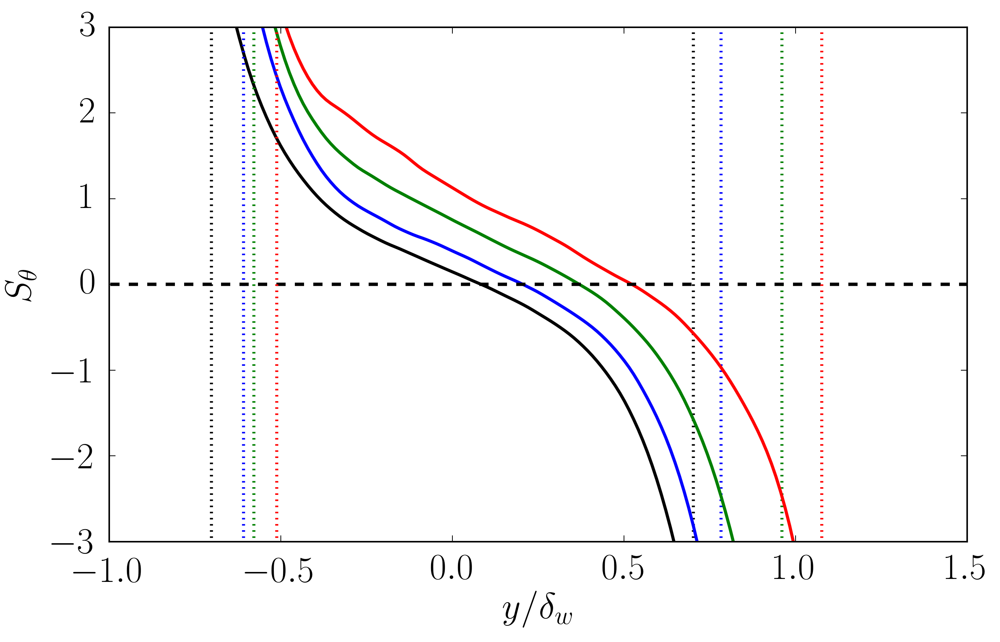

In [205]:
figname = 'skewT_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    if i == 2 or i==3:
        itop=round(itop*1.3)
    print itop
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    #plt.plot(Stref[:,0],Stref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:13: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


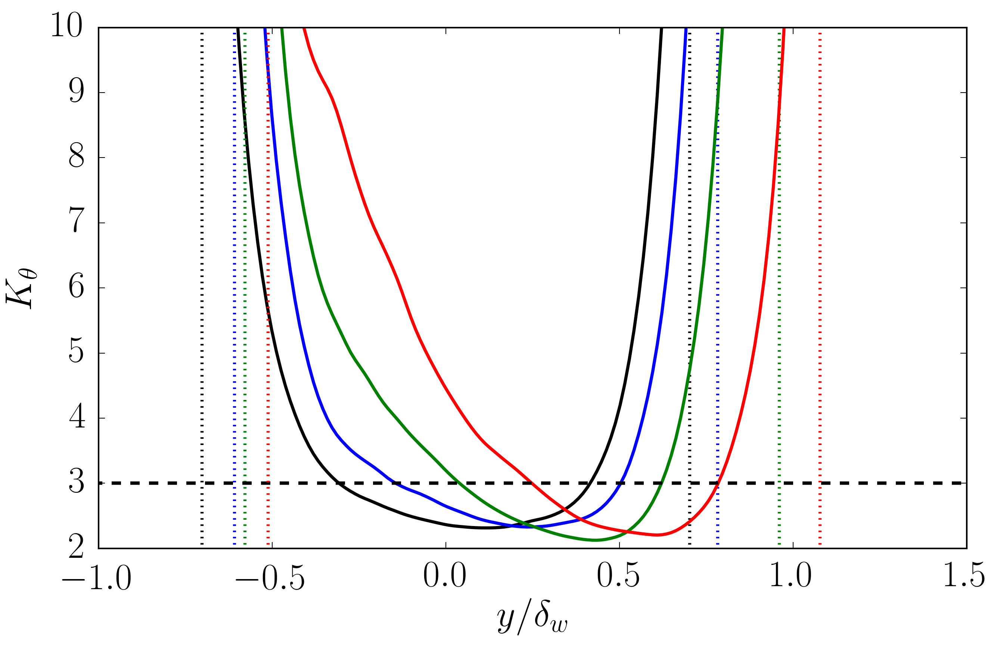

In [207]:
column=4
figname = 'kurtT_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    if i == 2 or i==3:
        itop=round(itop*1.3)
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    #plt.plot(Ktref[:,0],Ktref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

figure saved!


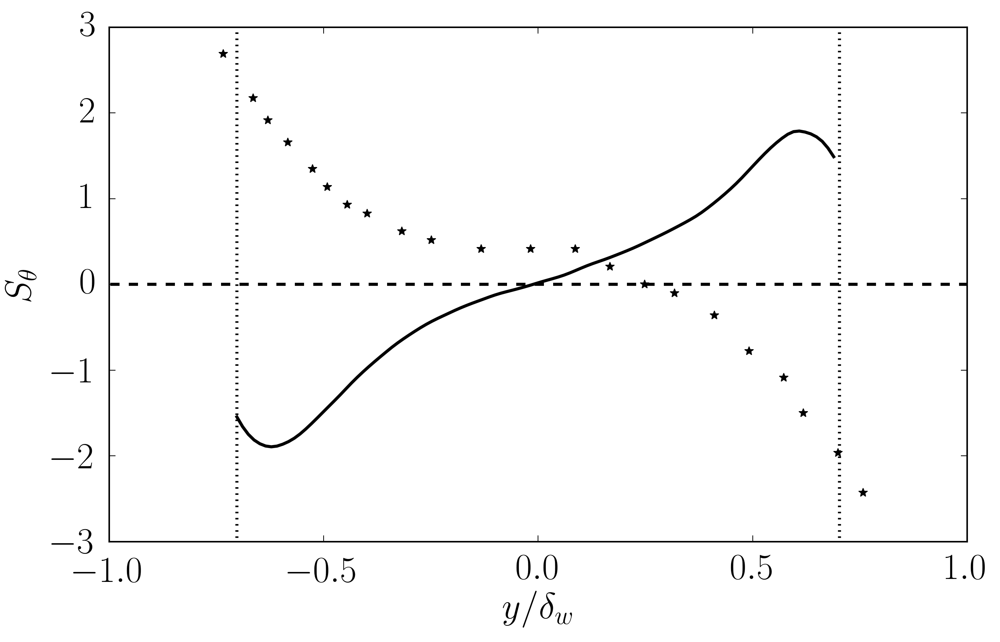

In [170]:
figname = 'skewT_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Stref[:,0],Stref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


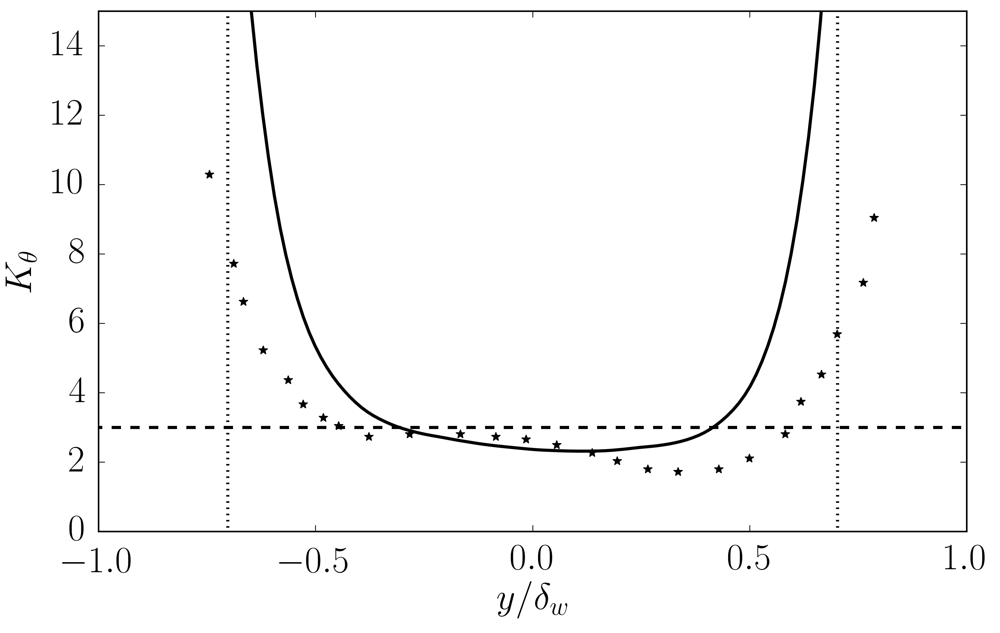

In [62]:
column=4
figname = 'kurtT_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Ktref[:,0],Ktref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_\theta$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

## U

In [191]:
p_root = '/share/drive/toni/'
cases = ['Re160s10','Re160s20','Re160s40','Re160s80']
p_folder_stats = [p_root + cases[i]+'/ustats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

-0.702341137124 0.702341137124
-0.608695652174 0.782608695652
-0.578595317726 0.959866220736
-0.511705685619 1.07692307692
figure saved!


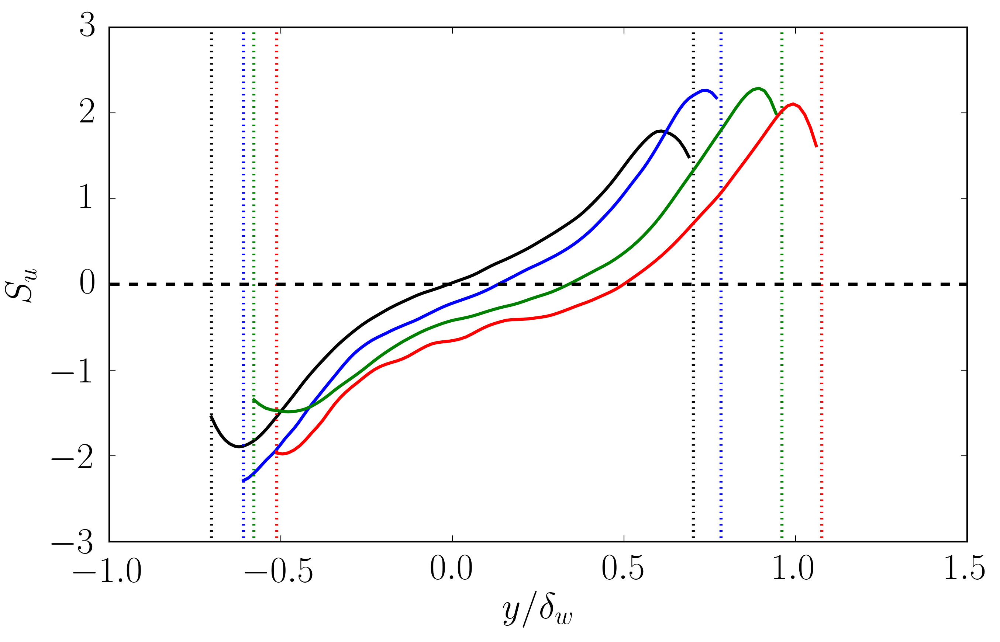

In [192]:
figname = 'skewu_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
umm = np.zeros([shape(stat)[0],shape(stat)[2]])
yyy = np.zeros([shape(stat)[0],shape(stat)[2]])
ymin = np.zeros([shape(stat)[0]])
ymax = np.zeros([shape(stat)[0]])
mllim=0.98
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    umm[i,:] = stat[i][1,:]
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    ymin[i]=yyy[i,ibot]
    ymax[i]=yyy[i,itop]
    print ymin[i],ymax[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    #plt.plot(Suref[:,0],Suref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


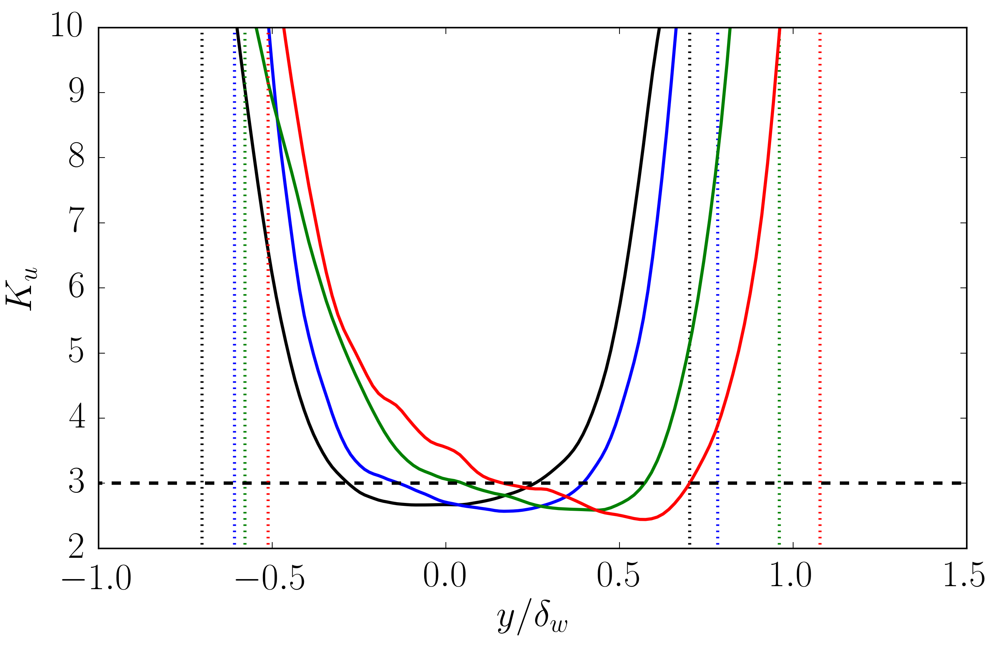

In [173]:
column=4
figname = 'kurtu_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(Dwcase[i]*stat[i][0,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

figure saved!


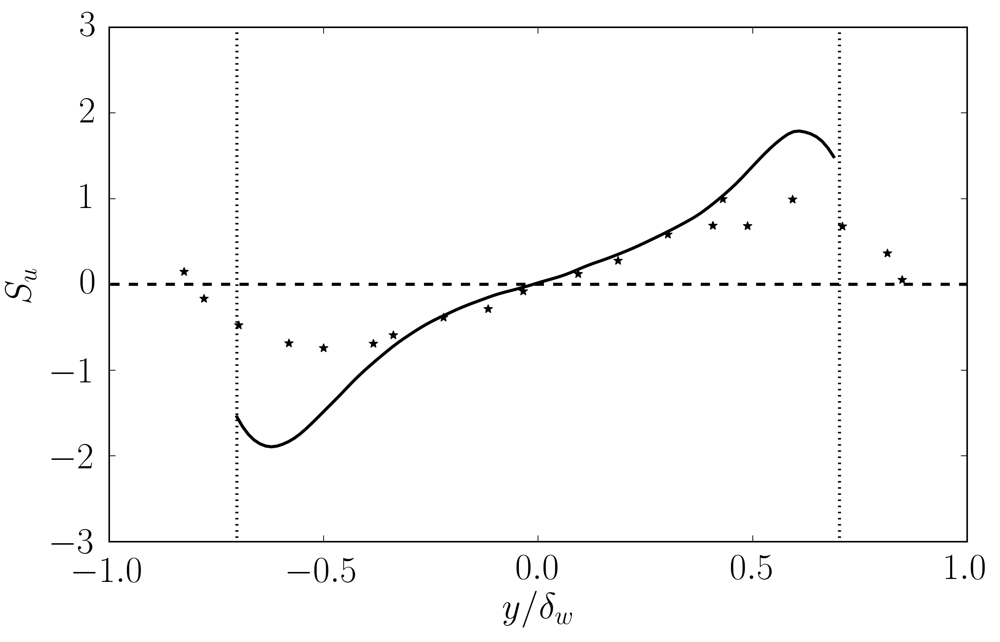

In [174]:
figname = 'skewu_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Suref[:,0],Suref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


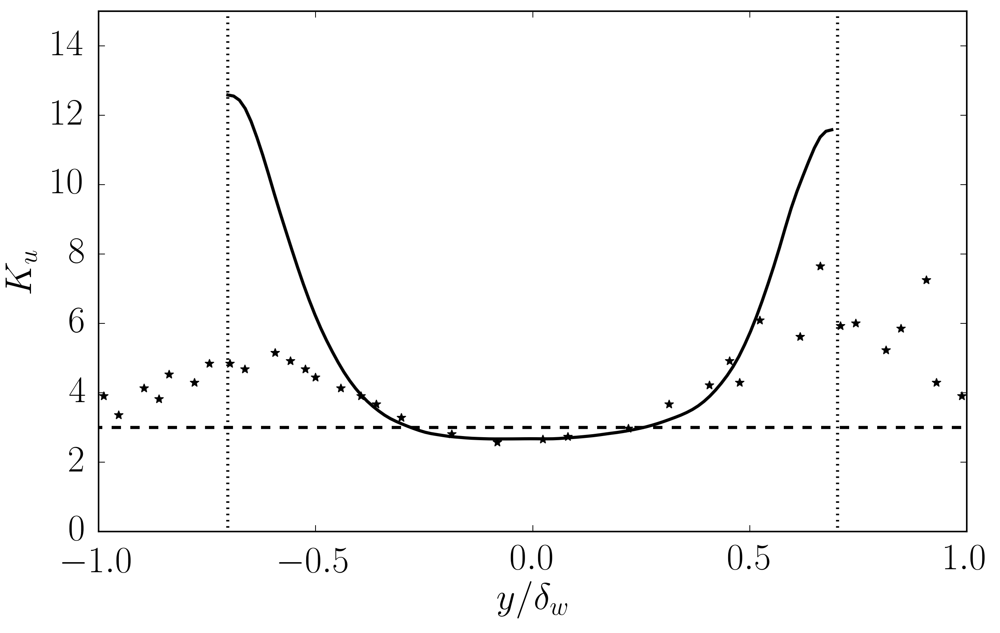

In [175]:
column=4
figname = 'kurtu_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Kuref[:,0],Kuref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_u$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# $v$

In [176]:
p_root = '/share/drive/toni/'
cases = ['Re160s10','Re160s20','Re160s40','Re160s80']
p_folder_stats = [p_root + cases[i]+'/vstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

figure saved!


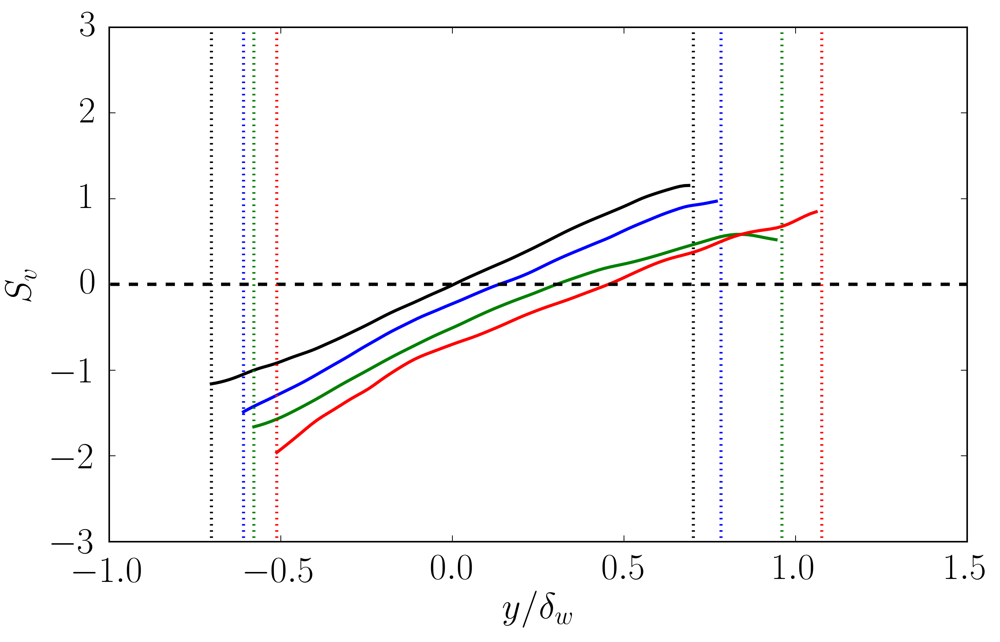

In [177]:
figname = 'skewv_dw2'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


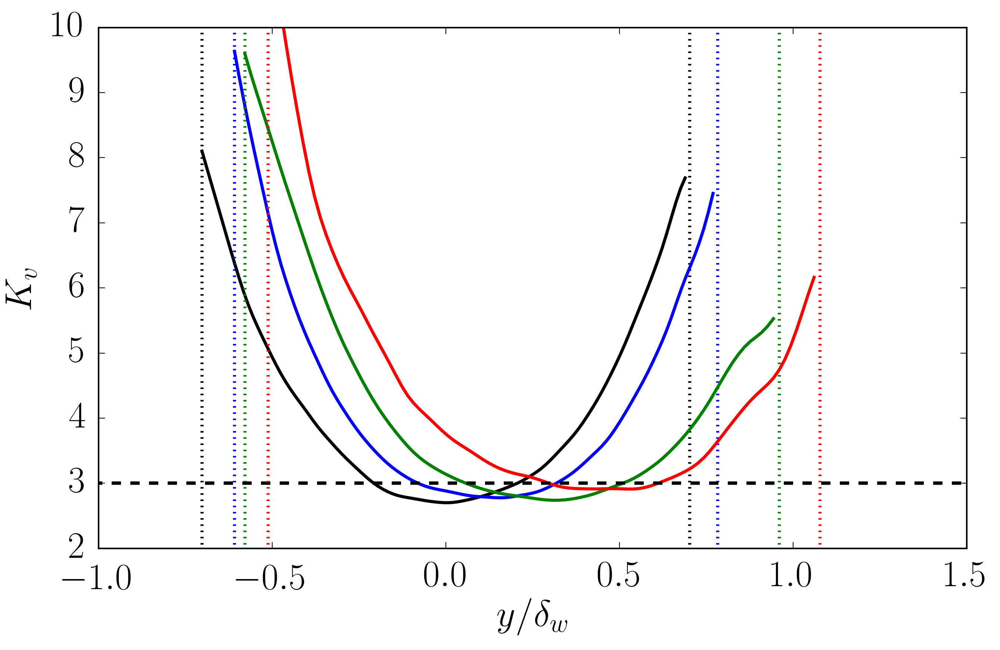

In [178]:
column=4
figname = 'kurtv_dw2'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
plt.xlim([-1.0,1.5])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# Comparison

figure saved!


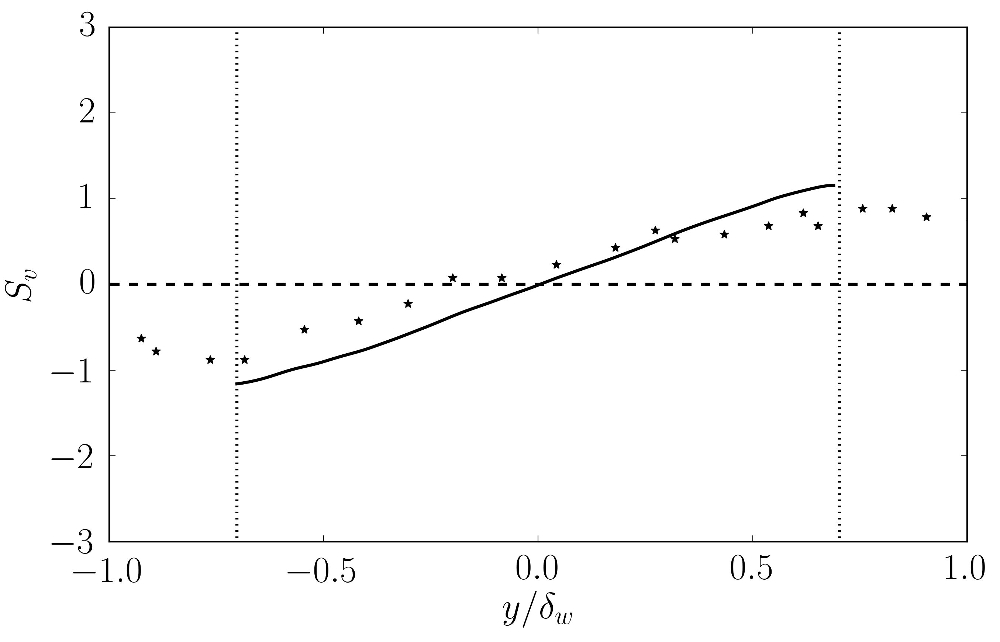

In [179]:
figname = 'skewv_comp'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on')    
    #plt.plot(Dwcase[i]*stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-10.0,10.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Svref[:,0],Svref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
plt.xlim([-1.0,1.])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!


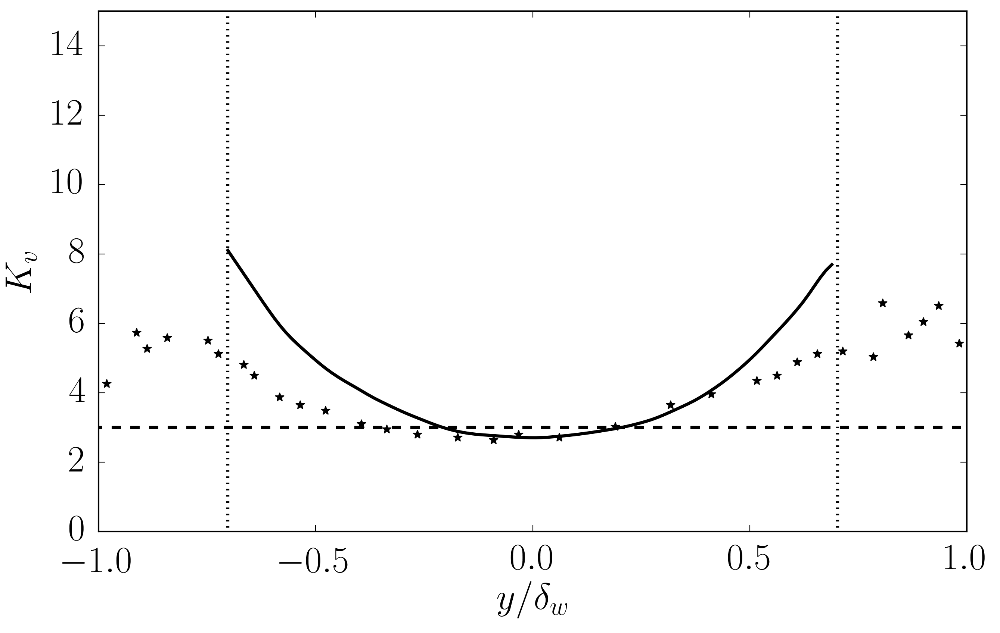

In [180]:
column=4
figname = 'kurtv_comp'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(1):
    yyy[i,:] = stat[i][0,:]*Dwcase[i]
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    ibot = where(umm[i,:]>mllim*0.5)[0][-1]
    itop = where(umm[i,:]<-mllim*0.5)[0][0]
    plt.plot(yyy[i,ibot:itop],(stat[i][column,ibot:itop]),lw=l_width,color=l_job_color[i]);plt.grid('on') 
    plt.plot([-10.0,10.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot(Kvref[:,0],Kvref[:,1],'k*',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_v$')
plt.grid('off')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([0,15])
plt.xlim([-1.0,1.0])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

# w

In [181]:
p_root = '/share/drive/toni/'
cases = ['Re160s10','Re160s20','Re160s40','Re160s80']
p_folder_stats = [p_root + cases[i]+'/wstats.txt' for i in range(len(cases))]
stat=[]
for case,i in zip(p_folder_stats,range(len(cases))):
    stat.append(np.loadtxt(case) )

figure saved!


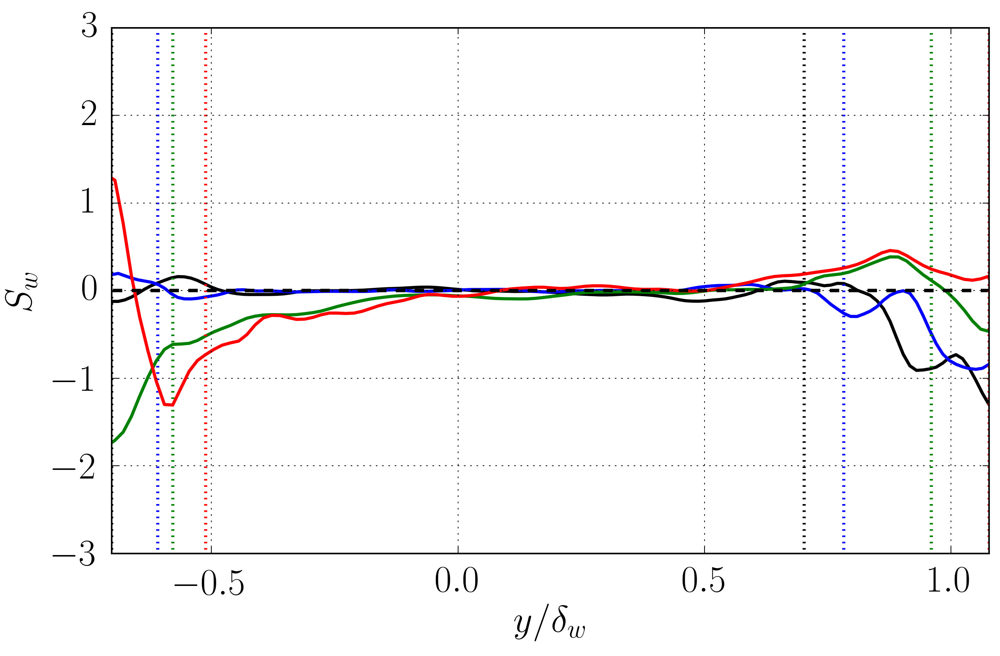

In [182]:
figname = 'skeww_dw'
column=3
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-2.0,2.0],[0.0,0.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$S_w$')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([-3,3])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')

figure saved!
/share/drive/toni/JFM_lomacte2/kurtw_dw.pdf


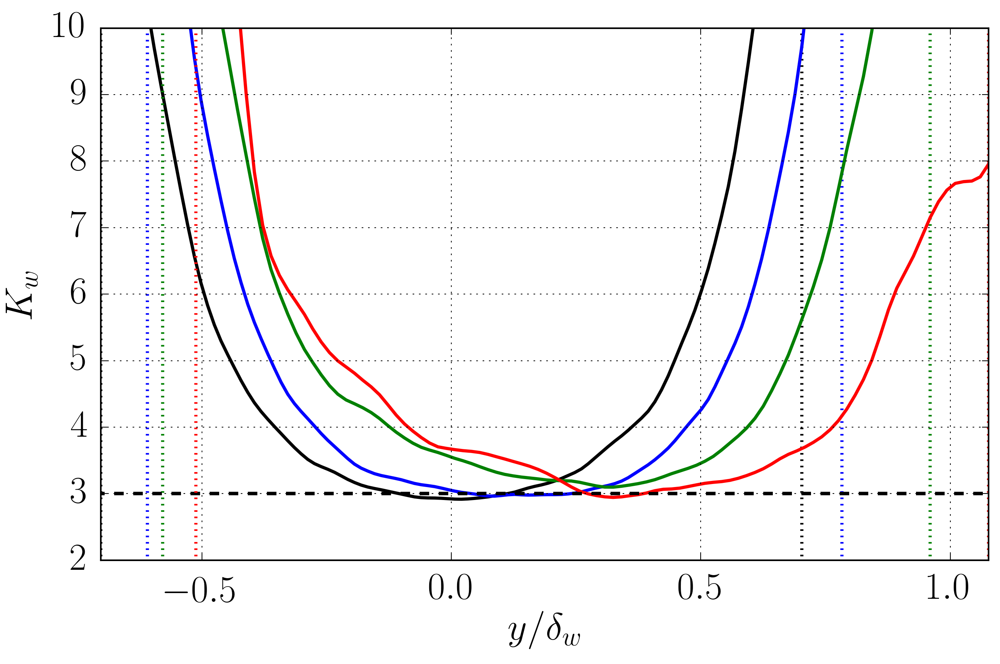

In [183]:
column=4
figname = 'kurtw_dw'
figo = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=figo.add_subplot(1,1,1)
for i in range(len(cases)):
    if i == 0:
        Tmin[i]=0;Tmax[i]=1.0;DT[i]=1.0
    plt.plot(stat[i][0,:],(stat[i][column,:]),lw=l_width,color=l_job_color[i]);plt.grid('on')
    plt.plot([-2.0,2.0],[3.0,3.0],'k--',lw=l_width)
    plt.plot([ymin[i],ymin[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
    plt.plot([ymax[i],ymax[i]],[-5,20],color=l_job_color[i],ls='dotted',lw=2.0)
plt.xlabel(r'$y/\delta_w$')
plt.ylabel(r'$K_w$')
plt.xlim([np.min(ymin),np.max(ymax)]);plt.ylim([2,10])
if PRINT == True:
    print "figure saved!"
    pathname = save_folder + figname + fformat
    figo.savefig(pathname,bbox_inches='tight')
    print pathname

In [940]:
print DT

[1.0, 0.7499999999999998, 1.875, 3.9375]


In [950]:
print Tmin

[0, 0.75, 0.625, 0.5625]


In [606]:
print vplanes[3]

[170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 227, 230, 235, 240, 245, 250, 255, 260, 265]


# SPECTRA

In [1421]:
St1=SS1
St2=np.array(St1)
for i in range(len(St1)):
    St2[i]=St1[i]+10.0
print St2

[930 990 730 910 860 800 730 730 790 760 890 740]


In [1422]:
kk = np.linspace(1,10,10)
print kk
kk[:]=0.0
print kk

[  1.   2.   3.   4.   5.   6.   7.   8.   9.  10.]
[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]


In [1423]:
def getSpectra(path,nplane,pathSTA,variable,tmin,tmax, sumaxis,scaling = 'dm',Npoints=500):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(pathSTA,"r") as g:
        delta = np.array(g[scaling])
        y=np.array(g['y'])
    planePOS=y[nplane]
    print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmin = kx[1]*delta[it2]#Kmin scaled with max dm
        kmax = kx[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kx
    elif sumaxis==1:
        kmin = kz[1]*delta[it2]#Kmin scaled with max dm
        kmax = kz[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kz
    #xik = np.linspace(kmin,kmax,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
    f00job = [0.0 for i in range(it2-it1)]
    print it1,it2
    print np.shape(fun)
    for itime in range(it1,it2):
        dd = delta[itime]
        if variable==5 or variable==6 or variable==7:
            funint = np.interp(xik,kk*dd,dd**2*kk*fun[:,itime],left=NaN,right=NaN)
        else:
            funint = np.interp(xik,kk*dd,dd*kk*fun[:,itime],left=NaN,right=NaN)
        fyjob[itime-it1] = funint
        f00job[itime-it1] = fun00[itime]
    planedeltaEVO = planePOS/delta[it1:it2]

    return xik,np.mean(fyjob,axis=0),np.std(fyjob,axis=0),time[it1:it2],f00job,planedeltaEVO

In [1431]:
def getSpectra2(path,nplane,pathSTA,variable,tmin,tmax, sumaxis,scaling = 'dm',Npoints=500):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(pathSTA,"r") as g:
        delta = np.array(g[scaling])
        y=np.array(g['y'])

    planePOS=y[nplane-1]
    #print nplane
    print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmin = kx[1]*delta[it2]#Kmin scaled with max dm
        kmax = kx[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kx
    elif sumaxis==1:
        kmin = kz[1]*delta[it2]#Kmin scaled with max dm
        kmax = kz[-1]*delta[it1]
        xik = np.logspace(np.log(kmin)/2.0,np.log(kmax)/2.0,Npoints)
        kk = kz
    #xik = np.linspace(kmin,kmax,Npoints)
    funintcum = np.zeros(Npoints);
    nacum = 0
    fyjob = [np.zeros(Npoints) for i in range(it2-it1)]
    f00job = [0.0 for i in range(it2-it1)]
    print it1,it2
    print np.shape(fun)
    ydm = np.zeros([it2-it1])
    for itime in range(it1,it2):
        dd = delta[itime]
        if variable==5 or variable==6 or variable==7:
            funint = np.interp(xik,kk*dd,dd**2*kk*fun[:,itime],left=NaN,right=NaN)
        else:
            funint = np.interp(xik,kk*dd,dd*kk*fun[:,itime],left=NaN,right=NaN)
            
        fyjob[itime-it1] = funint
        f00job[itime-it1] = fun00[itime]
        ydm[itime-it1] = planePOS/delta[itime]

    return xik,ydm,fyjob,time[it1:it2],f00job,

# ACCUMULATION SPECTRA

In [1432]:
def accumSpectraScaled(path,nplane,y,delta,variable,tmin,tmax, sumaxis,kbin,ydbin,matrix,countM):
    """
    Accum spectra in y/delta bins and kxdelta bins, saved in matrix
    """
    lenkbin,lenydbin=np.shape(matrix)
    planePOS=y[nplane-1]
    #print nplane
    #print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx);
        mz = len(kz);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)

    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kk = kx
        m  = mx
    elif sumaxis==1:
        kk = kz
        m  = mz
    #Get Dkbin supposing linear distribution
    Dk =  kbin[-1]-kbin[-2]
    #For each time --> different y/delta
    for itime in range(it1,it2):
        dd = delta[itime]
        ydm = planePOS/dd;
        maxE= np.max(fun[:,itime])
        fun2 = fun[:,itime]/maxE
        #Find ydbin location 
        jj = where(ydbin>=ydm)[0][0]
        k1 = np.round((dd/Dk)*kk)
        k1= k1.astype(int)
        iibefore = -1; #First is always new!
        for ii,ikx in zip(k1,range(m)):
            matrix[ii,jj]+=fun2[ikx]
            #Count is counting how many lines do we have per grid square
            if ii !=iibefore:
                countM[ii,jj]+=1
            iibefore = ii
 

    return matrix,countM

In [1433]:
p_folders

['/share/drive/toni/VDML/s10/01/h5.stats',
 '/share/drive/toni/VDML/s10/02/h5.stats',
 '/share/drive/toni/VDML/s10/03/h5.stats',
 '/share/drive/toni/VDML/s20/01/h5.stats',
 '/share/drive/toni/VDML/s20/02/h5.stats',
 '/share/drive/toni/VDML/s20/03/h5.stats',
 '/share/drive/toni/VDML/s40/01/h5.stats',
 '/share/drive/toni/VDML/s40/02/h5.stats',
 '/share/drive/toni/VDML/s40/03/h5.stats',
 '/share/drive/toni/VDML/s80/01/h5.stats',
 '/share/drive/toni/VDML/s80/02/h5.stats',
 '/share/drive/toni/VDML/s80/03/h5.stats']

In [1434]:
#Creating Matrix for accumulations
#NEED SOME CHECKING IN ORDER TO CREATE BIN VECTORS!
#kbin = [0,DK,kmax] with kmax = kx[-1]*max(delta)
#ydbin = [-y/max(delta),y/max(delta)]
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m =512; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m-12;
Nydbins = 31;
if scaling=='dw':
    ydmin = -1.05
    ydmax = 2.0 
    ydbin = np.linspace(ydmin,ydmax,Nydbins)
else: 
    print "I do not recommend using dm..."
    
matrix = np.zeros([Nkbins,Nydbins])
countM = np.zeros([Nkbins,Nydbins])
kmax = 0.0;
for ijob in jlist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    path = p_folders[ijob]
    print path
    with h5py.File(path,"r") as f:
        
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(m*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(m*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)


print "kmax = %s"%kmax
print "lambda min = %s, lambda max=%s"%(np.min(lbin),np.max(lbin))
#print kbin/np.min(np.diff(kbin))

/share/drive/toni/VDML/s10/01/h5.stats
/share/drive/toni/VDML/s10/02/h5.stats
/share/drive/toni/VDML/s10/03/h5.stats
kmax = 497.724231766
lambda min = 0.0, lambda max=8.67933


In [1435]:
def getSpectravstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkx0  = np.sum(funSPE[:,0,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kx,range(len(kx))):
            res += np.sum(funSPE[:,ii,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkx0,funRest,fun00

In [1436]:
def accumSpectra(path,nplane,y,delta,variable,tmin,tmax, sumaxis,kbin,ydbin,matrix,countM):
    """
    Accum spectra in y/delta bins and kxdelta bins, saved in matrix
    """
    lenkbin,lenydbin=np.shape(matrix)
    planePOS=y[nplane-1]
    #print nplane
    #print "y(nplane)=%s" %planePOS
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx);
        mz = len(kz);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = np.array(f['SPEC'][0,variable,0,:])
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    #Closing hdf5 files
    funSPE[0,0,:]=0.0 #Clean 00 mode
    fun = np.sum(funSPE,axis=sumaxis)
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kk = kx
        m  = mx
    elif sumaxis==1:
        kk = kz
        m  = mz
    #Get Dkbin supposing linear distribution
    Dk =  kbin[-1]-kbin[-2]
    #For each time --> different y/delta
    for itime in range(it1,it2):
        dd = delta[itime]
        ydm = planePOS/dd;
        outofbounds=False
        #Find ydbin location 
        try:
            jj = where(ydbin>=ydm)[0][0]
        except IndexError:
            #break
            jj = len(ydbin)-1 #Save into last line
            outofbounds=True
        if (ydm-ydbin[0])<=-np.diff(ydbin)[0]/2:#Too far from ydbin minimum
            outofbounds=True
        k1 = np.round((dd/Dk)*kk)
        if k1.any()>len(k1):
            print "Houston we have a problem: k1=%s"%k1
        k1= k1.astype(int)
        iibefore = -1; #First is always new!
        if outofbounds==False:
            #for ii,ikx in zip(k1,range(m)):
                #matrix[ii,jj]+=fun[ikx,itime]
            for ikx in range(m):
                ii = k1[ikx]
                matrix[ii,jj]+=fun[ikx,itime]
                #Count is counting how many lines do we have per grid square
                if ii !=iibefore:
                    countM[ii,jj]+=1
                iibefore = ii
    

    return matrix,countM

# SPECTRA PRINT STREAM

In [1437]:
print SS1

[920, 980, 720, 900, 850, 790, 720, 720, 780, 750, 880, 730]


In [1438]:
p_folders_spe=p_folders

In [1439]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe[ijob]=path[0:-5]+fnplane+'.spes'
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

0
/share/drive/toni/VDML/s10/01/h5.mid.spes
1
/share/drive/toni/VDML/s10/02/h5.mid.spes
2
/share/drive/toni/VDML/s10/03/h5.mid.spes
3
/share/drive/toni/VDML/s20/01/h5.mid.spes


IOError: Unable to open file (Unable to open file: name = '/share/drive/toni/vdml/s20/01/h5.mid.spes', errno = 2, error message = 'no such file or directory', flags = 0, o_flags = 0)

kmax = 289.798094657
yvslambdaEuu
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, plane numbers = 21
Max countM = 230.0, plane numbers = 21
maximorum=0.00677820128793
/share/drive/toni/JFM_lomacte2/yvslambdaEuu.eps figure saved!
yvslambdaEvv
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, pl

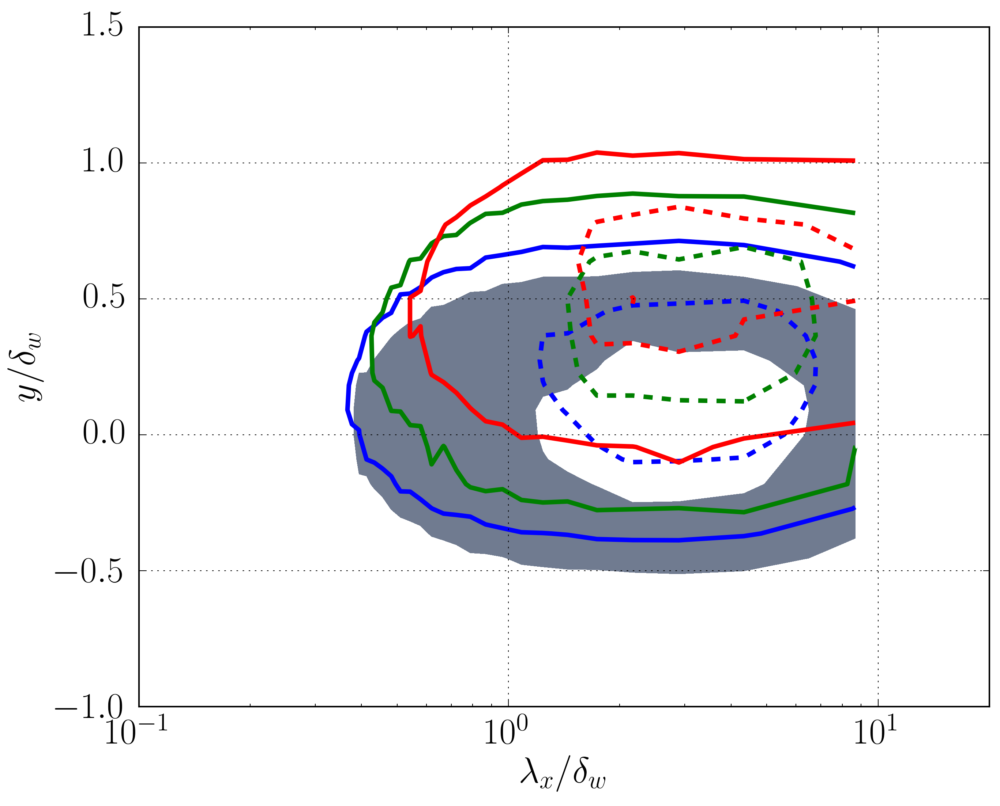

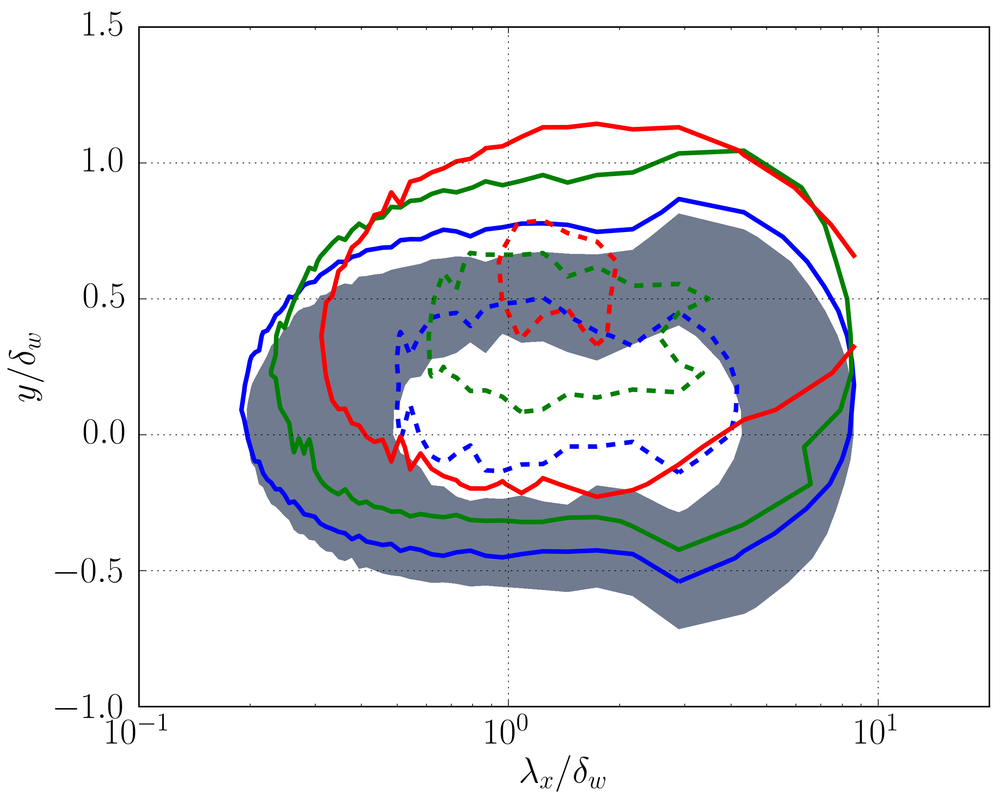

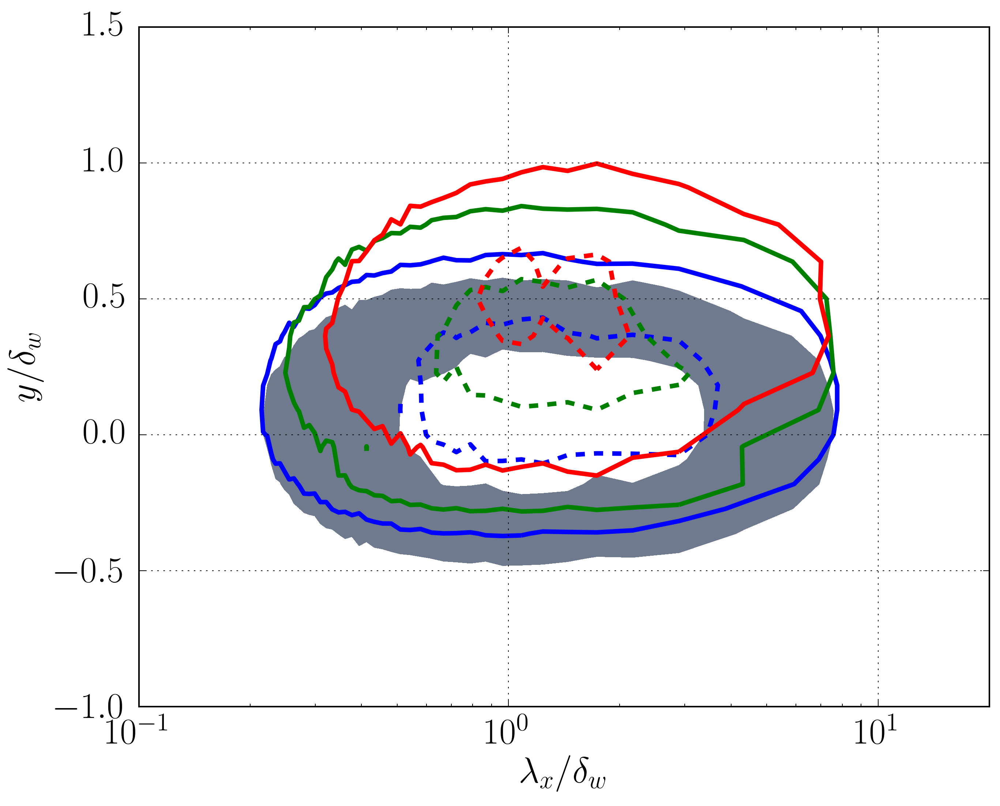

In [689]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[0,1,2] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m =401; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 23;
kmax = 0.0;

mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdaE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1[ijob]
            tmax=SS2[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_x / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
 
    CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
        CS=plt.contour(2*pi/kbin[1:],ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

In [690]:
print Tmax

[1.0, 1.4999999999999998, 2.5, 4.5]


kmax = 579.612143533
yvslambdazEuu
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, plane numbers = 21
Max countM = 230.0, plane numbers = 21
maximorum=0.0256434359701
/share/drive/toni/JFM_lomacte2/yvslambdazEuu.eps figure saved!
yvslambdazEvv
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, 

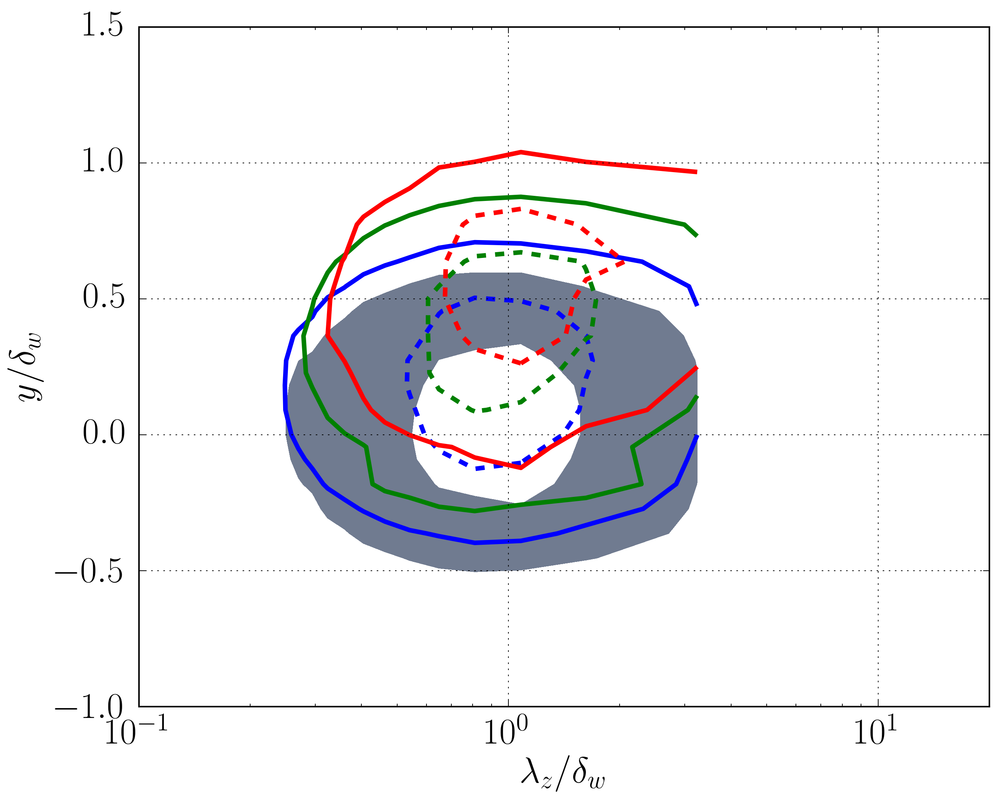

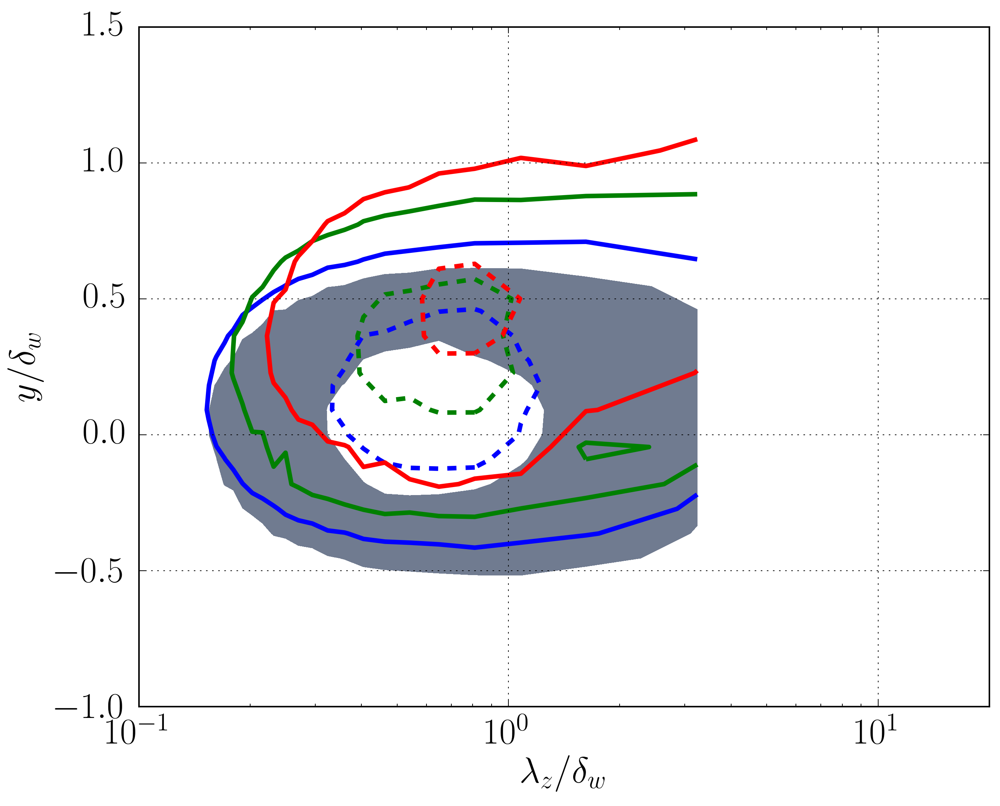

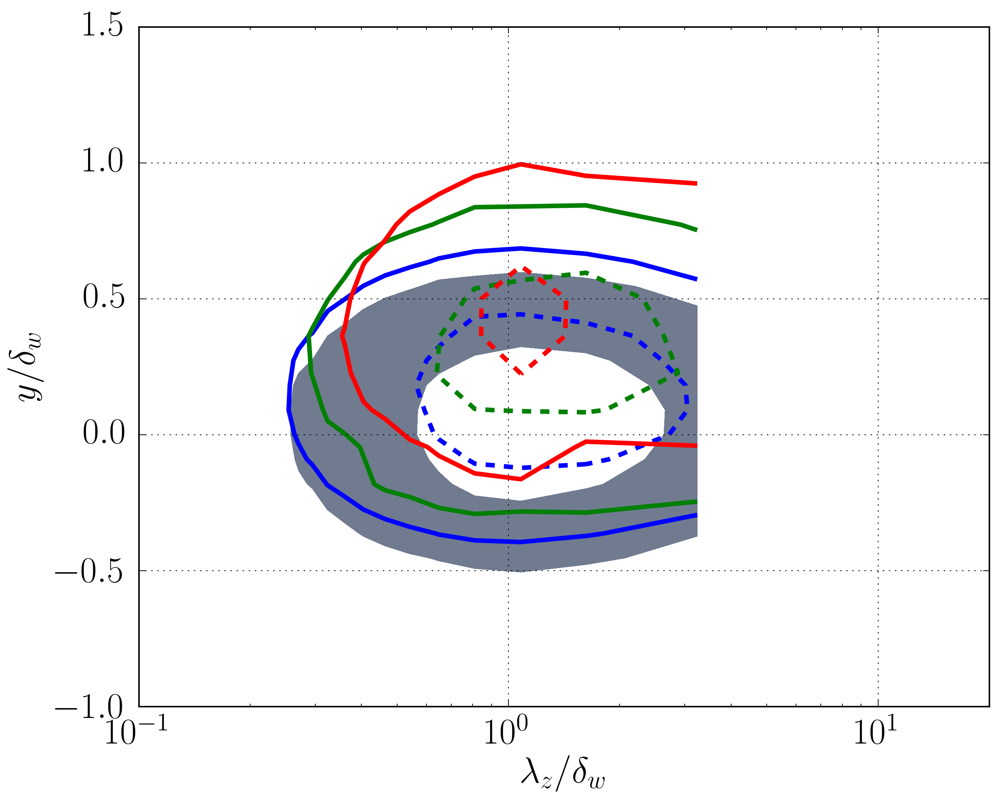

In [691]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[0,1,2] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=1
m =300 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 23;
kmax = 0.0;

mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdazE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1[ijob]
            tmax=SS2[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_z / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
 
    CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
        CS=plt.contour(2*pi/kbin[1:],ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

kmax = 289.798094657
yvslambdaETT
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, plane numbers = 21
Max countM = 230.0, plane numbers = 21
maximorum=0.0108311546154
/share/drive/toni/JFM_lomacte2/yvslambdaETT.eps figure saved!


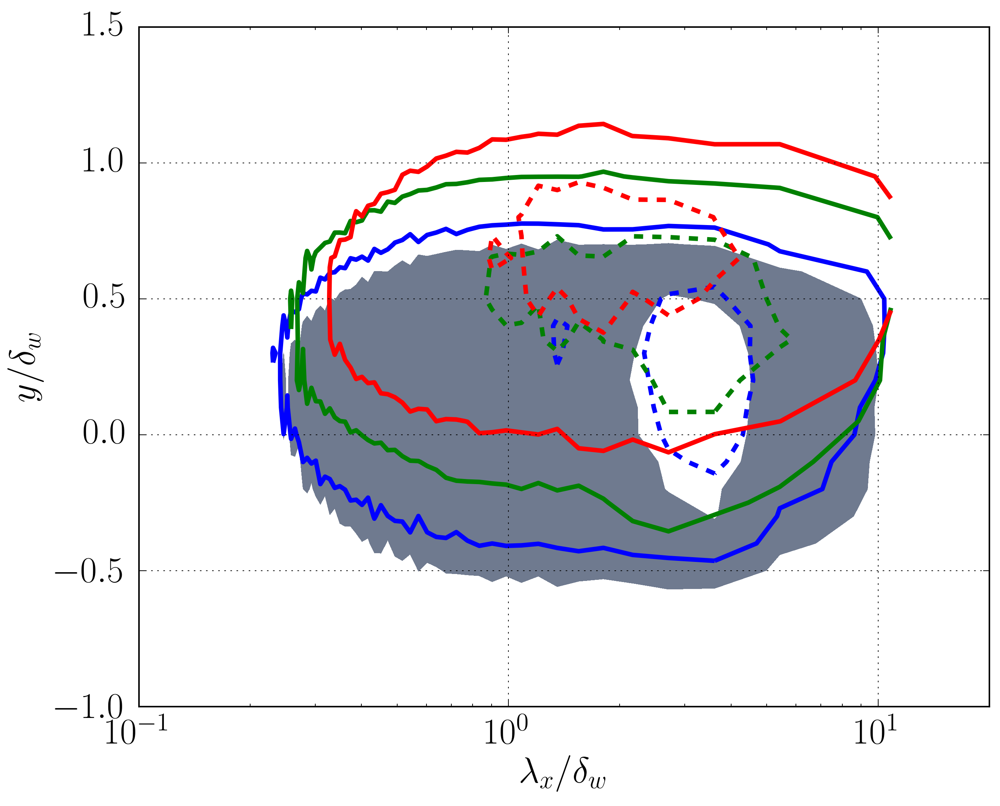

In [692]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[11] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
sumaxis=0 #sum z -> then you get x
#sumaxis=1 #sum x -> then you get z
m =501; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 21;
kmax = 0.0;
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdaE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1[ijob]
            tmax=SS2[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_x / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
 
    CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        levels=[maximorum*0.2*DT[icases]**2,maximorum*0.7*DT[icases]**2]
        Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
        CS=plt.contour(2*pi/kbin[1:],ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

kmax = 579.612143533
yvslambdazETT
Max countM = 24.0, plane numbers = 30
Max countM = 56.0, plane numbers = 30
Max countM = 92.0, plane numbers = 30
Max countM = 36.0, plane numbers = 30
Max countM = 66.0, plane numbers = 30
Max countM = 94.0, plane numbers = 30
Max countM = 64.0, plane numbers = 21
Max countM = 138.0, plane numbers = 21
Max countM = 204.0, plane numbers = 21
Max countM = 86.0, plane numbers = 21
Max countM = 140.0, plane numbers = 21
Max countM = 230.0, plane numbers = 21
maximorum=0.0154804321043
/share/drive/toni/JFM_lomacte2/yvslambdazETT.eps figure saved!


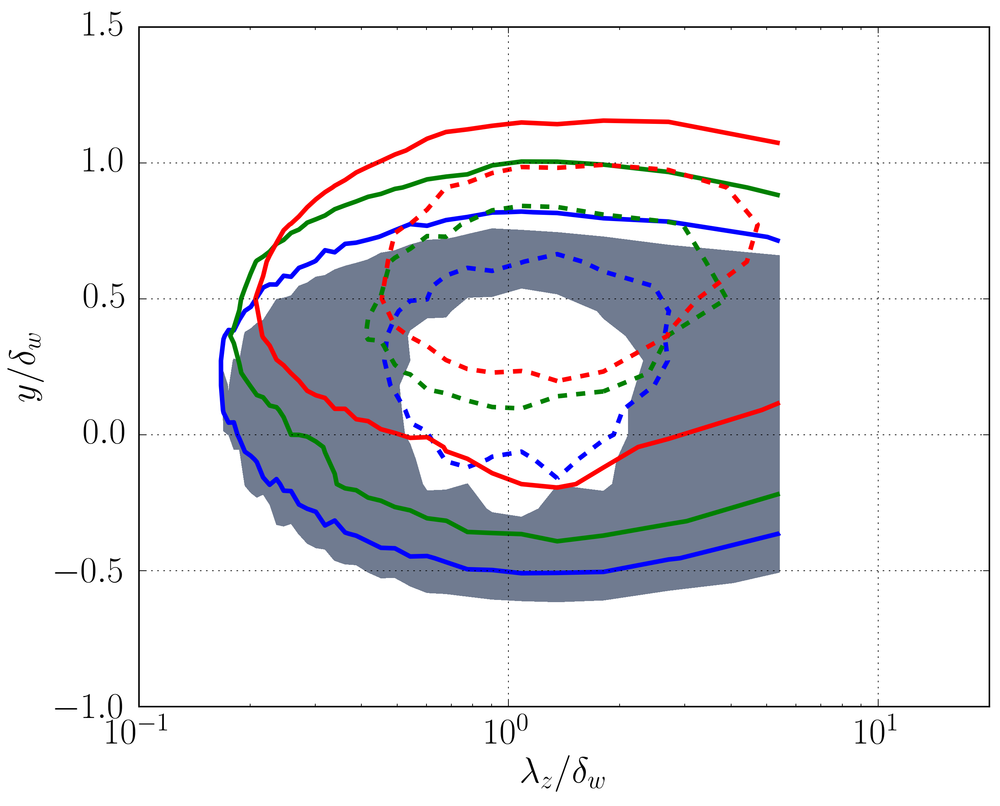

In [693]:
import scipy.ndimage as ndimage
#All together
# Variables we want!
lvariable=[11] #u,v,w
#lvariable=[0] #u,v,w
#lvariable=[0] #u,v,w
#lnamevariable=['u','v','w','T']
lnamevariable=['u','v','w','uvre','uvim','ome1','ome2','ome3','rhou','rhov','rhow','T']
#var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
#           '$\rho v$':9,'$\rho w$':10,'T':11}
fformat = '.eps'

#Initialization
#------------------------------------------------------------
#sumaxis=0 #sum z -> then you get x
sumaxis=1 #sum x -> then you get z
m =501; #(for x)
#m =256 #(for z)
scaling = 'dw'
jlist =arange(0,12)
Nkbins =m;
Nydbins = 23;
kmax = 0.0;
mx=512;
mz=384;
for ijob in jlist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        time  = np.array(f['time'])
        delta = np.array(f[scaling] )
        y = np.array(f['y'])
        alp = np.array(f['alp'])
        bet = np.array(f['bet'])
    it1 = where(time>=tmin)[0][0]
    it2 = where(time>=tmax)[0][0]
    if sumaxis==0:
        kmax = max(mx*alp[0]*delta[it2],kmax) #kx*delta
        lbin = np.linspace(0,(2*pi/alp)/delta[it1],Nkbins)
    else:
        kmax = max(mz*bet[0]*delta[it2],kmax) #kz*delta
        lbin = np.linspace(0,(2*pi/bet)/delta[it1],Nkbins)
kbin = np.linspace(0,kmax,Nkbins)
print "kmax = %s"%kmax
#------------------------------------------------------------


for variable in lvariable:
    figname = 'yvslambdazE'+lnamevariable[variable]*2
    print figname
    MspectraCASE=[[],[],[],[]]
    ydbin=[[],[],[],[]]
    #ydbin = np.linspace(-1.0,1.0,Nydbins)
    scaling='dw'
    ydmin=[-1.0,-1.0,-1.0,-1.0]
    ydmax=[1.0,1.0,2,2]
    #for icases in range(ncases):
    for icases in [0,1,2,3]:
        matrix = np.zeros([Nkbins,Nydbins])
        countM = np.zeros([Nkbins,Nydbins])
        ydbin[icases] = np.linspace(ydmin[icases],ydmax[icases],Nydbins)
        for ijob in lcases[icases]:
            tmin=SS1[ijob]
            tmax=SS2[ijob]
            path = p_folders[ijob]
            with h5py.File(path,"r") as f:
                time  = np.array(f['time'])
                delta = np.array(f[scaling] )
                y = np.array(f['y'])
            for nplane in range(0,nmaxplanes[ijob],1):
                path = p_folders_spe[ijob][nplane]
            #print "opening path= %s" %path
        #[matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
        #                             kbin,ydbin,matrix,countM);   
            #This work for each plane
                [matrix,countM]=accumSpectra(path,vplanes[ijob][nplane],y,delta,variable,tmin,tmax, sumaxis, \
                                         kbin,ydbin[icases],matrix,countM);#use lambda  
            
            print "Max countM = %s, plane numbers = %s"%(countM.max(),nmaxplanes[ijob]-1)
    #Clean zeros from countM
        lenx,leny = np.shape(matrix)
        for i in range(lenx):
            for j in range(leny):
                if countM[i,j]==0:
                    countM[i,j]=1
        MspectraCASE[icases]=matrix/countM
    
    maximorum = 0.0
    for icases in [0]:
        maximorum = max(np.max(kbin[1:]*MspectraCASE[icases][1:,:].transpose()),maximorum)
        
    print "maximorum=%s"%maximorum 
    
    fig = plt.figure()
    ax = fig.add_subplot(111)
    plt.grid('on')
    vcolors=['black','blue','green','red']
    plt.ylim([-1.0,1.5])
    plt.xscale('log')
    plt.xlabel(r'$\lambda_z / \delta_w$')
    plt.ylabel(r'$y/\delta_w$')
    plt.xlim([0.1,20])
    origin = 'lower'
#Special for s=1
    icases=0
    levels=[maximorum*0.2,maximorum*0.7]
    #Put NAN on zeros
    for jj in range(len(ydbin[icases])):
        if np.sum(MspectraCASE[icases][1:,jj])==0.0:
            for i in range(1,len(kbin)):
                MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
    #Z2 = ndimage.gaussian_filter(MspectraCASE[icases][1:,:], sigma=0.2, order=0)
    #Z2=kbin[1:]*Z2.transpose()
    Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
 
    CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],Z2,levels=levels,                  #alpha=0.5,
                      cmap=plt.cm.bone,origin=origin)

    for icases in [1,2,3]:
#        #Put NAN on zeros
        for jj in range(len(ydbin[icases])):
            if np.sum(MspectraCASE[icases][1:,jj])==0.0:
                for i in range(1,len(kbin)):
                    MspectraCASE[icases][i,jj]=np.float('nan') #Write NAN in that line
        #Z2 = ndimage.gaussian_filter(kbin[1:]*(MspectraCASE[icases][1:,:]).transpose(), sigma=1.0, order=0)
        #icases
        levels=[maximorum*0.2*DT[icases]**2,maximorum*0.7*DT[icases]**2]
        Z2 = kbin[1:]*MspectraCASE[icases][1:,:].transpose()
        CS=plt.contour(2*pi/kbin[1:],ydbin[icases],Z2,linestyles=(['solid','dashed']),linewidths=(3,),levels=levels,colors=vcolors[icases],hold='on')
    #Save figure
    
    pathname = save_folder + figname + fformat
    print "%s figure saved!"%pathname
    fig.savefig(pathname,bbox_inches='tight')

In [694]:
print DT, Tmax

[[], 0.75, 1.875, 3.9375] [1.0, 1.4999999999999998, 2.5, 4.5]


In [1426]:
MscaledCASE = np.zeros(np.shape(MspectraCASE))
for icases in [0,1,2,3]:
    for iyb in range(len(ydbin[icases])):
        maxE=np.max(MspectraCASE[icases][1:,iyb])
        if maxE!=0.0:
            MscaledCASE[icases][1:,iyb]=kbin[1:]*MspectraCASE[icases][1:,iyb]/maxE

In [1427]:
maximorum = 0.0
maximorum = np.max(MscaledCASE[:][1:,:])
print maximorum

1.93443747535


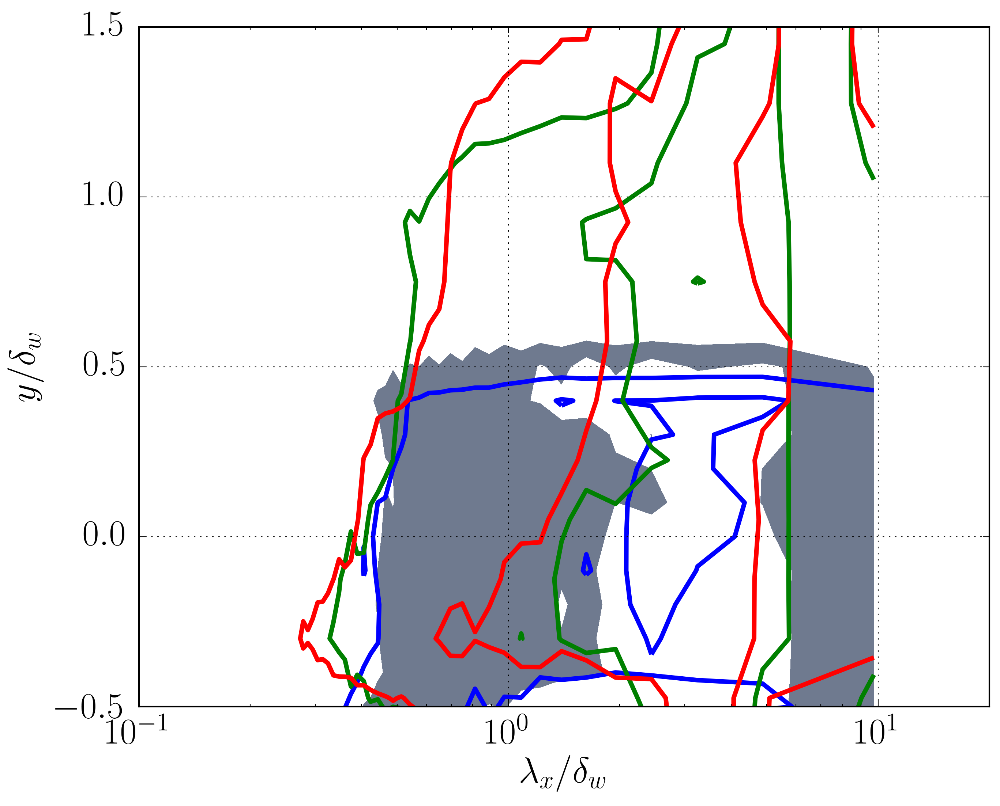

In [1432]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.grid('on')
vcolors=['black','blue','green','red']
plt.ylim([-0.5,1.5])
plt.xscale('log')
plt.xlabel(r'$\lambda_x / \delta_w$')
plt.ylabel(r'$y/\delta_w$')
plt.xlim([0.1,20])
origin = 'lower'
#Special for s=1
icases=0
levels=[maximorum*0.2,maximorum*0.6]
CSF=plt.contourf(2*pi/kbin[1:],ydbin[icases],MscaledCASE[icases][1:,:].transpose(),levels=levels,                  #alpha=0.5,
                  cmap=plt.cm.bone,
                  origin=origin)

for icases in [1,2,3]:
    CS=plt.contour(2*pi/kbin[1:],ydbin[icases],MscaledCASE[icases][1:,:].transpose(),linewidths=(3,),levels=CSF.levels,colors=vcolors[icases],hold='on')
    # Label levels with specially formatted float
    #plt.clabel(CS, CS.levels)
#plt.clabel(CS, CS.levels, inline=False, fmt=fmt, fontsize=10)
#CB = plt.colorbar(CS, shrink=0.8, extend='both')
#plt.clabel(CS, CS.levels)

In [567]:
print vplanes

[array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230,
       235, 240, 245, 250, 255, 260, 265, 227], dtype=uint32), array([350, 375, 400, 425, 450, 475, 500, 525, 550, 575, 600, 625, 650,
       675, 700, 725, 750, 775, 800, 825, 850, 551], dtype=uint32), array([350, 375, 400, 425, 450, 475, 500, 525, 55

# Conventional spectra

In [687]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe[ijob]=path[0:-5]+fnplane+'.spes'
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

0
/share/drive/toni/Re160s10/case1/SS/h5.mid.spes
1
/share/drive/toni/Re160s10/case2/SS/h5.mid.spes
2
/share/drive/toni/Re160s10/case3/SS/h5.mid.spes
3
/share/drive/toni/Re160s20/case1/SS/h5.mid.spes
4
/share/drive/toni/Re160s20/case2/SS/h5.mid.spes
5
/share/drive/toni/Re160s20/case3/SS/h5.mid.spes
6
/share/drive/toni/Re160s40/case1/y2/h5.mid.spes
7
/share/drive/toni/Re160s40/case2/y2/h5.mid.spes
8
/share/drive/toni/Re160s40/case3/y2/h5.mid.spes
9
/share/drive/toni/Re160s80/case1/y2/h5.mid.spes
10
/share/drive/toni/Re160s80/case2/y2/h5.mid.spes
11
/share/drive/toni/Re160s80/case3/y2/h5.mid.spes
[[100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 227, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390], [100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 227, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390], [100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 227, 230, 240, 25

In [589]:
print vplanes[11]

[350 375 400 425 450 475 500 525 550 575 600 625 650 675 700 725 750 775
 800 825 850 551]


# Spectra for s=1

# Spectra for s=4

In [891]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[8]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob],1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

opening path= /share/drive/toni/Re160s40/case3/y2/h5.350.spes
y(nplane)=-45.5812948526
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.375.spes
y(nplane)=-39.9110192661
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.400.spes
y(nplane)=-34.2415063858
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.425.spes
y(nplane)=-28.5722681636
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.450.spes
y(nplane)=-22.9031288419
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.475.spes
y(nplane)=-17.234025132
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.500.spes
y(nplane)=-11.564934245
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.525.spes
y(nplane)=-5.89584797524
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.550.spes
y(nplane)=-0.226763367946
25 77
(512, 110)
opening path= /share/drive/toni/Re160s40/case3/y2/h5.575.spes
y(n

-1.5919718577 2.37160992097
(1144, 501) (1144,)


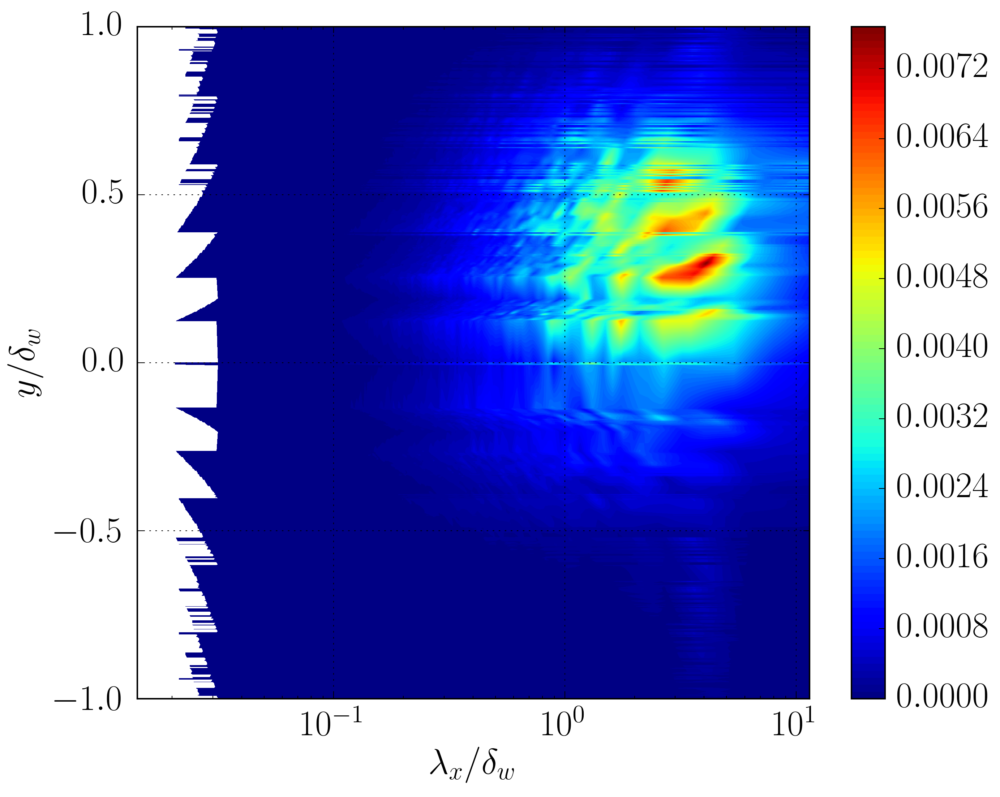

In [892]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1],100)
plt.ylim([-1,1])
plt.xscale('log')
plt.grid('on')
plt.colorbar()

In [919]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[2]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob]-1,1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

opening path= /share/drive/toni/Re160s10/case3/h5.170.spes
y(nplane)=-11.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.175.spes
y(nplane)=-10.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.180.spes
y(nplane)=-9.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.185.spes
y(nplane)=-8.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.190.spes
y(nplane)=-7.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.195.spes
y(nplane)=-6.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.200.spes
y(nplane)=-5.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.205.spes
y(nplane)=-4.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.210.spes
y(nplane)=-3.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.215.spes
y(nplane)=-2.4
77 100
(512, 140)
opening path= /share/drive/toni/Re160s10/case3/h5.220.spes
y(nplane)=-1.4
77 1

-0.418438307851 0.278958871901
(460, 501) (460,)


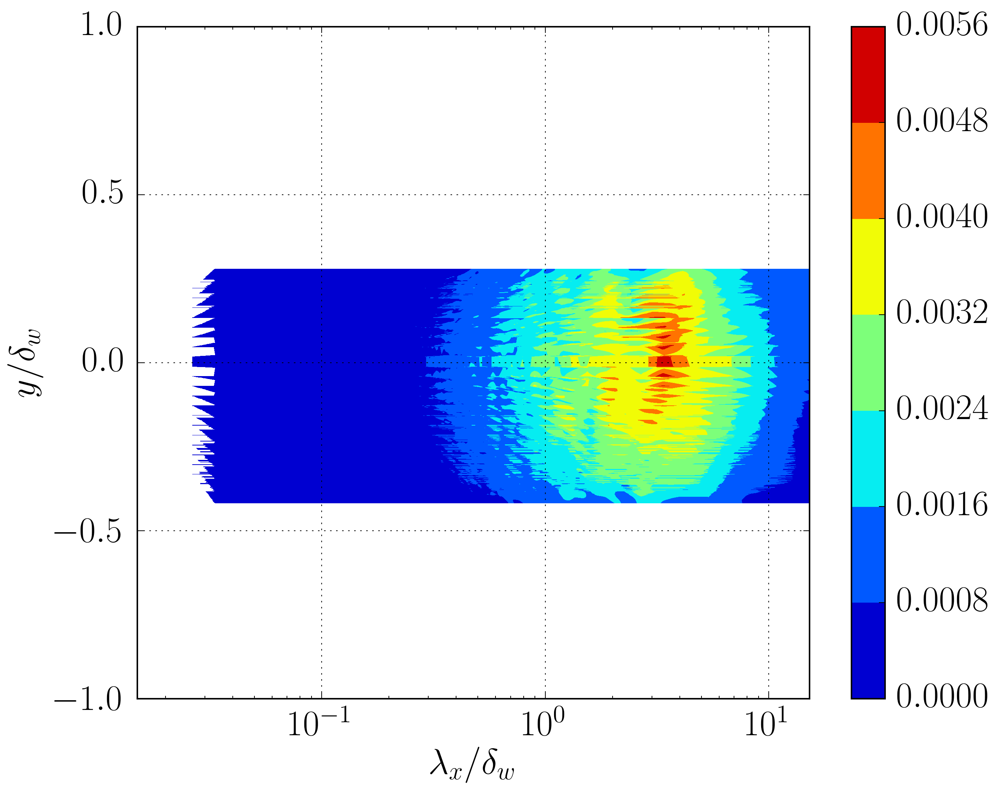

In [920]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1])
plt.xscale('log')
plt.ylim([-1,1])
plt.grid('on')
plt.colorbar()

In [909]:
scaling='dw'
sumaxis=0
variable=0
Npoints=500;
ydeltaBIG=[]
fjob=True
joblist=[9]
count=1
iplane = 0
for ijob in joblist:
    tmin=SS1[ijob]
    tmax=SS2[ijob]
    pathSTA = p_folders[ijob]
    for nplane in range(0,nmaxplanes[ijob]-1,1):
        path = p_folders_spe[ijob][nplane]
        print "opening path= %s" %path
        [xik,ydelta,SPEC,timev,modes00]=getSpectra2(path,vplanes[ijob][nplane],pathSTA,variable,tmin,tmax, sumaxis,scaling)
        itimes=len(ydelta)
        if nplane==0 and fjob==True:
            matrix = np.zeros([itimes,Npoints+1])
            matrix[:,-1]=ydelta
            fjob=False
        else:
            mm = np.zeros([itimes,Npoints+1])
            mm[:,-1] = ydelta
            matrix = r_[matrix,mm]
        matrix[count*iplane*itimes:(count*iplane*itimes+itimes),:-1] = SPEC
        iplane+=1
    count+=1
    
    # scatter with colormap mapping to z value
matrix = matrix[matrix[:,-1].argsort()]
#print matrix[0,-1],matrix[-1,-1]
ydeltaBIG= matrix[:,-1]

opening path= /share/drive/toni/Re160s80/case1/y2/h5.350.spes
y(nplane)=-45.5812948526
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.375.spes
y(nplane)=-39.9110192661
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.400.spes
y(nplane)=-34.2415063858
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.425.spes
y(nplane)=-28.5722681636
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.450.spes
y(nplane)=-22.9031288419
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.475.spes
y(nplane)=-17.234025132
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.500.spes
y(nplane)=-11.564934245
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.525.spes
y(nplane)=-5.89584797524
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.550.spes
y(nplane)=-0.226763367946
88 109
(512, 130)
opening path= /share/drive/toni/Re160s80/case1/y2/h5.575

-1.15151199174 1.71544317855
(441, 501) (441,)


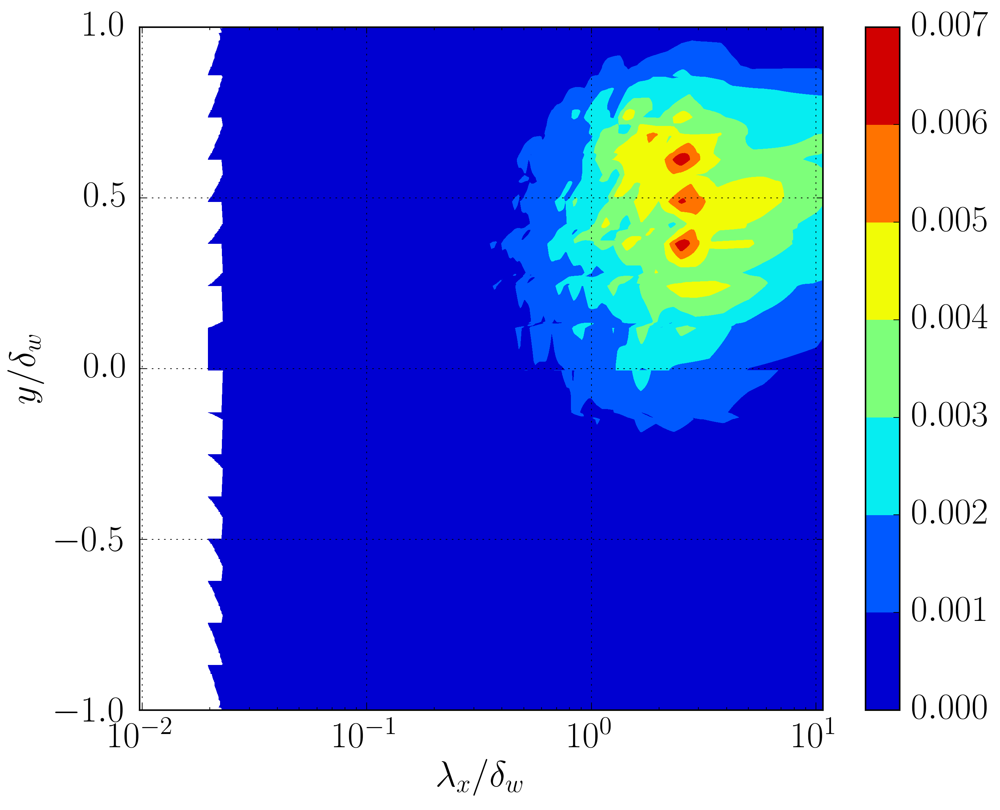

In [910]:
print matrix[0,-1],matrix[-1,-1]
fig = plt.figure()
ax = fig.add_subplot(111)
plt.xlabel(r'$\lambda_x/\delta_w$')
plt.ylabel(r'$y/\delta_w$')
print shape(matrix),shape(ydeltaBIG)
plt.contourf(2*pi/xik,ydeltaBIG,matrix[:,:-1])
plt.ylim([-1,1])
#plt.xlim([0,10])
plt.xscale('log')
plt.grid('on')
plt.colorbar()

In [684]:
print DT

[[], 0.75, 1.875, 3.9375]


# INFINITELY LARGE MODES RATIO EVOLUTION

In [640]:
fnplane='mid'
vplanes=[]
nmaxplanes=[]
for ijob,path in zip(range(len(p_folders)),p_folders):
    print ijob
    p_folders_spe[ijob]=path[0:-5]+fnplane+'.spes'
    print p_folders_spe[ijob]
    path = p_folders_spe[ijob]
    with h5py.File(path,"r") as f:
        v=np.array(f['jsp'])
        vplanes.append(v)
        nmaxplanes.append(len(v))
    #New sorted planes trick
    vplanes[ijob]=sorted(vplanes[ijob])
print vplanes
print nmaxplanes
#scaling = 'dm'
p_folders_spe=[['']*nmaxplanes[ijob] for ijob in range(len(p_folders))]
for ijob,path in zip(range(len(p_folders)),p_folders):
    with h5py.File(path,"r") as g:
        my = len(np.array(g['y']))
        time=np.array(g['time'])
        dd=np.array(g[scaling])
        midplane = my/2+1
        #print "midplane=%s"%midplane
    for nplane,jj in zip(vplanes[ijob],range(nmaxplanes[ijob])):
        if nplane==midplane: #Lastplane
            #print "This is midplane"
            fnplane='mid'
        else:
            fnplane="%03d"%nplane
        p_folders_spe[ijob][jj]=path[0:-5]+fnplane+'.spes'
        #print "Reading spe file: %s" %(pathSPE)

0
/share/drive/toni/Re160s10/case1/h5.mid.spes
1
/share/drive/toni/Re160s10/case2/h5.mid.spes
2
/share/drive/toni/Re160s10/case3/h5.mid.spes
3
/share/drive/toni/Re160s20/case1/h5.mid.spes
4
/share/drive/toni/Re160s20/case2/h5.mid.spes
5
/share/drive/toni/Re160s20/case3/h5.mid.spes
6
/share/drive/toni/Re160s40/case1/y2/h5.mid.spes
7
/share/drive/toni/Re160s40/case2/y2/h5.mid.spes
8
/share/drive/toni/Re160s40/case3/y2/h5.mid.spes
9
/share/drive/toni/Re160s80/case1/y2/h5.mid.spes
10
/share/drive/toni/Re160s80/case2/y2/h5.mid.spes
11
/share/drive/toni/Re160s80/case3/y2/h5.mid.spes
[[170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 227, 230, 235, 240, 245, 250, 255, 260, 265], [170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 227, 230, 235, 240, 245, 250, 255, 260, 265], [170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 227, 230, 235, 240, 245, 250, 255, 260, 265], [170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 227, 230, 235, 240, 245, 250, 255

In [62]:
def getSpectracase(p_folders,nplane,p_foldersSTA,lcases,variable,scaling,SS1,SS2,sumaxis,Npoints=1000):
    """
    returns as many vectors as cases wanted to compute.
    Distribution of cases is given in lcases(ex. lcases = [[0,1,2],[3,5]])
    return only one profile per case
    """
    ncases = len(lcases)
    fycases = [[] for i in range(ncases)]
    vt = []
    f00 = []
    ycases = [[] for i in range(ncases)]
    ferrorcases = [[] for i in range(ncases)]
    for icase in range(ncases):
        vpcases = []
        vpcasesSTA=[]
        nacum = 0
        fy = np.zeros(Npoints)
        yf = [[]for i in range(len(lcases[icase]))]
        fy= [[]for i in range(len(lcases[icase]))]
        ferror = [[] for i in range(len(lcases[icase]))]
        nn=len(lcases[icase])
        for ijob in lcases[icase]:
            vpcases    = vpcases    + [p_folders[ijob]]
            vpcasesSTA = vpcasesSTA + [p_foldersSTA[ijob]]
        for path,i in zip(vpcases,range(len(vpcases))):
            ijob = lcases[icase][i]
            pathSTA = vpcasesSTA[i]
            print ijob
            yf[i],fy[i],ferror[i],tt,kk,ydmEVO = getSpectra(path,nplane,pathSTA,variable,SS1[ijob],SS2[ijob],sumaxis,scaling,Npoints)
            vt.append(tt)
            f00.append(kk)
        ycases[icase]=yf
        print "y/delta evolution with time: %s"%(ydmEVO)
        fycases[icase]=np.mean(fy,axis=0)
        ferrorcases[icase]=np.max(ferror,axis=0)
    return ycases,fycases,ferrorcases,vt,f00,ydmEVO

In [63]:
def getSpectravstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkx0  = np.sum(funSPE[:,0,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kx,range(len(kx))):
            res += np.sum(funSPE[:,ii,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkx0,funRest,fun00

In [70]:
def getSpectrazvstime(path,nplane,variable):
    """
    Obtain scaled spectra averaged in the given time span
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;

        
        #funSPE = np.array(f['SPEC'][1:,variable,1:,:]);
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        fun00 = funSPE[0,0,:]
        for tt in range(len(time)):
            funSPE[0,0,tt]=0.0
        funkz0  = np.sum(funSPE[0,:,:],axis=0)
        res=time*0.0
        for kk,ii in  zip(kz,range(len(kz))):
            res += np.sum(funSPE[ii,:,:],axis=0)
        funRest = res
        #funRest = np.sum(kx[1:]*np.sum(kz[:]*funSPE[1:,0:,:],axis=1),axis=0)
        #lamxMax=np.pi/kx[1]
        #lamxMin=lamxMax/mx
        #lamzMax=np.pi/kz[1]
        #lamzMin=lamzMax/mz
    return kx,kz,time,funkz0,funRest,fun00

In [64]:
var_ind = {'u':0,'v':1,'w':2,'$uv_{re}$':3,'$uv_{im}$':4,'$\omega_1$':5,'$\omega_2$':6,'$\omega_3$':7,'$\rho u$':8,\
           '$\rho v$':9,'$\rho w$':10,'T':11}
ind_var = {v: k for k, v in var_ind.items()}
var_name = ['u','v','w','$\omega_2$','T']
nvar = len(var_name)+1
print "You will analyse a total of %s variables." %nvar
var_list = []
for j in range(len(var_name)):
    var_list.append(var_ind[var_name[j]])
print var_list

You will analyse a total of 6 variables.
[0, 1, 2, 6, 11]


In [65]:
#Define index of variables SPECTRA
#----------------------------------------
iu = 0 #index of variable
iv = 1
iw = 2
iT = 11
iome1 = 5
iome2 = 6
iome3 = 7

In [632]:
def integralSpectravstime(p_folders_spe,vplanes,y,variable, sumaxis):
    """
    Spectra vs time integrated MAKE SURE PLANE NAMES ARE ORDERED
    """
    if sumaxis==0:
        yplanes = y[np.subtract(vplanes,1)]#Create vector with position of planes
        Dyplanes = y[np.subtract(vplanes,1)] #Create Dyplanes
        for j in range(1,len(Dyplanes)-1):
            Dyplanes[j]=(yplanes[j+1]-yplanes[j-1])/2.0
        Dyplanes[0]=(yplanes[1]-yplanes[0])/2.0
        Dyplanes[-1]=(yplanes[-1]-yplanes[-2])/2.0
        for iplane in range(len(vplanes)):
            #Initializing
            if iplane==0:
                path = p_folders_spe[iplane]
                [kx,kz,time,intSPECtime0,intSPECtimeRest,fun00]=getSpectravstime(path,iplane,variable)
                intSPECtime0 = intSPECtime0*Dyplanes[iplane]
                intSPECtimeRest = intSPECtimeRest*Dyplanes[iplane]
            else:
                path = p_folders_spe[iplane]
                [kx,kz,time,funkx0,funRest,fun00]=getSpectravstime(path,iplane,variable)
                intSPECtime0 += funkx0*Dyplanes[iplane]
                intSPECtimeRest += funRest*Dyplanes[iplane]
    elif sumaxis==1:
        yplanes = y[np.subtract(vplanes,1)]#Create vector with position of planes
        Dyplanes = y[np.subtract(vplanes,1)] #Create Dyplanes
        for j in range(1,len(Dyplanes)-1):
            Dyplanes[j]=(yplanes[j+1]-yplanes[j-1])/2.0
        Dyplanes[0]=(yplanes[1]-yplanes[0])/2.0
        Dyplanes[-1]=(yplanes[-1]-yplanes[-2])/2.0
        for iplane in range(len(vplanes)):
            #Initializing
            if iplane==0:
                path = p_folders_spe[iplane]
                [kx,kz,time,intSPECtime0,intSPECtimeRest,fun00]=getSpectrazvstime(path,iplane,variable)
                intSPECtime0 = intSPECtime0*Dyplanes[iplane]
                intSPECtimeRest = intSPECtimeRest*Dyplanes[iplane]
            else:
                path = p_folders_spe[iplane]
                [kx,kz,time,funkx0,funRest,fun00]=getSpectrazvstime(path,iplane,variable)
                intSPECtime0 += funkx0*Dyplanes[iplane]
                intSPECtimeRest += funRest*Dyplanes[iplane]            
                
    return kx,kz,time,intSPECtime0,intSPECtimeRest
 


In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{u_i u_i}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{u_i u_i}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'modeskx0ratioEnergy'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,funu1,fun2u] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,0,sumaxis)
    [kx,kz,time,funv1,fun2v] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,1,sumaxis)
    [kx,kz,time,funw1,fun2w] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,2,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],((funu1+funv1+funw1)/(fun2u+fun2v+fun2w))[0:itmax]*100,l_job_style[ijob/3],lw=2.0)
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure %s saved!"%pathname

ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6

In [ ]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{u_i u_i}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{u_i u_i}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'modeskz0ratioEnergy'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,funu1,fun2u] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,0,sumaxis)
    [kx,kz,time,funv1,fun2v] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,1,sumaxis)
    [kx,kz,time,funw1,fun2w] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,2,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],((funu1+funv1+funw1)/(fun2u+fun2v+fun2w))[0:itmax]*100,l_job_style[ijob/3],lw=2.0)
if PRINT == True:
    pathname = save_folder + figname+ fformat
    fig.savefig(pathname,bbox_inches='tight')
    print "Figure %s saved!"%pathname

ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6
ijob=7
ijob=8
ijob=9
ijob=10
ijob=11


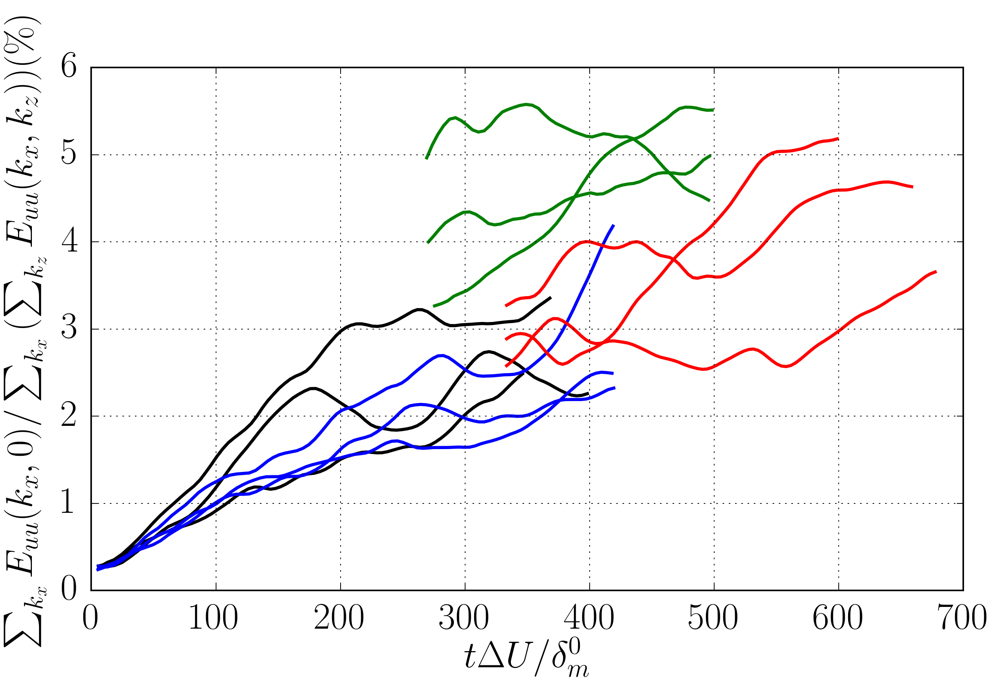

In [641]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=0
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{uu}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6
ijob=7
ijob=8
ijob=9
ijob=10
ijob=11


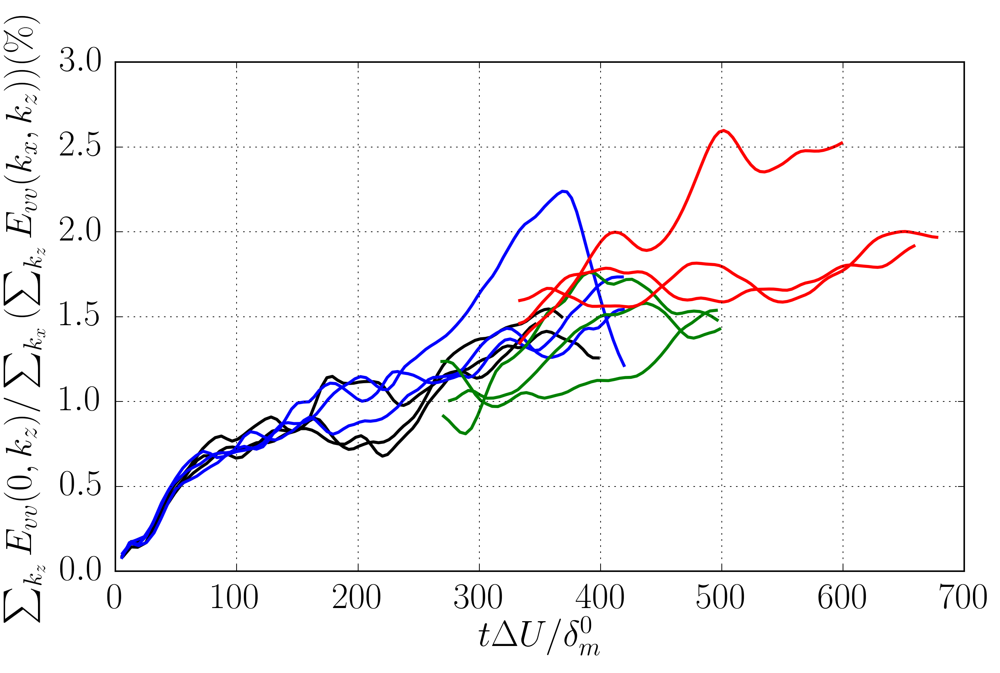

In [642]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=1
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{vv}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6
ijob=7
ijob=8
ijob=9
ijob=10
ijob=11


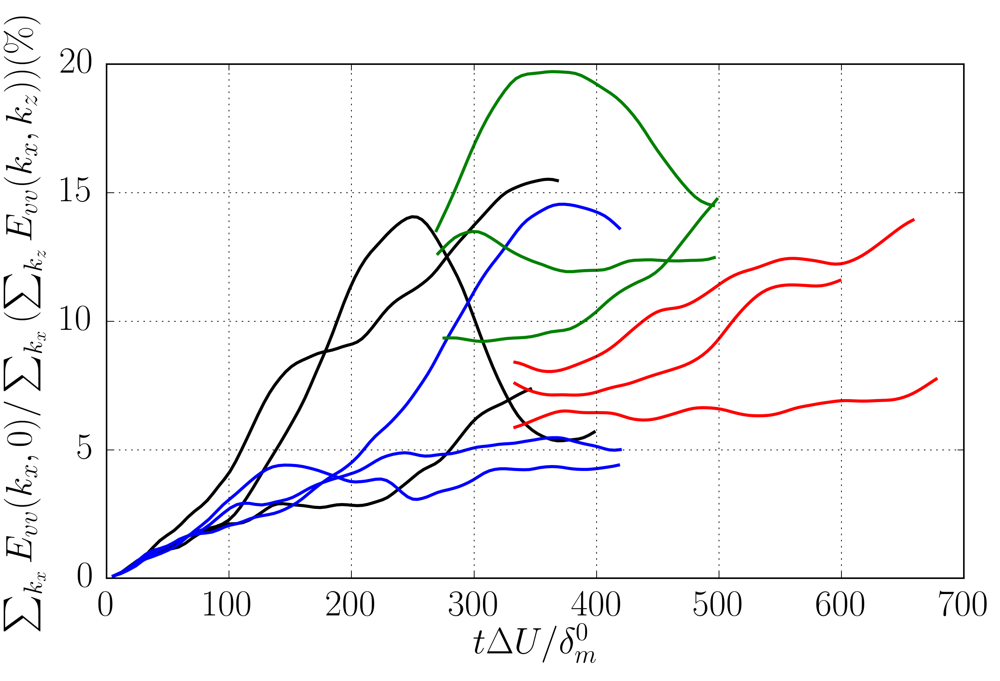

In [643]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=1
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{vv}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [646]:
print SS2

[350, 370, 400, 420.0, 420, 420, 500, 500, 500, 660, 600, 680]


ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6
ijob=7
ijob=8
ijob=9
ijob=10
ijob=11


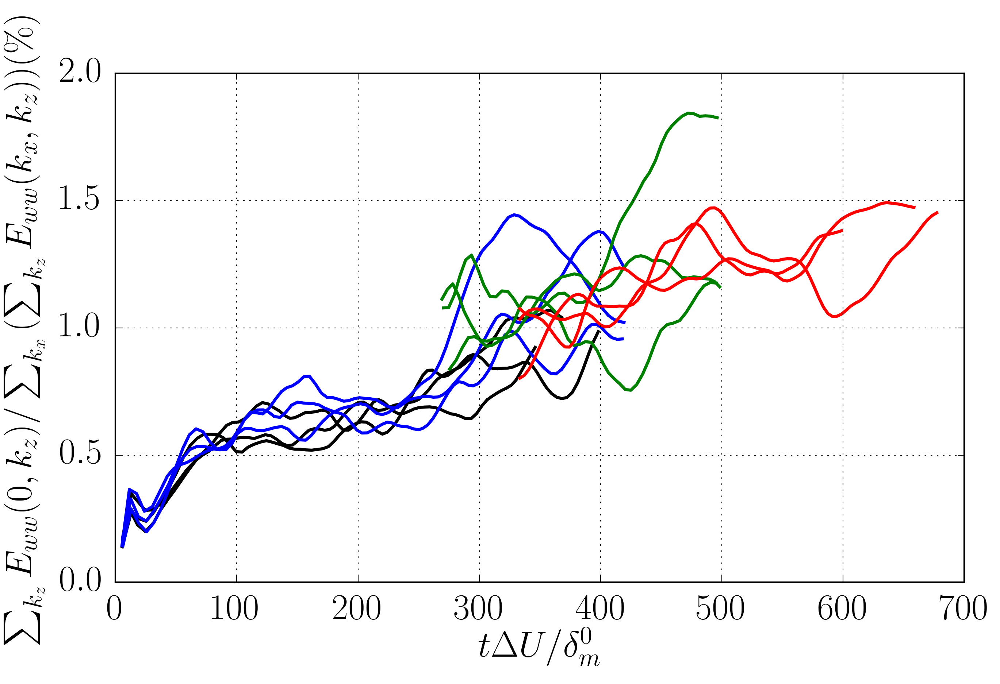

In [644]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=0;
variable=2
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{ww}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

ijob=0
ijob=1
ijob=2
ijob=3
ijob=4
ijob=5
ijob=6
ijob=7
ijob=8
ijob=9
ijob=10
ijob=11


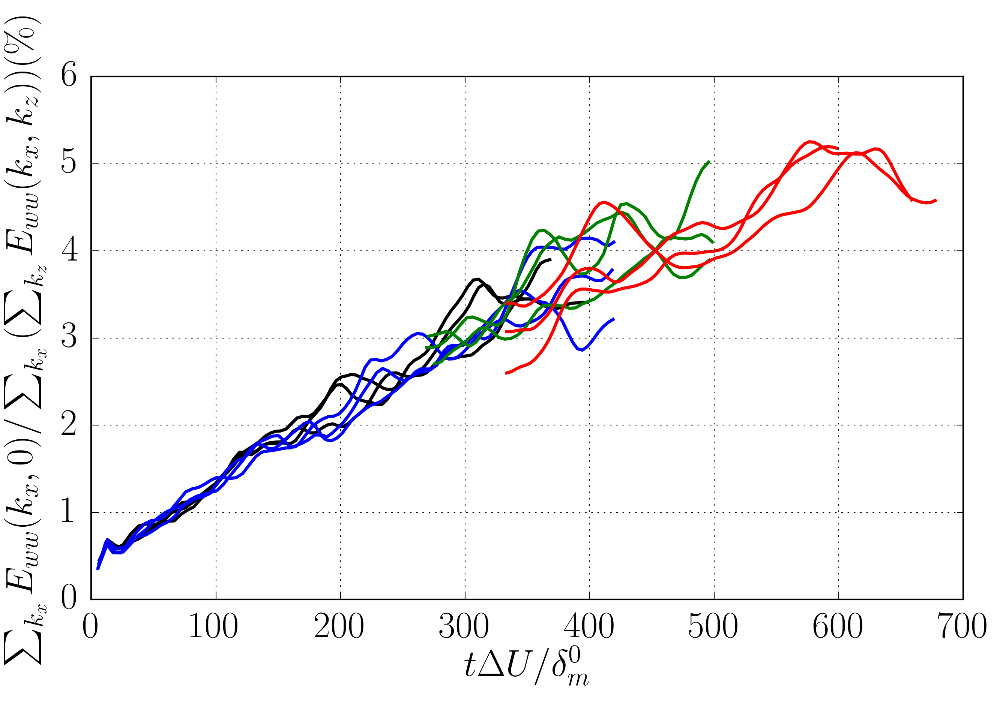

In [645]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)
sumaxis=1;
variable=2
#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{ww}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    print "ijob=%s"%ijob
    #print vplanes[ijob]
    path = p_folders[ijob]
    with h5py.File(path,"r") as f:
        y=np.array(f['y'])
    [kx,kz,time,fun1,fun2] = integralSpectravstime(p_folders_spe[ijob],vplanes[ijob],y,variable,sumaxis)
    itmax = where(time>=SS2[ijob])[0][0]
    plt.plot(time[:itmax],(fun1/fun2)[0:itmax]*100,l_job_style[ijob/3],lw=2.0)

In [631]:
print p_folders[9]

/share/drive/toni/Re160s80/case1/y2/h5.stats


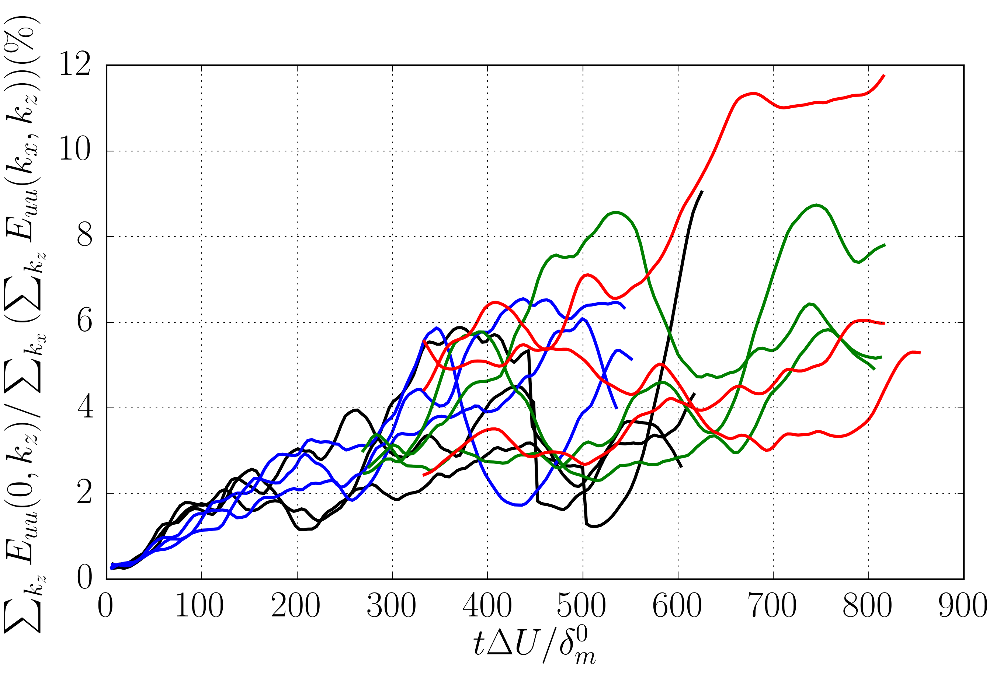

In [69]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{uu}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,0)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

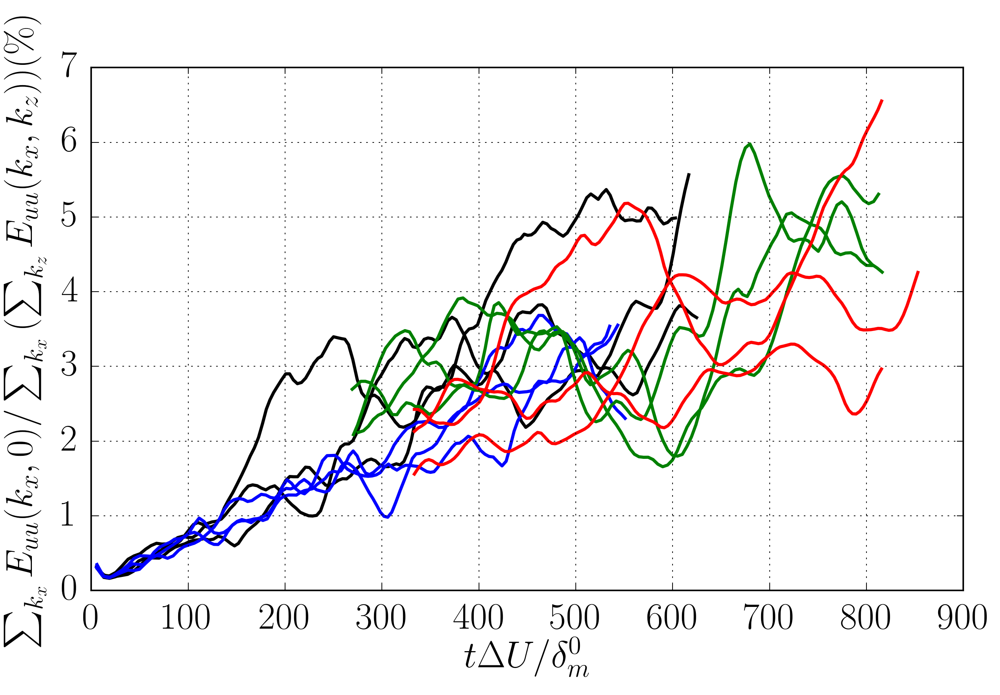

In [71]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{uu}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{uu}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,0)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

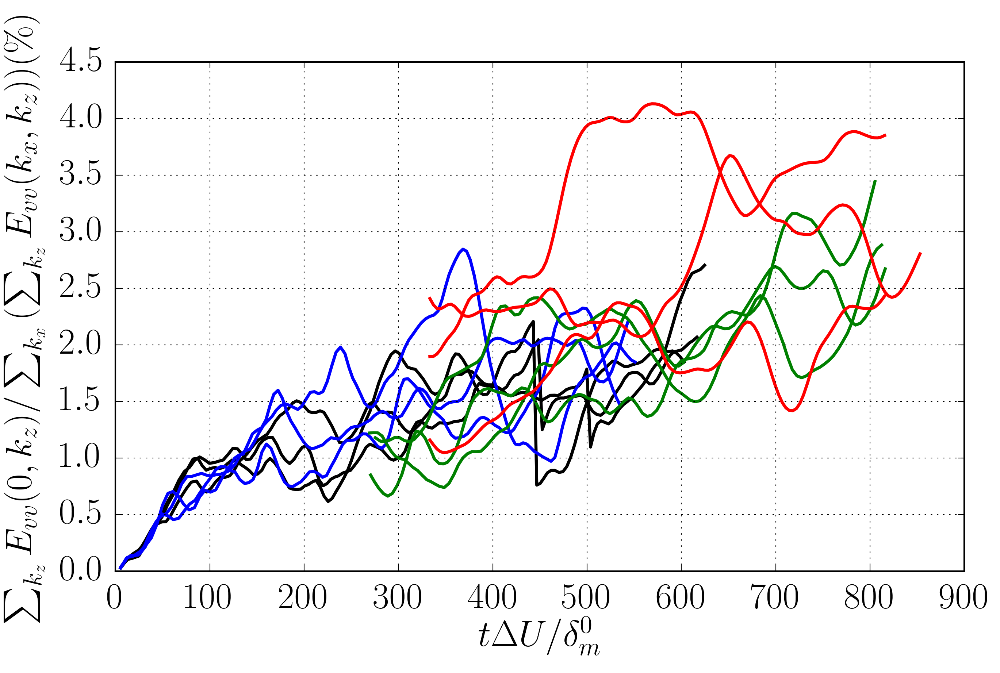

In [76]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{vv}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,1)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

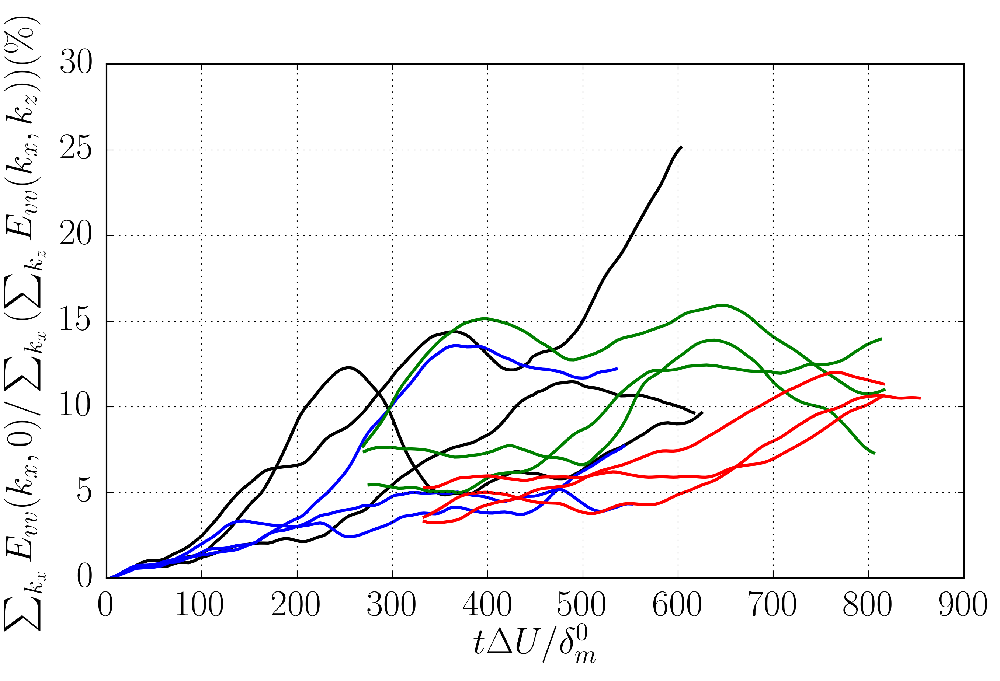

In [72]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{vv}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{vv}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,1)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

In [74]:
print SS1

[230, 230, 210, 270.0, 270, 270, 340, 320, 340, 500, 500, 510]


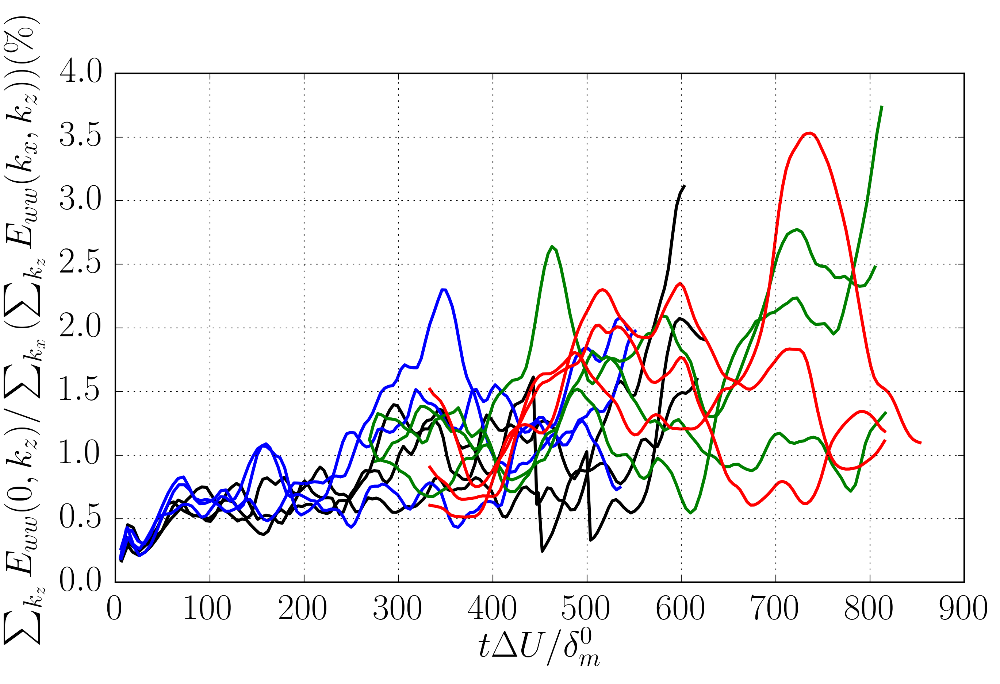

In [394]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_z}{E_{ww}(0,k_z)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectravstime(p_folders_spe[ijob],-1,2)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

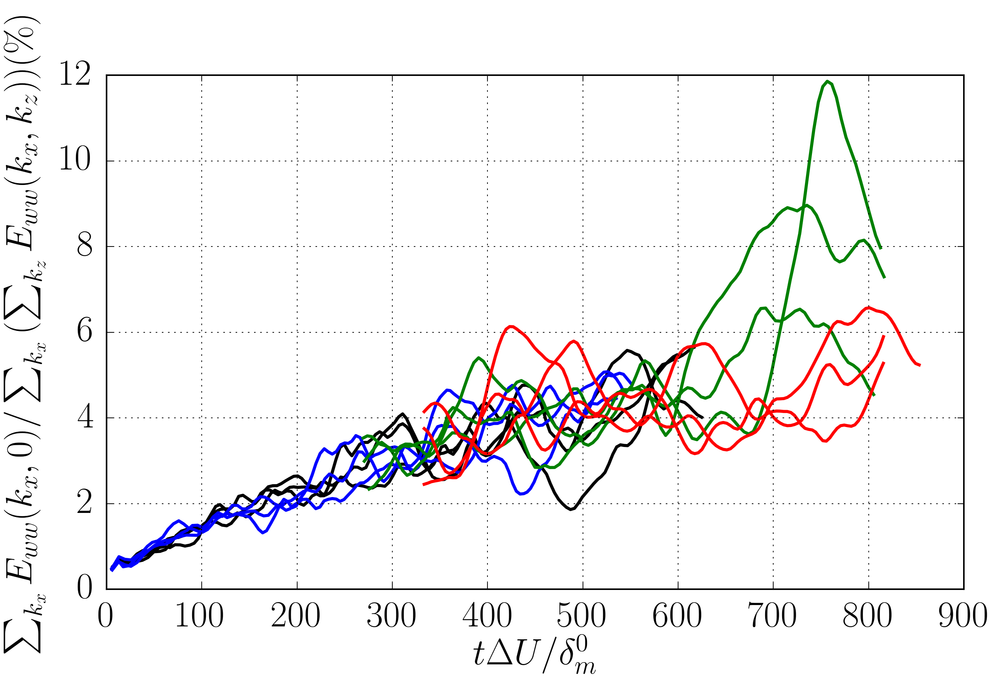

In [75]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$t \Delta U/\delta_m^0$'
ylabel =r'$\sum_{k_x}{E_{ww}(k_x,0)}/\sum_{k_x}{(\sum_{k_z}{E_{ww}(k_x,k_z)})} (\%) $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([0.0,0.010])
plt.grid('on')
for ijob in range(njobs):
    [kx,kz,time,fun1,fun2,fun3] = getSpectrazvstime(p_folders_spe[ijob],-1,2)
    #print fun1-time
    #print ycases[icase], fSS[icase]
    #plt.plot(time,np.divide(fun1,fun2),l_job_style[ijob/3],lw=2.0)
    plt.plot(time,fun1/fun2*100,l_job_style[ijob/3],lw=2.0)
    #plt.plot(time,fun2,l_job_style[ijob/3],lw=1.0)
    #plt.fill_between(ycases[icase][0], np.sqrt(fSS[icase]-errorSS[icase]), np.sqrt(fSS[icase]+errorSS[icase]),color=l_job_color[icase],alpha=0.2)
    #ax.errorbar(ycases[icase][0],fSS[icase],yerr=errorSS[icase])

# One-dimensional spectra
From Pope:

$R_{11}(\mathbf{e_1 r_1},t) = \langle u_1^2 \rangle f(r_1,t)$

$R_{22}(\mathbf{e_1 r_1},t) = \langle u_2^2 \rangle g(r_1,t)$

Where f and g are the longitudinal and transverse autocorrelation functions.

$R_{22}(\mathbf{e_1} r_1) = \int_0^\infty E_{22}(k_1) cos(k_1 r_1) dk_1$.

And:

$R_{22}(0) = \langle u_2^2 \rangle= \int_0^\infty E_{22}(k_1)  dk_1$.

In order to obtain the 1D spectra from the 2D spectra, we need to sum all $\textit{z-modes}$ for each $\textit{x-mode}$ and viceversa.

For the integral scale we need to use this:

$L_{11} = \int_0^\infty f(r_1) dr_1 = \cfrac{\pi E_{11}(0)}{2\langle u_1^2 \rangle}$.

In [395]:
def getspectra(path,variable):
    """
    Obtain the spectra for dimension 0 (x) of 1 (z)
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0

    #Spectra has already been myltiplied by dkxdkz
   
    Eiik1=np.zeros([len(kx),len(time)])
    for kkx,ii in zip(kx,range(len(kx))):
        for kkz,jj in zip(kz,range(len(kz))):
            kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik1[ii,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    Eiik3=np.zeros([len(kz),len(time)])
    for kkz,jj in zip(kz,range(len(kz))):
        for kkx,ii in zip(kx,range(len(kx))):
                #kk = (kkx**2+kkz**2)**0.5
            Eiik3[jj,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
        #Scaling    
    return kx,kz,time,Eiik1,Eiik3,mode00

419.029693604
419.429321289
457.091674805
527.315307617
496.690216064
465.923278809
646.080749512
648.490661621
649.728271484
736.98034668
759.485473633
767.03692627


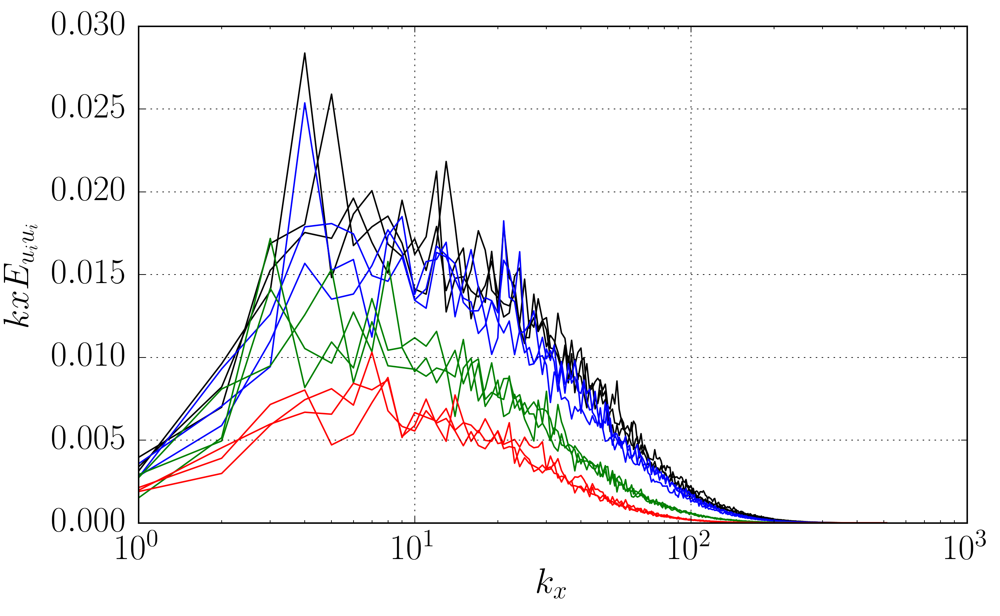

In [405]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_x$'
ylabel =r'$kxE_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kx/kx[1],kx*(Ex[:,ilim]+Ex2[:,ilim]+Ex3[:,ilim])/kx[1],l_job_style[ijob/3])
    print time[ilim]
    


419.029693604
419.429321289
457.091674805
527.315307617
496.690216064
465.923278809
646.080749512
648.490661621
649.728271484
736.98034668
759.485473633
767.03692627


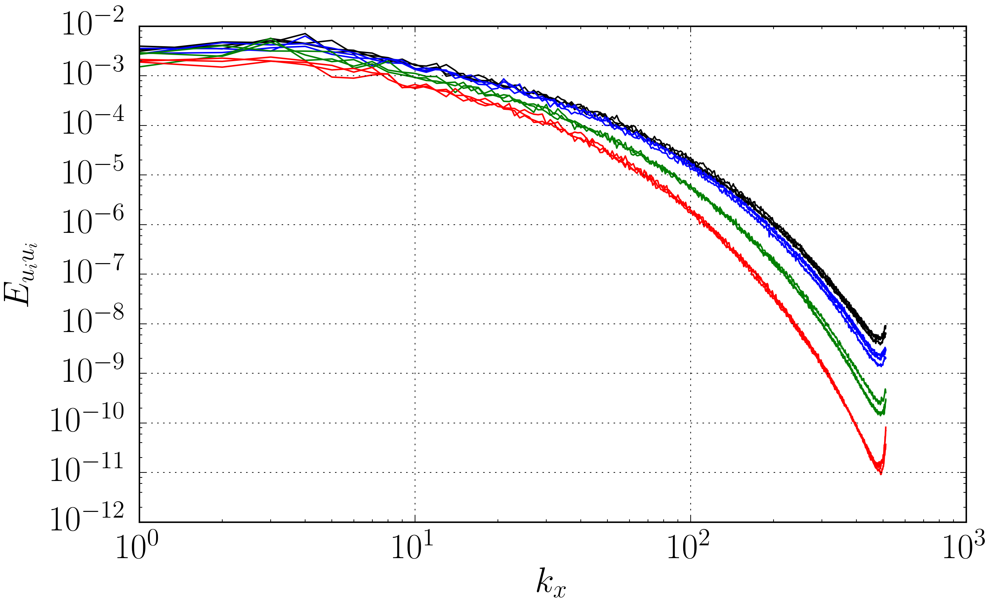

In [407]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_x$'
ylabel =r'$E_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
plt.yscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kx/kx[1],(Ex[:,ilim]+Ex2[:,ilim]+Ex3[:,ilim]),l_job_style[ijob/3])
    print time[ilim]
    


419.029693604
419.429321289
457.091674805
527.315307617
496.690216064
465.923278809
646.080749512
648.490661621
649.728271484
736.98034668
759.485473633
767.03692627


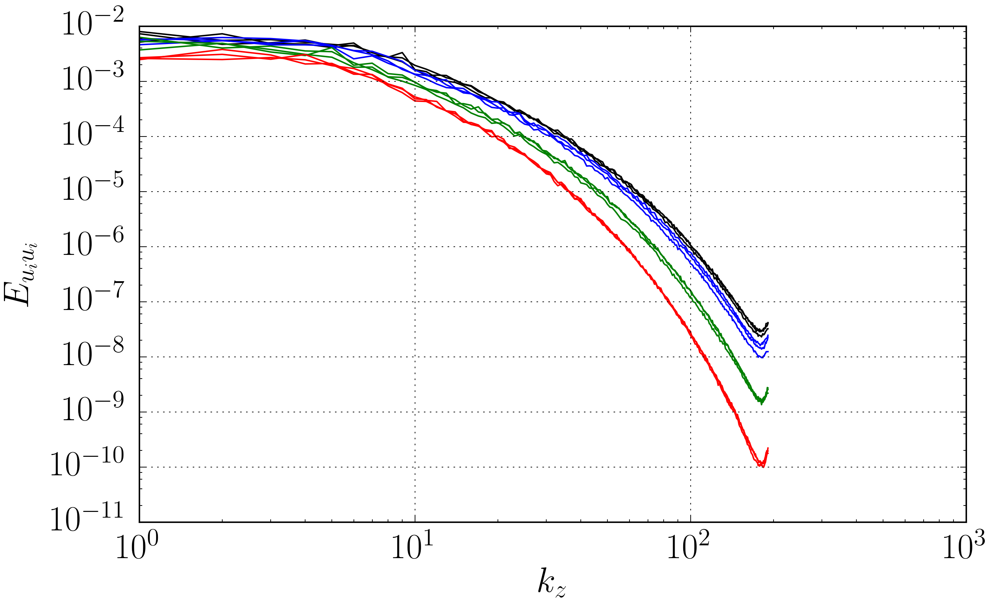

In [408]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$k_z$'
ylabel =r'$E_{u_iu_i} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
#plt.ylim([-0.5,1])
plt.grid('on')
plt.xscale('log')
plt.yscale('log')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,Ex,Ez,f00] = getspectra(p_folders_spe[ijob],0)
    [kx,kz,time,Ex2,Ez2,f002] = getspectra(p_folders_spe[ijob],1)
    [kx,kz,time,Ex3,Ez3,f003] = getspectra(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(kz/kz[1],(Ez[:,ilim]+Ez2[:,ilim]+Ez3[:,ilim]),l_job_style[ijob/3])
    print time[ilim]
    


In [313]:
def getRiivstime(path,variable,Npoints=200):
    """
    Obtain the correlation from spectra
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0
    xmax=np.pi/kx[1]
        #Define a vector x
    xvect = np.linspace(0,xmax,Npoints);
        #discretization integral factor
        #int(f(x)) = fact*sum(f(x_i))
    #Spectra has already been myltiplied by dkxdkz
    #fact=1
    #Riix = np.zeros([Npoints,len(time)],dtype=complex)
    Riix = np.zeros([Npoints,len(time)])
    Eiik1=np.zeros([len(kx),len(time)])
    
    for kkx,ii in zip(kx,range(len(kx))):
        for kkz,jj in zip(kz,range(len(kz))):
            kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik1[ii,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    for i in range(Npoints):   
        for kkx,ii in zip(kx,range(len(kx))):
            Riix[i,:] += Eiik1[ii,:]*cos(kkx*xvect[i])
        #Scaling    
    
    Riix=Riix/Riix[0,:]

    dk1=kx[-1]/(len(kx)-1)
    Lii = np.pi*(Eiik1[0,:])/(2*Riix[0,:])/dk1
    #Lii = np.pi*(Eiik1[0,:]+mode00)/(2*Riix[0,:])
    print Eiik1[0,-1],Riix[0,-1]
    #fun00 = funSPE[0,0,:]
        
    #funkx0  = np.sum(funSPE[1:,1,:],axis=0)
    #res=time*0.0
    #for kk,ii in  zip(kx[1:],range(1,len(kx))):
    #    res += np.sum(funSPE[1:,ii,:],axis=0)
    #funRest = res
    return kx,kz,time,xvect,Riix,Rii0,Lii

In [344]:
def getRiizvstime(path,variable,Npoints=100):
    """
    Obtain the correlation from spectra
    """
    with h5py.File(path,"r") as f:
        time = np.array(f['time']);
        kx = np.array(f['kx'])
        kz = np.array(f['kz'])
        mx = len(kx)-1;
        mz = len(kz)-1;
        funSPE = np.array(f['SPEC'][:,variable,:,:]);
        #The last distance being half of the box length
    #Clean the 00 mode, we want to analyze perturbations,not velocities.
    mode00 = np.zeros([len(time)])
    for tt in range(len(time)):
        mode00[tt]=funSPE[0,0,tt]
        funSPE[0,0,tt] = 0.0
    zmax=np.pi/kz[1]
        #Define a vector x
    zvect = np.linspace(0,zmax,Npoints);
        #discretization integral factor
        #int(f(x)) = fact*sum(f(x_i))
    #Spectra has already been myltiplied by dkxdkz
    #fact=1
    #Riix = np.zeros([Npoints,len(time)],dtype=complex)
    Riiz = np.zeros([Npoints,len(time)])
    Eiik3=np.zeros([len(kz),len(time)])
    
    
    for kkz,jj in zip(kz,range(len(kz))):
        for kkx,ii in zip(kx,range(len(kx))):
            #kk = (kkx**2+kkz**2)**0.5
            #Eiik1[ii,:]= Eiik1[ii,:]+1.0/(2*3.1416*kk**2)*(1.0-(kkx**2/kk**2))*funSPE[jj,ii,:]
            Eiik3[jj,:]+=funSPE[jj,ii,:]
    #Now we have Eii(k1)
    for i in range(Npoints):   
        for kkz,jj in zip(kz,range(len(kz))):
            Riiz[i,:] += Eiik3[jj,:]*cos(kkz*zvect[i])
        #Scaling    
    
    Riiz=Riiz/Riiz[0,:]

    dk3=kz[-1]/(len(kz)-1)
    Lii = np.pi*(Eiik3[0,:])/(2*Riiz[0,:])/dk3
    #Lii = np.pi*(Eiik1[0,:]+mode00)/(2*Riix[0,:])
    print Eiik3[0,-1],Riiz[0,-1]
    #fun00 = funSPE[0,0,:]
        
    #funkx0  = np.sum(funSPE[1:,1,:],axis=0)
    #res=time*0.0
    #for kk,ii in  zip(kx[1:],range(1,len(kx))):
    #    res += np.sum(funSPE[1:,ii,:],axis=0)
    #funRest = res
    return kx,kz,time,zvect,Riiz,Riiz[0,:],Lii

0.000997151189941 1.0
419.029693604
0.000611354402027 1.0
419.429321289
0.00214549709085 1.0
457.091674805
0.000853188822473 1.0
527.315307617
0.00127934118858 1.0
496.690216064
0.0010133055881 1.0
465.923278809
0.00109672424923 1.0
646.080749512
0.000808040474386 1.0
648.490661621
0.00077771344721 1.0
649.728271484
0.000482325841126 1.0
736.98034668
0.00107579701827 1.0
759.485473633
0.000471480055981 1.0
767.03692627


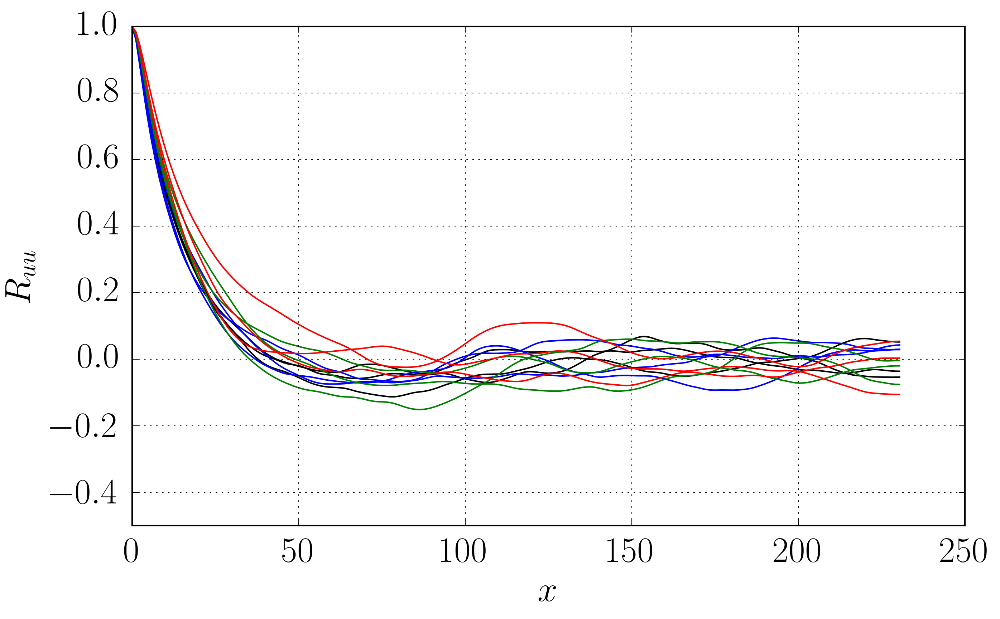

In [374]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{uu} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


0.00128564356997 1.0
419.029693604
0.00115302713623 1.0
419.429321289
0.0008670472508 1.0
457.091674805
0.000752545741059 1.0
527.315307617
0.000716498790979 1.0
496.690216064
0.000454279990351 1.0
465.923278809
0.00059928350932 1.0
646.080749512
0.000714138922705 1.0
648.490661621
0.000795922271069 1.0
649.728271484
0.000239104329018 1.0
736.98034668
0.000599886647981 1.0
759.485473633
0.000379300757378 1.0
767.03692627


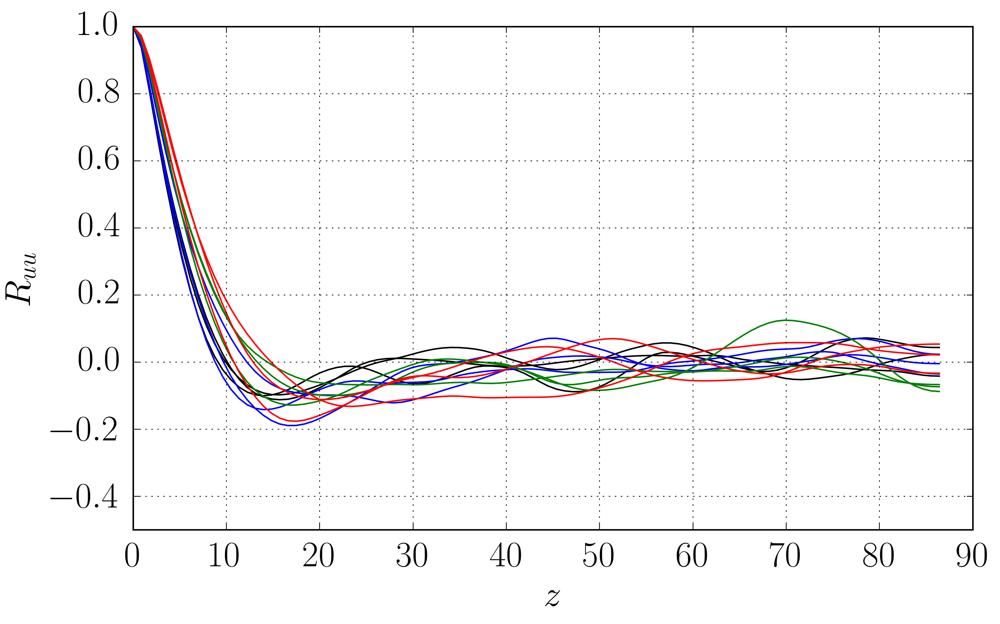

In [375]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{uu} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


0.000257224757399 1.0
419.029693604
0.000286940005302 1.0
419.429321289
0.000371105855357 1.0
457.091674805
0.000180730063251 1.0
527.315307617
0.00025246699358 1.0
496.690216064
0.00022716041981 1.0
465.923278809
0.000215791561054 1.0
646.080749512
0.000287017854292 1.0
648.490661621
0.000251442169073 1.0
649.728271484
0.000124254233799 1.0
736.98034668
0.000188493723167 1.0
759.485473633
0.000145440935456 1.0
767.03692627


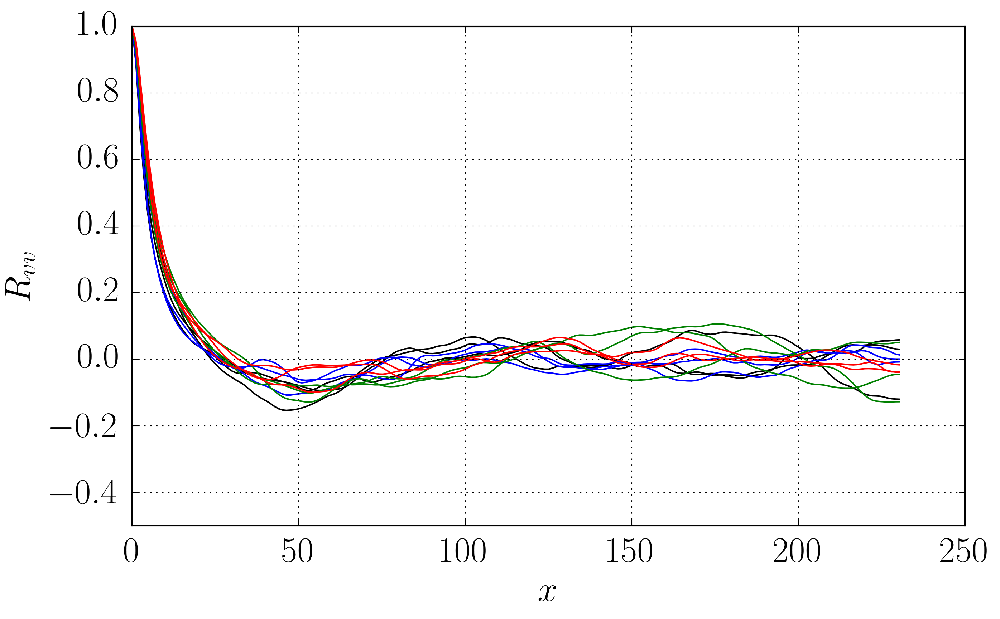

In [376]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{vv} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],1)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


0.0012000976181 1.0
419.029693604
0.00390337703612 1.0
419.429321289
0.00132373607675 1.0
457.091674805
0.00150331083093 1.0
527.315307617
0.000884258219307 1.0
496.690216064
0.000532650858474 1.0
465.923278809
0.000888289657572 1.0
646.080749512
0.000609591890827 1.0
648.490661621
0.00121690125514 1.0
649.728271484
0.000579924125434 1.0
736.98034668
0.000521254945383 1.0
759.485473633
0.0005452496742 1.0
767.03692627


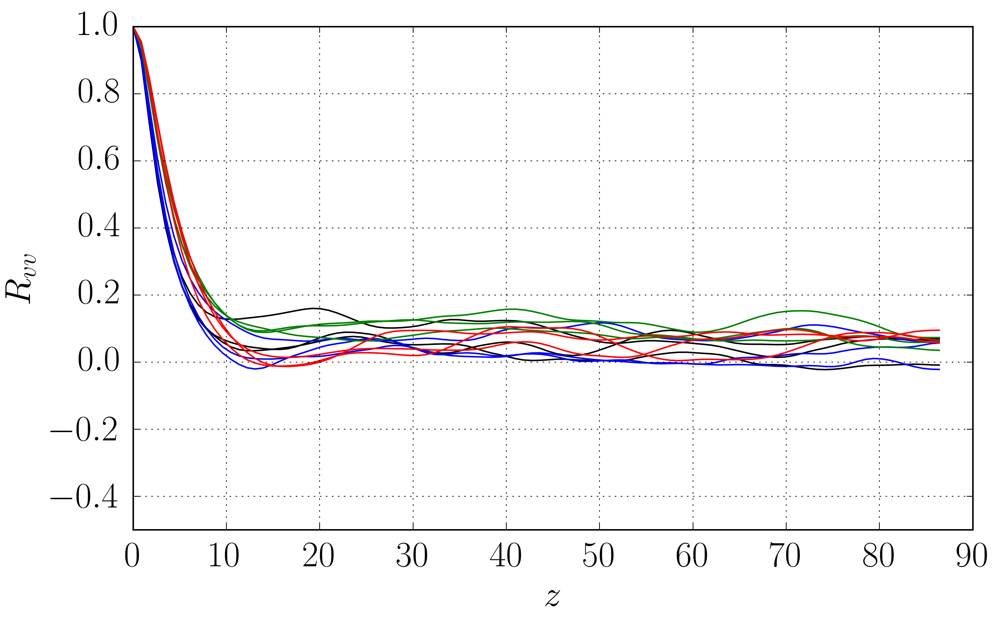

In [377]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{vv} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],1)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


0.000265148483273 1.0
419.029693604
0.00055142402305 1.0
419.429321289
0.00037673199429 1.0
457.091674805
0.000122697449486 1.0
527.315307617
0.000325498727909 1.0
496.690216064
0.000351101868515 1.0
465.923278809
0.000135061390445 1.0
646.080749512
0.000303981940105 1.0
648.490661621
0.000403034259075 1.0
649.728271484
7.67465038387e-05 1.0
736.98034668
7.89510248159e-05 1.0
759.485473633
7.16219895991e-05 1.0
767.03692627


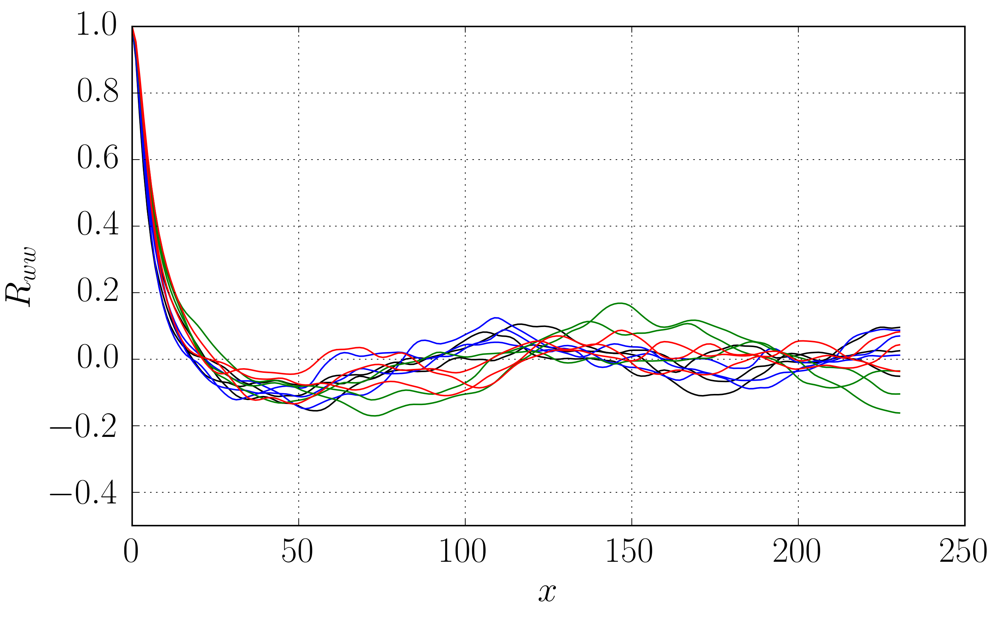

In [383]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$x$'
ylabel =r'$R_{ww} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


0.000938425127829 1.0
419.029693604
0.000971376397805 1.0
419.429321289
0.000793565485452 1.0
457.091674805
0.00073245870585 1.0
527.315307617
0.000752330351991 1.0
496.690216064
0.000852729728976 1.0
465.923278809
0.000740853786183 1.0
646.080749512
0.000557746226392 1.0
648.490661621
0.000860447300795 1.0
649.728271484
0.000364697244392 1.0
736.98034668
0.000392220584879 1.0
759.485473633
0.000341811980555 1.0
767.03692627


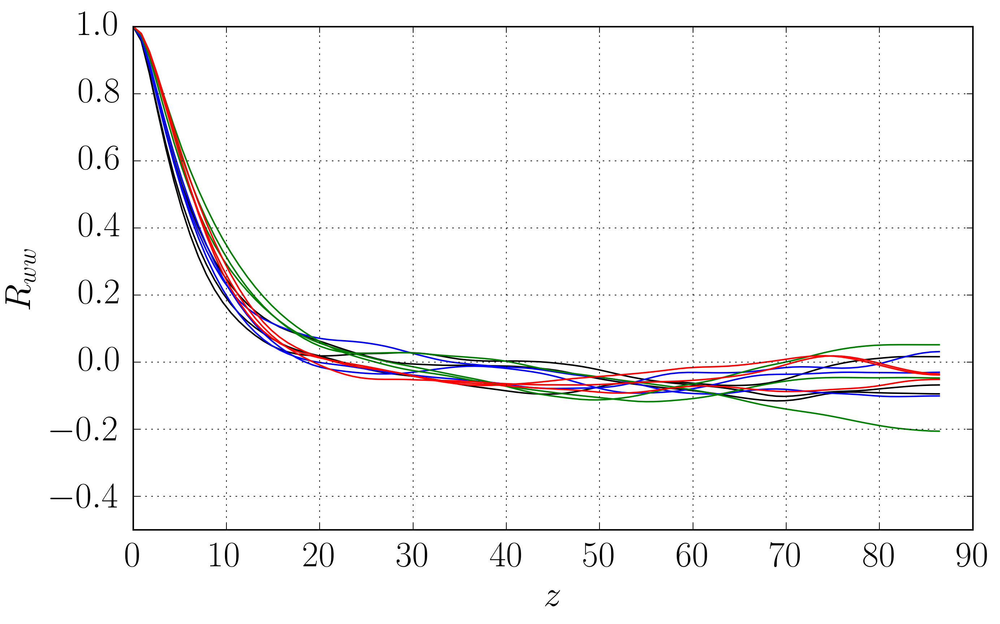

In [384]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$z$'
ylabel =r'$R_{ww} $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([-0.5,1])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],2)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(xvect,Rii[:,ilim],l_job_style[ijob/3])
    print time[ilim]
    


In [378]:
l_point_style=['k*','k*','k*','b*','b*','b*','g*','g*','g*','r*','r*','r*']

0.000997151189941 1.0
419.029693604
0.000611354402027 1.0
419.429321289
0.00214549709085 1.0
457.091674805
0.000853188822473 1.0
527.315307617
0.00127934118858 1.0
496.690216064
0.0010133055881 1.0
465.923278809
0.00109672424923 1.0
646.080749512
0.000808040474386 1.0
648.490661621
0.00077771344721 1.0
649.728271484
0.000482325841126 1.0
736.98034668
0.00107579701827 1.0
759.485473633
0.000471480055981 1.0
767.03692627


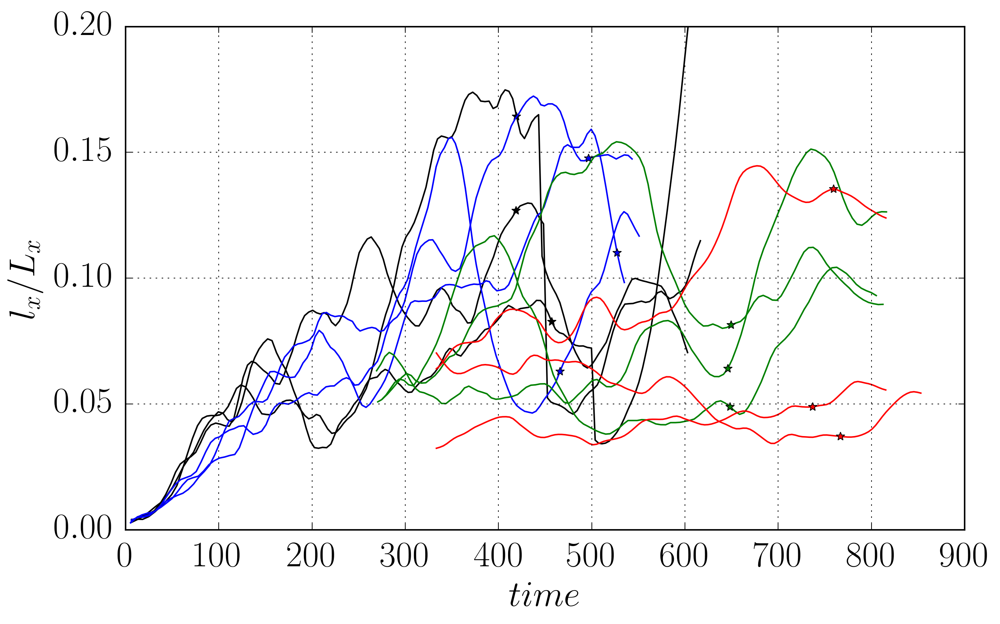

In [387]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$time$'
ylabel =r'$l_{x}/L_x $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([0,0.2])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiivstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(time,L11,l_job_style[ijob/3])
    plt.plot(time[ilim],L11[ilim],l_point_style[ijob])
    print time[ilim]
    


0.00128564356997 1.0
419.029693604
0.00115302713623 1.0
419.429321289
0.0008670472508 1.0
457.091674805
0.000752545741059 1.0
527.315307617
0.000716498790979 1.0
496.690216064
0.000454279990351 1.0
465.923278809
0.00059928350932 1.0
646.080749512
0.000714138922705 1.0
648.490661621
0.000795922271069 1.0
649.728271484
0.000239104329018 1.0
736.98034668
0.000599886647981 1.0
759.485473633
0.000379300757378 1.0
767.03692627


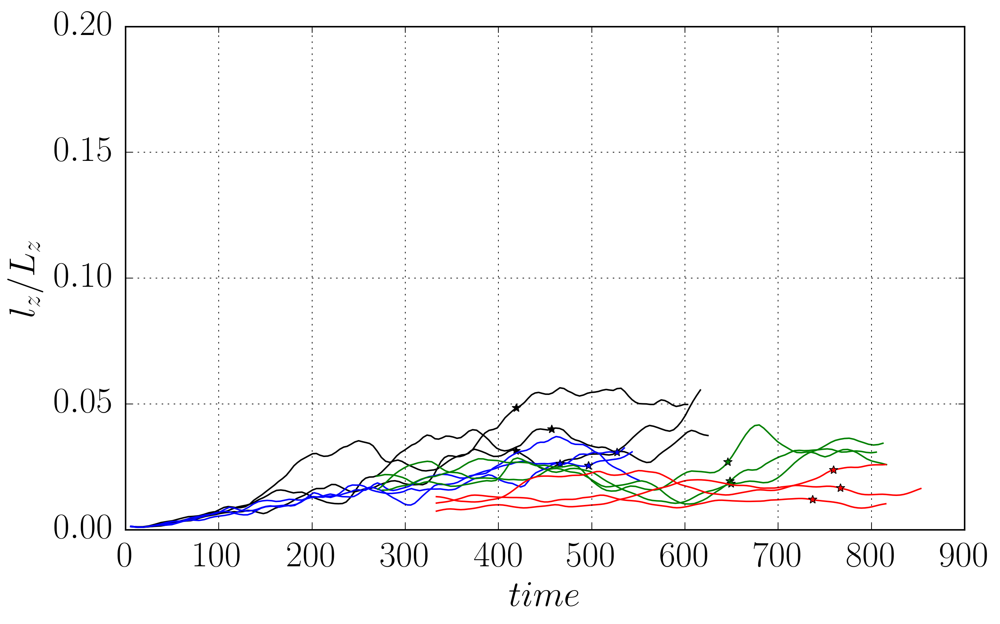

In [386]:
fig = plt.figure(figsize=(xlen,ylen)) #Define figure with size
ax=fig.add_subplot(1,1,1)

#ax.set_xscale('log')
xlabel =r'$time$'
ylabel =r'$l_{z}/L_z $'
plt.xlabel(xlabel);plt.ylabel(ylabel);
figname = 'kk'
#plt.xlim([-6,10])
plt.ylim([0,0.2])
plt.grid('on')
#dw_f = 45 dw_0
for ijob in range(0,12):
    [kx,kz,time,xvect,Rii,Rii0,L11] = getRiizvstime(p_folders_spe[ijob],0)
    ilim = where(time>SS2[ijob])[0][0]-1
    #plt.plot(xvect,Rii[:,0])
    plt.plot(time,L11,l_job_style[ijob/3])
    plt.plot(time[ilim],L11[ilim],l_point_style[ijob])
    print time[ilim]
    


 For Pantano: $lx/Lx = 0.126$ for $s=8$ at the end of the simulation
